![Nuclio logo](https://nuclio.school/wp-content/uploads/2018/12/nucleoDS-newBlack.png)

# TFM - Análisis Exploratorio de Datos (EDA)

### *Descripción del dataset y su contexto:*
El presente dataset contiene información detallada sobre propiedades en venta, incluyendo su precio, ubicación, dimensiones y diversas características adicionales. Cada registro representa un anuncio de un inmueble y cuenta con datos sobre su barrio, distrito, consumo energético y otros atributos socioeconómicos.

El objetivo de este Notebook es analizar el conjunto de datos para extraer insights que permitan comprender mejor el mercado inmobiliario en Madrid y detectar patrones que puedan ser útiles para la toma de decisiones.

### *Objetivos del EDA:*
1. Comprender la estructura del dataset: Identificar el número de registros y columnas, los tipos de datos y la presencia de valores nulos o inconsistencias.
2. Analizar la distribución de las variables: Explorar la variabilidad en precios, metros cuadrados, ubicaciones y otras características relevantes.
3. Detectar relaciones y correlaciones: Investigar posibles asociaciones entre las variables y su impacto en el precio de los inmuebles.
4. Identificar valores atípicos: Detectar posibles errores o anomalías en los datos que puedan afectar el análisis.
5. Generar insights clave: Extraer información relevante para futuros estudios o modelos de predicción del valor de los inmuebles.

Este análisis servirá como base para entender mejor la dinámica entre las variables y obtener un fichero CSV para ejecutar un modelo predictivo del precio de las vviendas en Madrid.

# *1. Librerías y configuración*

In [1]:
# Principales
import pandas as pd
import numpy as np
# Modificaciones
import re
from unidecode import unidecode
import unicodedata
import datetime
import os
import math
from scipy.stats import mode
# Visuzalizaciones
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.io as pio
from plotly.subplots import make_subplots
import plotly.graph_objs as go
from plotly.offline import iplot
import plotly.figure_factory as ff
import missingno as msno
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import RobustScaler
import gc

In [2]:
# Forzar la recolección de basura
gc.collect()

0

In [3]:
import warnings

# Ignorar todos los warnings
warnings.filterwarnings("ignore")


In [4]:
pd.set_option('display.max_info_columns', 110 )
pd.set_option("display.max_columns", None)
pd.set_option('display.max_rows', 80)
pd.set_option('display.float_format', lambda x: '%.2f' % x)
pd.set_option('display.max_colwidth', None)
# Ajustar la configuración para mostrar más filas
# pd.set_option('display.max_rows', 500)

# Inicializar la lista to replace
to_replace=['Null', 'Nan', 'nan', 'NULL', None]

# *2. Funciones*

In [5]:
# Función que agrupa las columnas por tipo de dato

def columnas_por_tipo(df):
    # Filtrar columnas por tipo de datos
    int_columns = [col for col in df.columns if df[col].dtype.name.startswith('int')]
    float_columns = [col for col in df.columns if df[col].dtype.name.startswith('float')]
    # Lista de columnas que contienen exclusivamente los valores 0, 1 y NaN
    boolean_columns=[col for col in df.columns if set(df[col].dropna().unique()) <= {0, 1}]
    
    numeric_cols = int_columns + float_columns
    num_nobool = list(set(numeric_cols)-set(boolean_columns))
    object_columns = df.select_dtypes(include='object').columns.tolist()
    category_columns = df.select_dtypes(include='category').columns.tolist()
    cols = df.columns.tolist()

    cat_columns=list(set(category_columns) - set(boolean_columns) )
    # Obtener todas las columnas
    all_columns = set(df.columns)
    # Columnas de otros tipos
    other_columns = list(all_columns - set(int_columns) - set(float_columns) - set(object_columns) - set(category_columns))
    cols_noboolean = set(cols) - set(boolean_columns)

    # Contar el número de columnas de cada tipo
    num_int_columns = len(int_columns)
    num_float_columns = len(float_columns)
    num_object_columns = len(object_columns)
    num_category_columns = len(category_columns)
    num_other_columns = len(other_columns)

    # Mostrar los resultados
    print("Número de columnas de tipo entero:", num_int_columns)
    print("Columnas de tipo entero:", int_columns)
    print("------------------------------------------------------")
    print("Número de columnas de tipo float:", num_float_columns)
    print("Columnas de tipo float:", float_columns)
    print("------------------------------------------------------")
    print("Número de columnas de tipo object:", num_object_columns)
    print("Columnas de tipo object:", object_columns)
    print("------------------------------------------------------")
    print("Número de columnas de tipo category:", num_category_columns)
    print("Columnas de tipo category:", category_columns)
    print("------------------------------------------------------")
    print("Número de columnas de otros tipos:", num_other_columns)
    print("Columnas de otros tipos:", other_columns)

    return boolean_columns, numeric_cols, cat_columns, object_columns, other_columns, num_nobool, cols_noboolean

In [6]:
def graficobarrascategoricas(df, colname):
    """Genera un gráfico de barras para una variable categórica, mostrando las 10 categorías más frecuentes y agrupando el resto como 'Otros'.

    Parameters:
    df (DataFrame): El DataFrame que contiene los datos.
    colname (str): Nombre de la variable categórica.

    Returns:
    None
    """
    # Obtener las frecuencias de las categorías
    value_counts = df[colname].value_counts()

    # Seleccionar las 10 categorías más frecuentes
    top_10 = value_counts.head(10)

    # Agrupar el resto en 'Otros'
    other_count = value_counts.tail(len(value_counts) - 10).sum()  # Sumar las frecuencias de las categorías restantes
    if other_count > 0:  # Solo agrupar si hay categorías para agrupar
        otros_series = pd.Series({'Otros': other_count})
        top_10 = pd.concat([top_10, otros_series])  # Usamos pd.concat() en lugar de append

    # Crear el gráfico de barras
    return top_10

In [7]:
def plot_histogram_boxplot(df, input_name, target_name, bins=30, num_groups=4, show_price_legend=True):
    """
    Genera un histograma y un boxplot para una variable numérica con respecto a grupos de precio.
    
    :param df: DataFrame ordenado por precio.
    :param input_name: Nombre de la columna numérica a analizar.
    :param target_name: Nombre de la columna de precio.
    :param bins: Número de bins para el histograma.
    :param num_groups: Número de grupos en los que se dividirá la variable precio.
    :param show_price_legend: Si True, muestra los rangos de los grupos de precio.
    """
    # Crear los grupos de precio
    df["price_group"] = pd.qcut(df[target_name], num_groups, labels=[f"Q{i+1}" for i in range(num_groups)], duplicates='drop')
    
    # Crear la figura con dos subgráficos
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    
    # Histograma sin leyenda de colores
    sns.histplot(df, x=input_name, bins=bins, hue="price_group", element="step", palette="coolwarm", ax=axes[0], kde=True, legend=False)
    axes[0].set_xlabel(input_name)
    axes[0].set_ylabel("Frecuencia")
    
    # Boxplot
    sns.boxplot(x="price_group", y=input_name, data=df, palette="pastel", ax=axes[1])
    axes[1].set_xlabel("Grupo del target")
    axes[1].set_ylabel(input_name)
    
    # Agregar leyenda con los valores de los grupos de precio
    if show_price_legend:
        price_ranges = df.groupby("price_group")[target_name].agg(["min", "max"])
        labels = [f"{index}: {int(row['min']):,} - {int(row['max']):,}" for index, row in price_ranges.iterrows()]
        axes[0].text(0.95, 0.95, "\n".join(labels), transform=axes[0].transAxes,
                     verticalalignment='top', horizontalalignment='right', fontsize=10, bbox=dict(facecolor='white', alpha=0.6))
    
    plt.tight_layout()
    plt.show()


In [8]:
def count_duplicate_rows(df):
    """
    Comprobar la cantidad de filas duplicadas en un DataFrame.

    Esta función toma un DataFrame como entrada y devuelve el número de filas duplicadas.
    Si el DataFrame está vacío o no tiene filas duplicadas, devuelve 0.

    Parámetros:
    df (pandas.DataFrame): El DataFrame a comprobar.

    Devuelve:
    int: El número de filas duplicadas en el DataFrame.

    Raises:
    TypeError: Si el parámetro no es un DataFrame de pandas.
    """
    if not isinstance(df, pd.DataFrame):
        raise TypeError("El parámetro debe ser un DataFrame de pandas")

    if df.empty:
        return 0

    duplicate_rows = df.duplicated().sum()
    return duplicate_rows

In [9]:

def plot_barplot_by_target(df, input_name, target_name, stacked=False):
    """
    Grafica un gráfico de barras para una variable categórica en función de una variable objetivo.

    Parameters:
    -----------
    df : pd.DataFrame
        DataFrame con los datos.
    input_name : str
        Nombre de la columna categórica a analizar.
    target_name : str
        Nombre de la columna objetivo (target).
    stacked : bool, opcional, default=False
        Si se debe apilar el gráfico de barras.
    """
    # Crear una tabla de contingencia
    crosstab = pd.crosstab(df[input_name], df[target_name])

    # Crear un gráfico de barras apiladas usando Plotly
    fig = px.bar(crosstab,
                 barmode='stack',  # Esto apila las barras
                # color=crosstab.columns,  # Colores por las columnas
                 title=f'Distribución de {input_name} por {target_name}')

    # Mostrar el gráfico
    fig.update_layout(xaxis_title=input_name,
                      yaxis_title='Frecuencia',
                      xaxis_tickangle=-45)

    fig.show()

In [10]:
def generar_barplot_media_mediana(df, cat_vars, target_var):
    """
    Genera gráficos en dos columnas: barplots con la media y mediana
    de una variable numérica (target_var) frente a varias categóricas.

    :param df: DataFrame de pandas con los datos.
    :param cat_vars: Lista de variables categóricas.
    :param target_var: Variable numérica a analizar (por ejemplo, 'precio').
    """
    filas = len(cat_vars)  # Una fila por variable categórica
    plt.figure(figsize=(15, filas * 5))  # Ajustar tamaño según número de filas

    for i, var in enumerate(cat_vars):
        # Gráfico de la media
        plt.subplot(filas, 2, 2 * i + 1)  # Columna 1: Media
        sns.barplot(x=df[var], y=df[target_var], estimator=np.mean)
        plt.xticks(rotation=90)  # Rotar etiquetas si son largas
        plt.title(f'Media de {target_var} por {var}')
        plt.xlabel(var)
        plt.ylabel(f'Media de {target_var}')

        # Gráfico de la mediana
        plt.subplot(filas, 2, 2 * i + 2)  # Columna 2: Mediana
        sns.barplot(x=df[var], y=df[target_var], estimator=np.median)
        plt.xticks(rotation=90)
        plt.title(f'Mediana de {target_var} por {var}')
        plt.xlabel(var)
        plt.ylabel(f'Mediana de {target_var}')

    plt.tight_layout()  # Ajustar el espacio entre gráficos
    plt.show()

In [11]:

def generar_barplot_media_mediana_unico(df, cat_vars, target_var):
    """
    Genera gráficos con barras compartidas (media y mediana juntas) para variables categóricas.
    
    :param df: DataFrame de pandas con los datos.
    :param cat_vars: Lista de variables categóricas.
    :param target_var: Variable numérica a analizar (por ejemplo, 'precio').
    """
    filas = len(cat_vars)  # Una fila por variable categórica
    plt.figure(figsize=(12, filas * 5))  # Ajustar tamaño según número de filas

    for i, var in enumerate(cat_vars):
        # Calcular media y mediana
        stats = df.groupby(var)[target_var].agg(['mean', 'median']).reset_index()

        # Crear el gráfico
        plt.subplot(filas, 1, i + 1)
        bar_width = 0.4  # Ancho de las barras

        # Posiciones para las barras
        x = np.arange(len(stats[var]))
        
        # Añadir barras de media y mediana
        plt.bar(x - bar_width / 2, stats['mean'], width=bar_width, label='Media', color='blue', alpha=0.7)
        plt.bar(x + bar_width / 2, stats['median'], width=bar_width, label='Mediana', color='orange', alpha=0.7)

        # Personalización
        plt.xticks(x, stats[var], rotation=45, ha='right')
        plt.title(f'Media y Mediana de {target_var} por {var}')
        plt.xlabel(var)
        plt.ylabel(target_var)
        plt.legend()
        plt.tight_layout()

    plt.show()


In [12]:
def categorize_ano_construccion(value):
    # Si el valor es NaN, lo dejamos como NaN
    if pd.isna(value):
        return np.nan
    try:
        # Convertimos el valor a float si es numérico
        value = float(value)

        # Asignamos el valor a las franjas de años correspondientes
        if value < 1973:
            return 'Más de 50 años'
        elif 1973 <= value <= 1993:
            return 'Entre 30 y 50 años'
        elif 1993 < value <= 2013:
            return 'Entre 10 y 30 años'
        elif 2013 < value <= 2018:
            return 'Entre 5 y 10 años'
        elif value > 2018:
            return 'Menos de 5 años'
        else:
            return np.nan  # En caso de que no cumpla con ninguna condición
    except:
        # Si el valor no es un número, lo dejamos como está
        value=str(value).strip()

        return value

In [13]:
def agrupar_antiguedad(valor):
    if valor in ['Menos de 5 años', 'Menos de 5 Anos','Menos de 5 Años']:
        return 'Menos_5_anos'
    elif valor in ['Menos de 10 años','Entre 5 y 10 años']:
        return 'Entre_5_10_anos'
    elif valor in ['Entre 10 y  15 Años', 'Entre 10 y 15 Años', 'Entre 5 y 10 años', 'Entre 15 y 20 Años', 'Entre 10 y 30 años', 'Entre 10 y 20 años', 'Entre 20 y 30 años', 'Entre 15 y 20 Anos','Entre 10 y 15 Anos', 'Entre 15 y 20 años', 'Entre 20 y 25 Anos','Entre 10 y  15 Anos']:
        return 'Entre_10_30_anos'
    elif valor in ['Entre 25 y 35 años','Entre 35 y 50 Años','Mas de 25 Años','Entre 20 y 25 Años','Entre 30 y 50 años', 'Entre 35 y 50 Anos']:
        return 'Entre_30_50_anos'
    elif valor in ['Más de 50 años', 'Mas de 50 anos', 'Mas de 25 Anos']:
        return 'Mas_50_anos'
    else:
        return valor

In [14]:
def imputar_por_ratio(df, col_connulos, col_ratio, col1, col2):
    """
    Calcula el ratio de baños por m² para cada combinación de barrio y tipología,
    y lo usa para imputar valores nulos en la columna de baños.

    Parámetros:
        df (pd.DataFrame): El DataFrame con los datos.
        col_connulos (str): Columna que contiene los valores de baños.
        col_ratio (str): Columna que contiene los metros cuadrados.
        col1 (str): Columna del barrio.
        col2 (str): Columna de la tipología.

    Retorna:
        pd.DataFrame: El DataFrame con los valores imputados.
    """
    # Calcular el ratio de baños por m² por cada combinación de barrio y tipología
    ratios = df.groupby([col1, col2]).apply(
        lambda group: group[col_connulos].sum() / group[col_ratio].sum() if group[col_ratio].sum() > 0 else 0
    ).reset_index(name='ratio')

    # Función para imputar valores nulos de baños
    def imputar_banos(row):
        if pd.isnull(row[col_connulos]):
            # Buscar el ratio correspondiente al barrio y tipología
            ratio = ratios.loc[
                (ratios[col1] == row[col1]) & 
                (ratios[col2] == row[col2]), 
                'ratio'
            ]
            # Aplicar el ratio al tamaño en m²
            if not ratio.empty:
                return round(row[col_ratio] * ratio.values[0])
        return row[col_connulos]

    # Aplicar la función de imputación al DataFrame
    df[col_connulos] = df.apply(imputar_banos, axis=1)

    return df


In [15]:
def mediana_col(df, col_connulos, colcomparar1):
    """
    Rellena los valores nulos de col_connulos con la media calculada
    para las filas que coincidan en colcomparar1 y colcomparar2.

    :param df: DataFrame con los datos.
    :param col_connulos: Columna con valores nulos a imputar.
    :param colcomparar1: Primera columna de comparación para el filtro.
   
    :return: DataFrame con los valores imputados.
    """
    # Iterar sobre las filas donde col_connulos es nulo
    for idx, row in df[df[col_connulos].isna()].iterrows():
        # Filtrar el DataFrame usando colcomparar1 y colcomparar2
        filtro = (df[colcomparar1] == row[colcomparar1]) 

        # Calcular la media de col_connulos en ese subconjunto
        mediana = df.loc[filtro, col_connulos].median()

        # Imputar la media si no es NaN
        if not np.isnan(mediana):
            df.at[idx, col_connulos] = round(mediana)

    return df

In [16]:
def extract_num(col):
    try:
        # Si el valor es un número flotante o entero, convertirlo a float (por ejemplo, 1.0 o 2)
        if isinstance(col, (int, float)):
            return float(col)

        # Si el valor es una cadena y contiene un número, extraemos el primer número
        return float(col.split()[0])
    except:
        return np.nan

In [17]:
def reduce_mem_usage(df, turn_cat=False, silence=True):
    """Itera sobre todo el dataset convirtiendo cada columna en el tipo más adecuado para ahorrar memoria.

    Parameters
    ----------
    df : pd.DataFrame
        Dataframe que se quiere reducir.
    turn_cat : bool, optional
        Transformación de las columnas objeto o string a category, by default False.

    Returns
    -------
    pd.DataFrame
        Dataframe optimizado.
    """

    start_mem = df.memory_usage().sum() / 1024**2  # Memoria inicial

    for col in df.columns:
        col_type = df[col].dtype

        if col_type != object and not isinstance(col_type, pd.CategoricalDtype):
            c_min = df[col].min()
            c_max = df[col].max()

            if pd.api.types.is_numeric_dtype(df[col]):
                if str(col_type)[:3] == 'int':
                    if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                        df[col] = df[col].astype(np.int8)
                    elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                        df[col] = df[col].astype(np.int16)
                    elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                        df[col] = df[col].astype(np.int32)
                    elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                        df[col] = df[col].astype(np.int64)
                else:
                    if c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                        df[col] = df[col].astype(np.float32)
                    else:
                        df[col] = df[col].astype(np.float64)

                # Conversión de float a int si no hay decimales y no hay NaN
                df[col] = df[col].fillna(0)  # Rellenar NaN antes de verificar si son enteros
                # Check if the column is of type float before applying is_integer
                if df[col].dtype.kind == 'f':
                    if all(df[col].apply(float.is_integer)):
                        df[col] = df[col].astype(np.int64)

        # Conversión de objetos a categoría si turn_cat es True
        if turn_cat and col_type == object:
            df[col] = df[col].astype('category')

    end_mem = df.memory_usage().sum() / 1024**2  # Memoria final

    if not silence:
        print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
        print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    return df

In [18]:
# Función para identificar si es público o privado
def extract_texto(col, texto1, texto2):
    if isinstance(col, str):  # Solo aplicar 'lower()' si el valor es una cadena
        if texto1 in col.lower():
            return texto1
        elif texto2 in col.lower():
            return texto2
    return np.nan

In [19]:
def asignar_columna(row, diccionario, col_asignar, col_agrupar, colfiltrado, valfiltrado):
    if pd.isnull(row[col_asignar]) and row[colfiltrado] == valfiltrado and pd.notnull(row[col_agrupar]):
        return diccionario.get(row[col_agrupar], 0) + 1
    return row[col_asignar]

In [20]:
def diccionario_mediana(df, colnulos, colagrup1, colagrup2):
    """
    Creates a dictionary where keys are tuples of (colagrup1, colagrup2)
    and values are the median of colnulos for that group.

    :param df: DataFrame with the data.
    :param colnulos: Column with null values to impute.
    :param colagrup1: First column for grouping.
    :param colagrup2: Second column for grouping.
    :return: Dictionary with median values for each group.
    """
    # Filter out rows where colagrup1 or colnulos are null
    filtered_df = df[df[colagrup1].notnull() & df[colnulos].notnull()]

    # Group by colagrup1 and colagrup2, calculate median of colnulos
    mediana = filtered_df.groupby([colagrup1, colagrup2])[colnulos].median().round()
   # mediana=mediana.astype('Int64')
     # Change to 'Int64' only if all values are integers, otherwise keep as float
    if mediana.apply(lambda x: x.is_integer()).all():
        mediana = mediana.astype('Int64')

    # Convert the groupby result to a dictionary for easier lookup
    mediana_dict = mediana.to_dict()

    return mediana_dict

In [21]:
def completar_nulo_con_moda(df, columnas, val):
    """
    val=2 impto la moda
    val=3 imputo la media
    val=1 imputo 1
    val=0 imputo 0
    Aplica la moda para completar valores nulos en columnas específicas y crea una columna asociada
    que indica si los valores fueron imputados.

    Parámetros:
        df (pd.DataFrame): El DataFrame original.
        columnas (list): Lista de columnas a procesar.
        val (int): Método de imputación (2 para moda, 3 para media, 1 o 0 para valores fijos).
    
    Retorna:
        int: Número total de filas que se han cambiado (valores nulos reemplazados).
    """
    filas_cambiadas = 0  # Contador de filas con valores nulos imputados

    for col in columnas:
        # Calcular el valor de imputación
        if val == 2:
            valor = df[col].mode()[0]
        elif val == 3:
            valor = round(df[col].mean())  # Redondear la media
        else:
            valor = val

        # Crear una nueva columna indicadora de imputación
        indicador_col = f"{col}_es_imputado"
        df[indicador_col] = df[col].isnull().astype(int)  # 1 si era nulo, 0 si no

        # Contar valores nulos antes de reemplazar
        filas_cambiadas += df[col].isnull().sum()

        # Reemplazar valores nulos con el valor calculado
        df[col] = df[col].fillna(valor)

    return filas_cambiadas


In [22]:
def completar_nulo_con_estadistico(df_filtrado, columnas, val):
    #si funciona eliminar ompletar_nulo_con_moda
    """
    val=2 impto la moda
    val=3 imputo la media
    val=4 imputo la mediana
    val=1 imputo 1
    val=0 imputo 0
    Aplica la moda para completar valores nulos en columnas específicas y crea una columna asociada
    que indica si los valores fueron imputados.

    Parámetros:
        df (pd.DataFrame): El DataFrame original.(suele ser df filtrado por barrio)
        columnas (list): Lista de columnas a procesar.
        val (int): Método de imputación (2 para moda, 3 para media, 1 o 0 para valores fijos).
    
    Retorna:
        int: Número total de filas que se han cambiado (valores nulos reemplazados).
    """
    filas_cambiadas = 0  # Contador de filas con valores nulos imputados

    for col in columnas:
        # Calcular el valor de imputación
        if val == 2:
            valor = df_filtrado[col].mode()[0]
        elif val == 3:
            valor = round(df_filtrado[col].mean())  # Redondear la media
        elif val == 3:
            valor = round(df_filtrado[col].median())  # Redondear la media
        else:
            valor = val

        # Crear una nueva columna indicadora de imputación
        indicador_col = f"{col}_es_imputado"
        df_filtrado[indicador_col] = df_filtrado[col].isnull().astype(int)  # 1 si era nulo, 0 si no

        # Contar valores nulos antes de reemplazar
        filas_cambiadas += df_filtrado[col].isnull().sum()

        # Reemplazar valores nulos con el valor calculado
        df_filtrado[col] = df_filtrado[col].fillna(valor)

    return filas_cambiadas


In [23]:
def rellenar_banos(df, col_banos, col_cod, col_tipo, mediana_barrio, mediana_distrito, tipo):
    """
    Rellena los valores nulos en la columna 'banos' en base a las medianas
    asociadas a barrios o distritos según el tipo de propiedad.

    Parámetros:
        df (pd.DataFrame): El DataFrame a procesar.
        col_banos (str): Nombre de la columna de baños.
        col_cod (str): Columna que puede ser 'cod_barrio' o 'cod_distrito' dependiendo del caso.
        col_tipo (str): Columna que contiene la tipología de la propiedad.
        mediana_barrio (dict): Diccionario con las medianas de baños por barrio.
        mediana_distrito (dict): Diccionario con las medianas de baños por distrito.
        tipo (str): Tipo de propiedad para filtrar (e.g., 'Atico', 'Chalet').

    Retorna:
        pd.DataFrame: El DataFrame modificado.
    """
    # Imputar por medianas de barrio
    df[col_banos] = df.apply(
        lambda row: asignar_columna(row, mediana_barrio, col_banos, 'cod_barrio', col_tipo, tipo) 
        if pd.isnull(row[col_banos]) and row[col_tipo] == tipo else row[col_banos], 
        axis=1
    )

    # Imputar por medianas de distrito
    df[col_banos] = df.apply(
        lambda row: asignar_columna(row, mediana_distrito, col_banos, 'cod_distrito', col_tipo, tipo) 
        if pd.isnull(row[col_banos]) and row[col_tipo] == tipo else row[col_banos], 
        axis=1
    )

    return df


In [24]:
def categorizar_cocina(texto):
    if pd.isnull(texto):
        return 'Desconocido'  # Manejar valores nulos
    texto = texto.lower()  # Convertir a minúsculas para evitar problemas de coincidencia
    if 'no amueblada' in texto:
        return 'No amueblada'
    elif 'independiente' in texto:
        return 'Independiente'
    elif 'abierta' in texto:
        return 'Abierta'
    elif 'con isla' in texto:
        return 'Isla'
    elif 'amueblada' in texto:
        return 'Amueblada'
    elif 'equipada' in texto:
        return 'Equipada'
    elif 'reformada' in texto:
        return 'Reformada'
    elif 'sin reforma' in texto:
        return 'Sin reforma'
    else:
        return 'Desconocido'  # Categoría por defecto


In [25]:
def clasificar_vivienda(row):
    if row['exterior'] == 1:
        return 2  # Valor para exterior
    elif row['interior'] == 1:
        return 0  # Valor para interior
    else:
        return 1  # Valor para el resto

In [26]:


def calcular_estadistico_por_col(df,  col_agr, columnas, metodo):
    """
    # Calcula un estadístico (media, moda, mediana, etc.) por col para las columnas especificadas.

    # Args:
    #     df: df de Pandas con los datos.
    #      col_agr: Columna por la cual agrupar.
    #     columnas: Lista de columnas para calcular el estadístico.
    #     metodo: Método para calcular el estadístico ('mean', 'median', 'mode').

    # Returns:
    #     Diccionario con los resultados del estadístico por col para cada columna.
    # """
   
def calcular_estadistico_por_col(df, col_agr, columnas, metodo):
    estadistico_por_col = {}

    for columna in columnas:
        if metodo == 'median':
            estadistico_por_col[columna] = df.groupby(col_agr)[columna].median().to_dict()
        elif metodo == 'mean':
            estadistico_por_col[columna] = df.groupby( col_agr)[columna].mean().to_dict()
        elif metodo == 'mode':
            estadistico_por_col[columna] = (
                df.groupby(col_agr)[columna]
                .apply(lambda x: x.dropna().mode().iloc[0] if not x.dropna().mode().empty else np.nan)
                .to_dict()
            )

    return estadistico_por_col



def imputar_valores(df, estadistico_por_col,  col_agr):
    """
    Imputa valores nulos en un df usando los valores calculados por col.

    Args:
        df: df en el cual imputar valores.
        estadistico_por_col: Diccionario con los valores por col (output de calcular_estadistico_por_col).
        col_agr: Columna por la cual agrupar para imputar valores.

    Returns:
        df con los valores imputados.
    """
    df_imputado = df.copy()
    for columna, estadisticos in estadistico_por_col.items():
        for grupo, valor in estadisticos.items():
            # Reemplazar valores nulos con el estadístico correspondiente por grupo
            df_imputado.loc[
                (df_imputado[col_agr] == grupo) & (df_imputado[columna].isnull()),
                columna
            ] = valor
    return df_imputado


In [27]:
def calcular_est_por_cols(df, cols_agr, columnas, metodo):
    """
    Calcula un estadístico (media, moda, mediana, etc.) por una o varias columnas para las columnas especificadas.
    
    Args:
        df: DataFrame de Pandas con los datos.
        col_agr: Columna o lista de columnas por las cuales agrupar.
        columnas: Lista de columnas para calcular el estadístico.
        metodo: Método para calcular el estadístico ('mean', 'median', 'mode').

    Returns:
        Diccionario con los resultados del estadístico por col para cada columna.
    """
    estadistico_por_col = {}
    
    for columna in columnas:
        if metodo == 'median':
            estadistico_por_col[columna] = df.groupby(list(cols_agr))[columna].median().to_dict()
        elif metodo == 'mean':
            estadistico_por_col[columna] = df.groupby(list(cols_agr))[columna].mean().to_dict()
        elif metodo == 'mode':
            estadistico_por_col[columna] = (
                df.groupby(list(cols_agr))[columna]
                .apply(lambda x: x.dropna().mode().iloc[0] if not x.dropna().mode().empty else np.nan)
                .to_dict()
            )
    
    return estadistico_por_col

def imputar_cols_valores(df, estadistico_por_col, cols_agr):
    """
    Imputa valores nulos en un DataFrame usando los valores calculados por col.

    Args:
        df: DataFrame en el cual imputar valores.
        estadistico_por_col: Diccionario con los valores por col (output de calcular_estadistico_por_col).
        col_agr: Columna o lista de columnas por las cuales agrupar para imputar valores.

    Returns:
        DataFrame con los valores imputados.
    """
    df_imputado = df.copy()
    
    for columna, estadisticos in estadistico_por_col.items():
        for grupo, valor in estadisticos.items():
            # Si `col_agr` es una lista, hay que comparar todas las columnas con `grupo`
            if isinstance(cols_agr, list):
                condicion = (df_imputado[cols_agr] == pd.Series(grupo, index=cols_agr)).all(axis=1)
            else:
                condicion = df_imputado[cols_agr] == grupo

            df_imputado.loc[condicion & df_imputado[columna].isnull(), columna] = valor

    return df_imputado



In [28]:
def categorizar_suelo(texto):
    # Manejar valores nulos
    if pd.isnull(texto):
        return 'Desconocido'
    
    # Normalizar texto
    texto = texto.lower()
    
    # Palabras clave para cada categoría
    madera_keywords = ['parquet', 'tarima', 'madera', 'pino melis', 'parket']
    gres_keywords = ['gres', 'porcelanato', 'porcelanico']
    piedra_keywords = ['mármol', 'mosaico']
    baldosa_keywords = ['terrazo', 'baldosa']
    otros_keywords = ['sintasol', 'moqueta', 'otros']
    
    # Clasificar según palabras clave
    if any(keyword in texto for keyword in madera_keywords):
        return 'Madera'
    elif any(keyword in texto for keyword in gres_keywords):
        return 'Gres'
    elif any(keyword in texto for keyword in piedra_keywords):
        return 'Piedra'
    elif 'radiante' in texto:
        return 'Radiante'
    elif any(keyword in texto for keyword in baldosa_keywords):
        return 'Baldosa'
    elif any(keyword in texto for keyword in otros_keywords):
        return 'Otros'
    else:
        return 'Desconocido'


In [29]:
def clasificar_barrios_por_m2(df, num_grupos=5):
    # Calcular el precio promedio por barrio
    codbarrio_precios = df.groupby('cod_barrio')['m2_constr'].mean().reset_index()

    # Clasificar los códigos de barrio en los grupos (calculando los cortes a partir de X_train)
    codbarrio_precios['cod_barrio_m2_contr'], bins = pd.qcut(
        codbarrio_precios['m2_constr'], q=num_grupos, labels=[1, 2, 3, 4, 5], retbins=True
    )

    # Crear un diccionario de mapeo para asignar grupos a cada barrio en el DataFrame original
    cod_barrio_mapping = dict(zip(codbarrio_precios['cod_barrio'], codbarrio_precios['cod_barrio_m2_contr']))
    df['cod_barrio_m2_contr'] = df['cod_barrio'].map(cod_barrio_mapping)

    # Contar viviendas por grupo
    cod_barrio_m2_contr_counts = df["cod_barrio_m2_contr"].value_counts(dropna=False).sort_index()

    # Mostrar la descripción de cada grupo con su rango de m2_constr
    print("\nClasificación de barrios según m2_constr:")
    for i, (group, count) in enumerate(cod_barrio_m2_contr_counts.items()):
        lower_bound = bins[i]  # Límite inferior del grupo
        upper_bound = bins[i + 1]  # Límite superior del grupo
        print(f"Grupo {group}: {count} viviendas, rango de m2_constr: {lower_bound:.2f} - {upper_bound:.2f}")

    return df, bins  # Retornamos el dataframe y los límites de los cortes

# Aplicar la misma clasificación en X_val y X_test usando los mismos límites de corte
def aplicar_clasificacion(df, bins):
    # Asignar a cada barrio el grupo que le corresponde usando los mismos límites de `bins` de X_train
    cod_barrio_mapping = dict(zip(df['cod_barrio'], pd.cut(df['m2_constr'], bins=bins, labels=[1, 2, 3, 4, 5])))
    df['cod_barrio_m2_contr'] = df['cod_barrio'].map(cod_barrio_mapping)
    return df


In [30]:
def imputar_col_con_mediana(df, cols, mediana_dict=None):
    """
    Imputa los valores nulos de las columnas especificadas con la mediana de cada columna en el DataFrame.
    Si se pasa un diccionario con medianas previamente calculadas, se usa esa mediana.

    Args:
        df (pd.DataFrame): DataFrame de pandas.
        cols (list): Lista de nombres de las columnas donde imputar los valores nulos.
        mediana_dict (dict, opcional): Diccionario con las medianas por columna. Si no se pasa, se calcula la mediana.
    
    Returns:
        pd.DataFrame: DataFrame con los valores nulos de las columnas imputados.
        dict: Diccionario con las medianas calculadas, si no se pasó previamente.
    """
    # Si no se pasa el diccionario, lo creamos
    if mediana_dict is None:
        mediana_dict = {}

    for col in cols:
        # Calculamos la mediana si no está en el diccionario
        if col not in mediana_dict:
            mediana_dict[col] = df[col].median()  # Calcula la mediana de la columna especificada

        # Imputa los nulos con la mediana guardada en el diccionario
        df[col].fillna(mediana_dict[col], inplace=True)  # Imputa los nulos con la mediana

    return df, mediana_dict


In [31]:


def encode_column(df, column_name):
    # Inicializar el codificador OneHotEncoder
    encoder = OneHotEncoder(sparse_output=False)
    
    # Codificar la columna seleccionada
    encoded_array = encoder.fit_transform(df[[column_name]])
    
    # Convertir el array codificado a un DataFrame
    encoded_df = pd.DataFrame(encoded_array, columns=encoder.get_feature_names_out([column_name]))
    
    # Eliminar la columna original y añadir las columnas codificadas
    df_encoded = pd.concat([df.drop(column_name, axis=1).reset_index(drop=True), encoded_df], axis=1)
    
    return df_encoded
 # Función para codificar una lista de columnas
 
def encode_columns(df, column_list):
    # Iterar sobre cada columna de la lista
    for column in column_list:
        df = encode_column(df, column)  # Llamar a la función encode_column
    return df

In [32]:

# Función mejorada para manejar las columnas correctamente
def create_col_suma(df, new_column_name, cols):
    df[new_column_name] = 0  # Inicializamos la nueva columna con 0
    for col in cols:
        # Verificamos si el valor es '' o NaN y asignamos 0 en ese caso, de lo contrario sumamos el valor
        df[new_column_name] += df[col].apply(lambda x: 0 if (x == '' or pd.isnull(x)) else x)
    return df


# *3. Carga de datos*

In [33]:
dfEDA= pd.read_csv('./data/pisosEDA.csv',sep=";",index_col=False,low_memory=False)
# dfEDA= pd.read_csv('./pisosEDA.csv',sep=";",index_col=False,low_memory=False)

In [34]:

# Cargar datos adicionales desde una ruta relativa
dfadicionales = pd.read_csv('../01-preprocesamiento-de-datos/02-datos-limpios/Datos_adicionales.csv', sep=';', index_col=False)


# *4. Exploración de datos*

In [35]:
print(f"El DataFrame dfEDA tiene {dfEDA.shape[0]} filas y {dfEDA.shape[1]} columnas.")

El DataFrame dfEDA tiene 10032 filas y 64 columnas.


In [36]:
dfEDA.head(2)

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,num_plantas,jardin,inmueble_ingresos,alquiler_opcion_a_compra,nuda_propiedad,tipo_inmueble,tiene_armario,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,acceso_discapacidad,precio,web,armarios,codigo_Postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,tipo_fachada,agua_caliente,portero,orientacion_este,orientacion_oeste,orientacion_sur,clasificacion_aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion
0,https://www.indomio.es/anuncios/75404850/,100.00,Salamanca,4,Recoletos,41,F,Atico,Para Reformar,Sólo cocina amueblada,1,1.00,1.00,1.00,1.00,1.0,1.00,1.00,NaN,NaN,NaN,NaN,NaN,NaN,lujo,NaN,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,1,0.00,1.00,1.00,2000000,Indomio.com,NaN,28001.00,NaN,NaN,1.00,1.00,100,NaN,NaN,0.50,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,F,Central,No clasificado en energía,Radiadores
1,https://www.indomio.es/anuncios/79178265/,83.00,Barajas,21,Casco Histórico De Barajas,213,NaN,Piso,Bueno / Habitable,Sí,Entreplanta,2.00,2.00,0.00,1.00,1.0,0.00,1.00,2009,2.00,NaN,1.00,NaN,NaN,medio,NaN,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,sin piscina,0.00,0.00,1.00,287000,Indomio.com,NaN,28042.00,NaN,NaN,0.00,1.00,123,NaN,NaN,NaN,0.00,0.00,0.00,Sin Aire,abierta,0.00,NaN,Individual,Electrica,Radiadores


In [37]:
dfEDA.columns

Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'garaje', 'trastero', 'ascensor',
       'antiguedad', 'num_plantas', 'jardin', 'inmueble_ingresos',
       'alquiler_opcion_a_compra', 'nuda_propiedad', 'tipo_inmueble',
       'tiene_armario', 'cancha_tenis',
       'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior',
       'piscina', 'porton_electrico', 'videoportero', 'acceso_discapacidad',
       'precio', 'web', 'armarios', 'codigo_Postal', 'm2_utiles', 'tipo_suelo',
       'certificado_ener

In [38]:
dfEDA.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
url,10032,10032,https://www.indomio.es/anuncios/75404850/,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
m2_constr,10032.00,NaN,NaN,NaN,138.55,152.07,10.00,68.00,98.00,150.00,4574.00
distrito,10032,21,Centro,1781,NaN,NaN,NaN,NaN,NaN,NaN,NaN
cod_distrito,10032.00,NaN,NaN,NaN,7.78,5.76,1.00,4.00,6.00,12.00,21.00
barrio,10032,131,Goya,442,NaN,NaN,NaN,NaN,NaN,NaN,NaN
cod_barrio,10032.00,NaN,NaN,NaN,81.47,57.64,11.00,41.00,65.00,124.00,215.00
letra_ce,2150,7,E,898,NaN,NaN,NaN,NaN,NaN,NaN,NaN
tipologia,10032,12,Piso,8521,NaN,NaN,NaN,NaN,NaN,NaN,NaN
estado,5525,17,En Buen Estado,1698,NaN,NaN,NaN,NaN,NaN,NaN,NaN
amueblado,1221,6,1.0,728,NaN,NaN,NaN,NaN,NaN,NaN,NaN


En esta primera tabla, ya vemos variables con desviación tipica 0, (tiene_armario,inmuebles_ingresos,alquiler_con_opcion_compra) por lo que podremos eliminar esas columnas que no aportan información al estudio.

In [39]:
# Compramos que la columna url tiene valores únicos
dfEDA['url'].nunique() == len(dfEDA)

True

In [40]:
# Tratar las columnas para quitar espacios si tuvieran y poner el nombre de las columnas en minúsculas
# para tener desde el primer momento siempre el mismo nombre de columnas.
dfEDA.columns = [col.strip().lower() for col in dfEDA.columns]

In [41]:
dfEDA.columns.tolist()

['url',
 'm2_constr',
 'distrito',
 'cod_distrito',
 'barrio',
 'cod_barrio',
 'letra_ce',
 'tipologia',
 'estado',
 'amueblado',
 'planta',
 'dormitorios',
 'banos',
 'balcon',
 'terraza',
 'garaje',
 'trastero',
 'ascensor',
 'antiguedad',
 'num_plantas',
 'jardin',
 'inmueble_ingresos',
 'alquiler_opcion_a_compra',
 'nuda_propiedad',
 'tipo_inmueble',
 'tiene_armario',
 'cancha_tenis',
 'carpinteria_exterior_doble_vidrio/pvc',
 'carpinteria_exterior_doble_vidrio/madera',
 'carpinteria_exterior_doble_vidrio/metal',
 'carpinteria_exterior_triple_vidrio/madera',
 'carpinteria_exterior_triple_vidrio/metal',
 'carpinteria_exterior_vidrio/pvc',
 'carpinteria_exterior_vidrio/madera',
 'carpinteria_exterior_vidrio/metal',
 'chimenea',
 'exterior',
 'interior',
 'piscina',
 'porton_electrico',
 'videoportero',
 'acceso_discapacidad',
 'precio',
 'web',
 'armarios',
 'codigo_postal',
 'm2_utiles',
 'tipo_suelo',
 'certificado_energetico',
 'puerta_seguridad',
 'gastos_comunidad',
 'tipo_facha

In [42]:
print(f"El DataFrame dfEDA tiene {dfadicionales.shape[0]} filas y {dfadicionales.shape[1]} columnas.")

El DataFrame dfEDA tiene 152 filas y 49 columnas.


In [43]:
dfadicionales.columns

Index(['cod_municipio', 'municipio', 'cod_distrito', 'distrito', 'cod_barrio',
       'barrio', 'codigo_Postal', 'm2_areasverdes', 'num_personas',
       'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones',
       'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'lineas_metro',
       'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias',
       'estacion_bus_urbano', 'num_lineas_buses',
       'Renta neta media por persona', 'Renta neta media por hogar',
       'Mediana de la renta por unidad de consumo',
       'Renta bruta media por persona', 'Renta bruta media por hogar',
       'Habitantes', 'Hogares', 'tamano_medio_del_hogar',
       'Tamaño del hogar (Nº de personas en la vivienda)', 'hog_con_1',
       'hog_con_2', 'hog_con_3', 'hog_con_4', 'hog_con_5', 'hog_con_6',
       'hog_con_7', 'hog_con_8', 'hog_con_9', 'hog_con_10', 'hog_con_11',
       'hog_con_12', 'hog_con_13', 'hog_con_14', 'hog_con_15 y más',
       'Comercio_ServiciosMinorista

In [44]:
#dfadicionales.columns = [col.strip().lower() for col in dfadicionales.columns]

In [45]:
dfadicionales.columns

Index(['cod_municipio', 'municipio', 'cod_distrito', 'distrito', 'cod_barrio',
       'barrio', 'codigo_Postal', 'm2_areasverdes', 'num_personas',
       'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones',
       'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'lineas_metro',
       'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias',
       'estacion_bus_urbano', 'num_lineas_buses',
       'Renta neta media por persona', 'Renta neta media por hogar',
       'Mediana de la renta por unidad de consumo',
       'Renta bruta media por persona', 'Renta bruta media por hogar',
       'Habitantes', 'Hogares', 'tamano_medio_del_hogar',
       'Tamaño del hogar (Nº de personas en la vivienda)', 'hog_con_1',
       'hog_con_2', 'hog_con_3', 'hog_con_4', 'hog_con_5', 'hog_con_6',
       'hog_con_7', 'hog_con_8', 'hog_con_9', 'hog_con_10', 'hog_con_11',
       'hog_con_12', 'hog_con_13', 'hog_con_14', 'hog_con_15 y más',
       'Comercio_ServiciosMinorista

## *4.1 Tipo de datos*

In [46]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 3
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'precio']
------------------------------------------------------
Número de columnas de tipo float: 37
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'num_plantas', 'inmueble_ingresos', 'alquiler_opcion_a_compra', 'nuda_propiedad', 'tiene_armario', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'acceso_discapacidad', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'portero', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'o

### *4.1.1 Transformación del tipo de variables*

Vamos a cambiar el tipo de dato de las siguientes columnas

In [47]:
cols = ["barrio", "distrito", "letra_ce","letra_emisiones",
        "tipologia", "estado", "tipo_inmueble", "tipo_suelo", "tipo_fachada", "agua_caliente",
        "grupo_cocina", "letra_emisiones", "tipo_calefaccion", "energia_calefaccion",
        "instalacion_calefaccion", "antiguedad","clasificacion_aire"]
for c in cols:
    # Convertir columna a categórica
    dfEDA[c] = dfEDA[c].astype('category')
    

In [48]:
#Trasformamos a númericas

cols=['tamano_medio_del_hogar', 'm2_areasverdes']
for c in cols:
    # Reemplazar comas por puntos y forzar conversiones
    dfadicionales[c] = dfadicionales[c].str.replace(',', '.').astype(float)
    

## *4.2 Identificacion de valores nulos*

Los valores nulos pueden afectar los análisis estadísticos y las visualizaciones. 

Antes de tomar decisiones sobre cómo gestionar los valores nulos, tenemos que evaluar cuántos datos faltan y en qué proporción dentro del conjunto de datos. 

Tenemos que entender por que faltan los datos

En este conjunto de datos, tomados mediante la tecnica de scraping, tendremos valores nulos fundamentalmente por tres motivos y siempre de manera aleatoria
    *El proceso de scraping no ha tomado todos los valores de cada vivienda publicada en la web
    *La web no informaba del dato por que no lo consideró necesario p.e carpinterias
    *La web no informaba del dato por que la vivienda tenia ausencia de ello p.e piscina
 
 Los datos faltantes pueden ser:
    *Aleatorios, sin depender de otras variables.
    *Relacionados con otras variables observadas.
    *Los datos faltan debido a factores relacionados con los valores en sí mismos, lo que puede introducir sesgos.

Podriamos reduccir el tamaño de la muestra (filas y/o columnas), lo que podría afectar la representatividad de los resultados.

Al tratar los valores nulos tenemos que evitar introducir sesgos que puedan alterar la interpretación de los datos. Si, por ejemplo, los datos faltantes están asociados con patrones específicos, tratarlos incorrectamente podría distorsionar los resultados.

Para tratarlos, revisaremos:
- La cantidad de valores nulos por columna.
- El porcentaje de valores nulos en relación con el total de datos.
- Identificación y eliminación de columnas con más del 90% de valores nulos
- Visualización de los valores nulos para identificar patrones.


In [49]:
# Verificar valores nulos por columna
valores_nulos = dfEDA.isnull().sum()

print("Valores nulos por columna:")
print(valores_nulos[valores_nulos > 0])

Valores nulos por columna:
letra_ce                                      7882
estado                                        4507
amueblado                                     8811
planta                                        4551
dormitorios                                    224
banos                                          422
balcon                                        8616
terraza                                       7575
garaje                                        8063
trastero                                      7383
ascensor                                      5458
antiguedad                                    6631
num_plantas                                   9816
jardin                                        7998
inmueble_ingresos                            10022
alquiler_opcion_a_compra                     10029
nuda_propiedad                               10020
tipo_inmueble                                 8139
tiene_armario                                 8148
canc

In [50]:
# Ver porcentaje de valores nulos
porcentaje_nulos = (dfEDA.isnull().sum() / len(dfEDA)) * 100

print("\nPorcentaje de valores nulos por columna:")
print(porcentaje_nulos[porcentaje_nulos > 0])


Porcentaje de valores nulos por columna:
letra_ce                                    78.57
estado                                      44.93
amueblado                                   87.83
planta                                      45.36
dormitorios                                  2.23
banos                                        4.21
balcon                                      85.89
terraza                                     75.51
garaje                                      80.37
trastero                                    73.59
ascensor                                    54.41
antiguedad                                  66.10
num_plantas                                 97.85
jardin                                      79.72
inmueble_ingresos                           99.90
alquiler_opcion_a_compra                    99.97
nuda_propiedad                              99.88
tipo_inmueble                               81.13
tiene_armario                               81.22
cancha_t

Representación grafica de los valores nulos

In [51]:
# Convertir valores nulos en 1 y valores no nulos en 0
df_nulos = dfEDA.isnull().astype(int)

# Graficar con imshow y ajustar el tamaño de la figura
fig = px.imshow(df_nulos, 
                labels={'x': 'Columnas', 'y': 'Índices', 'color': 'Nulo'},
                color_continuous_scale='blues', 
                title="Mapa de Valores Nulos",
                height=600)  #

fig.show()


*El análisis de valores nulos nos permite detectar qué columnas requieren tratamiento antes de continuar con el análisis exploratorio. Realizaremos la imputación de esos nulos en variables importantes como dormitorios y baño y evaluar la eliminación de aquellas con un alto porcentaje de valores faltantes si no aportan información significativa al estudio.*

Observaciones:
- Se identifican múltiples columnas con una gran cantidad de valores nulos p.e. "alquiler-opcion_a_compra" ó "acceso_discapacidad" (representadas en azul oscuro).
- Algunas columnas tienen valores ausentes de manera dispersa, como puede ser "letra_ce", mientras que otras presentan grandes bloques de datos faltantes ("videoportero").
- Hay varias variables con una cantidad significativa de valores faltantes, especialmente aquellas relacionadas con características del inmueble, carpintería, eficiencia energética,etc
- La variable target `precio` asi como las variables de ubicación `distrito` y `barrio` no tienen valores nulos.

Vamos a eliminare columnas con mas del 95% de valores nulos ya que aportan muy poca información y manterlas aumenta la complejidad sin ofrecer beneficios.

In [52]:
# Identificamos las columnas con más del 95% de valores nulos para eliminarlas
for col in dfEDA.columns:
    porcentaje_nulos = dfEDA[col].isnull().mean() * 100
    if porcentaje_nulos > 95:
        print(f'Columna {col}: {porcentaje_nulos:.2f}% nulos')

Columna num_plantas: 97.85% nulos
Columna inmueble_ingresos: 99.90% nulos
Columna alquiler_opcion_a_compra: 99.97% nulos
Columna nuda_propiedad: 99.88% nulos
Columna acceso_discapacidad: 97.53% nulos
Columna tipo_fachada: 98.20% nulos
Columna portero: 97.70% nulos


In [53]:
#viviendas con columnas inmueble_ingresos,alquiler_opcion_a_compra y nuda_propiedads con valor 1 
dfEDA.query("inmueble_ingresos==1 | alquiler_opcion_a_compra==1 | nuda_propiedad==1").count()

url                                          23
m2_constr                                    23
distrito                                     23
cod_distrito                                 23
barrio                                       23
cod_barrio                                   23
letra_ce                                      8
tipologia                                    23
estado                                       11
amueblado                                    11
planta                                       12
dormitorios                                  22
banos                                        23
balcon                                        6
terraza                                       6
garaje                                       13
trastero                                     11
ascensor                                     10
antiguedad                                   11
num_plantas                                  12
jardin                                  

Las siguientes columnas presentan un alto porcentaje de valores nulos:

- **`inmueble_ingresos`**: 99.91% de los valores son nulos.
- **`alquiler_opcion_a_compra`**: 99.97% de los valores son nulos.
- **`nuda_propiedad`**: 99.87% de los valores son nulos.

Estas columnas se refieren a viviendas con características específicas de transacción:
- **`alquiler_opcion_a_compra`**:viviendas en alquiler con opción a compra según contrato.
- **`inmueble_ingresos`**: Representa viviendas alquiladas que generan ingresos.
- **`nuda_propiedad`**: Corresponde a viviendas donde no se tiene la posesión plena (por ejemplo, derechos limitados sobre la propiedad).


Debido al bajo tamaño de muestra para estas categorías, he decidido eliminar este tipo de viviendas del análisis. El modelo se construirá exclusivamente para viviendas de venta libre de cargas, lo que permitirá obtener resultados más representativos y útiles.

In [54]:
# Get the index of the rows to be removed
eliminar_filas = dfEDA.query("inmueble_ingresos==1 | alquiler_opcion_a_compra==1 | nuda_propiedad==1").index

# Keep only the rows that are NOT in the index_to_remove
dfEDA = dfEDA[~dfEDA.index.isin(eliminar_filas)]

Elimino las columnas con más de 95% de valores nulos

In [55]:
# Identificar y eliminar columnas con más del 95% de valores nulos
columnas_a_eliminar = [col for col in dfEDA.columns if dfEDA[col].isnull().mean() * 100 > 95]
print(f"Columnas eliminadas: {columnas_a_eliminar}")

# Eliminar las columnas del DataFrame
dfEDA = dfEDA.drop(columns=columnas_a_eliminar)
print("El DataFrame actualizado tiene estas columnas:")
print(dfEDA.columns)

Columnas eliminadas: ['num_plantas', 'inmueble_ingresos', 'alquiler_opcion_a_compra', 'nuda_propiedad', 'acceso_discapacidad', 'tipo_fachada', 'portero']
El DataFrame actualizado tiene estas columnas:
Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'garaje', 'trastero', 'ascensor',
       'antiguedad', 'jardin', 'tipo_inmueble', 'tiene_armario',
       'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
     

## *4.3 Identificación variables con desvación tipica 0*

In [56]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 3
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'precio']
------------------------------------------------------
Número de columnas de tipo float: 31
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'tiene_armario', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte']
------------------------------------------------------
Número de columnas de tipo object: 8
Colum

In [57]:
# Calcular la desviación estándar de cada columna
dfEDAn=dfEDA[cols_num]
desviaciones = dfEDAn.std()

# Identificar columnas con desviación estándar igual a 0 o cercana 
umbral = 0.01 
columnas_a_eliminar = desviaciones[desviaciones <= umbral].index

# Mostrar las columnas identificadas
print("Columnas con desviación estándar igual a 0 o cercana:")
print(columnas_a_eliminar)



Columnas con desviación estándar igual a 0 o cercana:
Index(['tiene_armario'], dtype='object')


In [58]:
# Eliminamos  las columna tiene_armario del DataFrame ya que es una columna practicamente constante que no aportará nada al moelo
dfEDA = dfEDA.drop(columns='tiene_armario')

print("Columnas eliminadas. El DataFrame actualizado tiene estas columnas:")
print(dfEDA.columns)


Columnas eliminadas. El DataFrame actualizado tiene estas columnas:
Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'garaje', 'trastero', 'ascensor',
       'antiguedad', 'jardin', 'tipo_inmueble', 'cancha_tenis',
       'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
       'armarios', 'codigo_postal', 'm2_utiles', 'tipo_suelo',
       'certificado_energetico', 'puerta_seguridad', 'gastos_comunidad',
       'agua_calien

## *4.4 Identificación de datos duplicados*

Identificamos si existen registros duplicados ya que pueden distorsionar el análisis y deben ser detectados para eliminarlos.

In [59]:
duplicados = dfEDA.duplicated().sum()

print(f"\nNúmero de registros duplicados: {duplicados}")


Número de registros duplicados: 0


In [60]:
# Mostrar ejemplos de registros duplicados (si existen)
if duplicados > 0:
    print("\nEjemplo de registros duplicados:")
    display(dfEDA[dfEDA.duplicated()].head())

In [61]:
dfEDA.shape

(10009, 56)

* Analizaremos si es posible que tengamos el mismo piso en venta en distintas webs, para ello identificamos como prymary key la combinación de esas columnas 

['cod_barrio', 'cod_distrito','codigo_postal','m2_constr', 'dormitorios', 'banos', 'precio','estado','planta']

In [62]:
# Definir las columnas que deben coincidir para ser consideradas duplicadas
columnas_unicas = ['cod_barrio', 'cod_distrito','codigo_postal','m2_constr', 'dormitorios', 'banos', 'precio','estado','planta']

# Crear una columna con la concatenación de los valores de estas columnas
dfEDA['concat_values'] = dfEDA[columnas_unicas ].astype(str).agg('-'.join, axis=1)

# Contar cuántas veces aparece cada combinación de valores en 'concat_values'
conteo = dfEDA['concat_values'].value_counts()

# Filtrar solo las combinaciones que aparecen más de una vez
valores_duplicados = conteo[conteo > 1].index

# Filtrar el DataFrame original para obtener solo las filas con esos valores duplicados
df_duplicados = dfEDA[dfEDA['concat_values'].isin(valores_duplicados)].copy()

# Contar cuántos valores únicos hay en 'web' para cada 'concat_values'
web_count = df_duplicados.groupby('concat_values')['web'].nunique()

# Filtrar solo las combinaciones donde 'web' tiene más de un valor único (diferentes sitios web)
duplicados_dif_web = web_count[web_count > 1].index

# Filtrar el DataFrame original para obtener las filas finales
df_duplicados=df_duplicados[df_duplicados['concat_values'].isin(duplicados_dif_web)]


# Mostrar el resultado ordenado por la cantidad de repeticiones
df_duplicados = df_duplicados.sort_values(by='concat_values', ascending=False)


In [63]:
dfEDA.shape,df_duplicados.shape

((10009, 57), (253, 57))

In [64]:
df_duplicados.head()

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,clasificacion_aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion,concat_values
7441,https://www.pisos.com/comprar/piso-chamberi_vallehermoso28003-45049733830_100500/,180.00,Chamberí,7,Vallehermoso,76,NaN,Piso,NaN,NaN,1,4.00,3.00,1.00,1.00,1.0,NaN,1.00,Más de 50 años,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1075000,pisos.com,1.00,28003.00,NaN,Parquet,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,Central,No clasificado en energía,Radiadores,76-7-28003.0-180.0-4.0-3.0-1075000-nan-1
1404,https://www.indomio.es/anuncios/96500375/,180.00,Chamberí,7,Vallehermoso,76,E,Piso,NaN,NaN,1,4.00,3.00,1.00,1.00,NaN,0.00,1.00,1960,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,1075000,Indomio.com,NaN,28003.00,NaN,NaN,1.00,0.00,270,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,E,No clasif,No clasificado en energía,Radiadores,76-7-28003.0-180.0-4.0-3.0-1075000-nan-1
3868,https://www.pisos.com/comprar/piso-chamberi_vallehermoso28003-45872679450_104700/,115.00,Chamberí,7,Vallehermoso,76,NaN,Piso,A Reformar,NaN,NaN,3.00,2.00,NaN,NaN,1.0,NaN,1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,630000,pisos.com,1.00,28003.00,102.00,Parquet,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,1.00,NaN,Central,No clasificado en energía,Radiadores,76-7-28003.0-115.0-3.0-2.0-630000-A Reformar-nan
7885,https://www.redpiso.es/inmueble/piso-en-venta-en-avenida-reina-victoria-vallehermoso-chamberi-madrid-madrid-RP1812024127515,115.00,Chamberí,7,Vallehermoso,76,NaN,Piso,A Reformar,NaN,NaN,3.00,2.00,NaN,NaN,1.0,NaN,1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.00,NaN,NaN,NaN,NaN,630000,redpiso,1.00,28003.00,102.00,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,1.00,NaN,No clasif,No clasificado en energía,Radiadores,76-7-28003.0-115.0-3.0-2.0-630000-A Reformar-nan
4197,https://www.pisos.com/comprar/piso-rios_rosas28003-45908753621_104700/,47.00,Chamberí,7,Ríos Rosas,75,NaN,Piso,A Reformar,NaN,NaN,2.00,1.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,269900,pisos.com,NaN,28003.00,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores,75-7-28003.0-47.0-2.0-1.0-269900-A Reformar-nan


In [65]:
dfEDA.precio.describe()

count      10009.00
mean      890192.68
std      1160044.10
min        54000.00
25%       239900.00
50%       480000.00
75%      1090000.00
max     19950000.00
Name: precio, dtype: float64

In [66]:
dfEDA.shape

(10009, 57)

In [67]:
print(f"Porcentaje de valores nulos en la columna 'precio': {(dfEDA['precio'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'precio': 0.00%


In [68]:
# Mostrar el número de filas duplicadas iniciales
print(f"Filas duplicadas inicialmente: {df_duplicados.shape[0]}")

# Lista para almacenar las URLs de las filas eliminadas
urls_eliminadas = []

# Paso 2: Iterar sobre las combinaciones duplicadas de 'concat_values'
for concat_value, group in df_duplicados.groupby('concat_values'):
    if len(group) == 2:
        # Obtener las filas duplicadas
        primera_fila = group.iloc[0].copy()  # Asegurarnos de que es una copia independiente
        segunda_fila = group.iloc[1]

        # Verificar si las columnas son iguales entre ambas filas
        if list(primera_fila.index) == list(segunda_fila.index):
            # Rellenar los valores nulos de 'primera_fila' con los valores de 'segunda_fila'
            for col in primera_fila.index:
                if col not in columnas_unicas:  # No tocar las columnas clave
                    if pd.isnull(primera_fila[col]):  
                        primera_fila[col] = segunda_fila[col]
        else:
            print("Las columnas no coinciden entre las dos filas")

        # Guardar la URL de la fila eliminada
        urls_eliminadas.append(segunda_fila['url'])

        # Buscar la fila en dfEDA con la misma 'url' y actualizar solo esas columnas
        dfEDA.loc[dfEDA['url'] == primera_fila['url'], primera_fila.index] = primera_fila.values

        # Eliminar la segunda fila en dfEDA
        dfEDA = dfEDA[dfEDA['url'] != segunda_fila['url']]

        # Eliminar la segunda fila también de df_duplicados
        df_duplicados = df_duplicados[df_duplicados['url'] != segunda_fila['url']]

# Mostrar el número de filas después de la eliminación
print(f"Filas después de eliminar duplicados: {dfEDA.shape[0]}")
print(f"Filas duplicadas restantes: {df_duplicados.shape[0]}")

# Verificar si quedaron filas con todos sus valores nulos
filas_nulas = dfEDA[dfEDA.isnull().all(axis=1)]
print(f"Filas completamente nulas después de la operación: {filas_nulas.shape[0]}")

# Mostrar las URLs de las filas eliminadas
print("URLs de las filas eliminadas:")
print(urls_eliminadas)


Filas duplicadas inicialmente: 253
Filas después de eliminar duplicados: 9913
Filas duplicadas restantes: 157
Filas completamente nulas después de la operación: 0
URLs de las filas eliminadas:
['https://www.indomio.es/anuncios/96758185/', 'https://www.pisos.com/comprar/piso-centro_palacio28013-46690088281_102100/', 'https://www.indomio.es/anuncios/95617945/', 'https://www.indomio.es/anuncios/94450029/', 'https://www.indomio.es/anuncios/96752509/', 'https://www.pisos.com/comprar/piso-centro_palacio28013-40901699776_100500/', 'https://www.pisos.com/comprar/piso-centro_palacio28013-45034884189_108900/', 'https://www.pisos.com/comprar/piso-opanel28019-45840053914_104700/', 'https://www.pisos.com/comprar/casa-carabanchel_vista_alegre28025-40084962496_520821/', 'https://www.pisos.com/comprar/piso-centro_embajadores_lavapies28012-45051892481_102100/', 'https://www.pisos.com/comprar/piso-centro_embajadores_lavapies28012-43381840404_100500/', 'https://www.pisos.com/comprar/piso-centro_embajador

In [69]:
print(f"Porcentaje de valores nulos en la columna 'precio': {(dfEDA['precio'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'precio': 0.00%


In [70]:
dfEDA.shape,df_duplicados.shape

((9913, 57), (157, 57))

In [71]:
dfEDA.precio.describe()

count       9913.00
mean      889565.49
std      1163289.63
min        54000.00
25%       239000.00
50%       479000.00
75%      1090000.00
max     19950000.00
Name: precio, dtype: float64

#ahora los duplicados que tengo son de mas de dos registros
#comparemos las webs por que duplicados de la misma web no son duplicados

In [72]:
df_duplicados["estado"].value_counts(dropna=False)

estado
NaN                        150
A Reformar                   7
Óptimo / Reformado           0
reformado                    0
perfecto estado              0
buen estado                  0
Reformado                    0
Perfecto Estado              0
Para Reformar                0
A Estrenar                   0
Obra Nueva                   0
Nuevo / En Construcción      0
En Buen Estado               0
Depende Del Precio           0
Bueno / Habitable            0
Buen estado                  0
Buen Estado                  0
Obra nueva                   0
Name: count, dtype: int64

En Obra nueva es facil tener duplicados por que puede haber varias viviendas con las misas caracterisicas de localización ,m2, precio, etc. En segunda mano suponemos que se ha publicado la misma vivienda en diferentes webs.

In [73]:
# Mostrar el número de filas duplicadas iniciales
print(f"Filas duplicadas inicialmente: {df_duplicados.shape[0]}")

# Lista para almacenar las URLs de las filas eliminadas
urls_eliminadas = []

# Paso 2: Iterar sobre las combinaciones duplicadas de 'concat_values'
for concat_value, group in df_duplicados.groupby('concat_values'):
    if len(group) > 2:
        # Ordenar por URL para asegurar consistencia en la selección
        group = group.sort_values(by='url').reset_index(drop=True)
        
        # Obtener las filas duplicadas
        filas = [group.iloc[n] for n in range(len(group))]
        
        # Empezamos con la primera fila (que mantendremos)
        primera_fila = filas[0].copy()

        # Iterar sobre las demás filas (excepto la primera)
        for i in range(1, len(filas)):
            segunda_fila = filas[i]

            # Rellenar solo los valores nulos en primera_fila con los de segunda_fila
            for col in primera_fila.index:
                if pd.isnull(primera_fila[col]) and not pd.isnull(segunda_fila[col]):
                    primera_fila[col] = segunda_fila[col]

            # Añadir la URL de la fila eliminada a la lista
            urls_eliminadas.append(segunda_fila['url'])

        # Actualizar la fila en dfEDA solo si existe
        if primera_fila['url'] in dfEDA['url'].values:
            dfEDA.loc[dfEDA['url'] == primera_fila['url'], primera_fila.index] = primera_fila.values

        # Eliminar todas las filas excepto la primera en dfEDA
        dfEDA = dfEDA[~dfEDA['url'].isin(urls_eliminadas)]

        # Eliminar todas las filas del grupo en df_duplicados
        df_duplicados = df_duplicados[~df_duplicados['url'].isin(urls_eliminadas)]

# Mostrar el número de filas después de la eliminación
print(f"Filas después de eliminar duplicados: {dfEDA.shape[0]}")
print(f"Filas duplicadas restantes: {df_duplicados.shape[0]}")

# Verificar si quedaron filas con valores NaN en precio
nulos_precio = dfEDA['precio'].isnull().sum()
print(f"Filas con precio nulo después de la operación: {nulos_precio}")

# Mostrar las URLs de las filas eliminadas
print("URLs de las filas eliminadas:")
print(urls_eliminadas)


Filas duplicadas inicialmente: 157
Filas después de eliminar duplicados: 9871
Filas duplicadas restantes: 115
Filas con precio nulo después de la operación: 0
URLs de las filas eliminadas:
['https://www.pisos.com/comprar/piso-centro_palacio28013-45071589194_109300/', 'https://www.pisos.com/comprar/piso-centro_palacio28013-45901640855_106700/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-45907970863_100500/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-47573203894_109300/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-39228179440_108900/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-45014573835_100500/', 'https://www.pisos.com/comprar/piso-universidad_malasana28004-45881054415_106700/', 'https://www.pisosmadrid.com.es/propiedad/3935291-piso-en-venta-en-centro-madrid', 'https://www.pisosmadrid.com.es/propiedad/4040758-piso-en-venta-en-malasana-madrid', 'https://www.pisosmadrid.com.es/propiedad/4070412-piso-en-venta-en

In [74]:
dfEDA.shape,df_duplicados.shape

((9871, 57), (115, 57))

In [75]:
dfEDA.precio.describe()

count       9871.00
mean      889366.50
std      1165533.07
min        54000.00
25%       239000.00
50%       475000.00
75%      1090000.00
max     19950000.00
Name: precio, dtype: float64

In [76]:
dfEDA.shape

(9871, 57)

In [77]:
dfEDA.columns.to_list()

['url',
 'm2_constr',
 'distrito',
 'cod_distrito',
 'barrio',
 'cod_barrio',
 'letra_ce',
 'tipologia',
 'estado',
 'amueblado',
 'planta',
 'dormitorios',
 'banos',
 'balcon',
 'terraza',
 'garaje',
 'trastero',
 'ascensor',
 'antiguedad',
 'jardin',
 'tipo_inmueble',
 'cancha_tenis',
 'carpinteria_exterior_doble_vidrio/pvc',
 'carpinteria_exterior_doble_vidrio/madera',
 'carpinteria_exterior_doble_vidrio/metal',
 'carpinteria_exterior_triple_vidrio/madera',
 'carpinteria_exterior_triple_vidrio/metal',
 'carpinteria_exterior_vidrio/pvc',
 'carpinteria_exterior_vidrio/madera',
 'carpinteria_exterior_vidrio/metal',
 'chimenea',
 'exterior',
 'interior',
 'piscina',
 'porton_electrico',
 'videoportero',
 'precio',
 'web',
 'armarios',
 'codigo_postal',
 'm2_utiles',
 'tipo_suelo',
 'certificado_energetico',
 'puerta_seguridad',
 'gastos_comunidad',
 'agua_caliente',
 'orientacion_este',
 'orientacion_oeste',
 'orientacion_sur',
 'clasificacion_aire',
 'grupo_cocina',
 'orientacion_norte

In [78]:
#eliminamos la columna concat_values
dfEDA=dfEDA.drop(columns="concat_values")

# *5. Variable `target`*
La variable target del analisis es la columna `precio`.


In [79]:
dfEDA.precio.info()

<class 'pandas.core.series.Series'>
Index: 9871 entries, 0 to 10031
Series name: precio
Non-Null Count  Dtype
--------------  -----
9871 non-null   int64
dtypes: int64(1)
memory usage: 154.2 KB


La columna precio es de tipo int64, la transformamos a float64, ya que el precio de venta de las viviendas es la variable objetivo en nuestro análisis y el tipo de dato float64 es adecuado para manejar valores de precio con precisión decimal.

In [80]:
dfEDA["precio"] = dfEDA["precio"].astype("float64")

In [81]:
# Distribución de la variable target en porcentaje
dfEDA["precio"].value_counts(normalize = True)

precio
220000.00    0.01
230000.00    0.01
240000.00    0.01
280000.00    0.01
350000.00    0.01
             ... 
189500.00    0.00
729000.00    0.00
1015000.00   0.00
105300.00    0.00
69313.00     0.00
Name: proportion, Length: 1591, dtype: float64

In [82]:
print(f"Porcentaje de valores nulos en la columna 'precio': {(dfEDA['precio'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'precio': 0.00%


In [83]:
dfEDA.precio.describe(percentiles=[0.15,0.3,0.45,0.55,0.75,0.9])

count       9871.00
mean      889366.50
std      1165533.07
min        54000.00
15%       185000.00
30%       266300.00
45%       400000.00
50%       475000.00
55%       575000.00
75%      1090000.00
90%      2000000.00
max     19950000.00
Name: precio, dtype: float64

Hay 9869 datos disponibles, es una muestra razonablemente grande y representativa.
El precio promedio es de 887513,3 , esta métrica podría estar influenciada por valores atípicos debido a los precios extremadamente altos.
La desviación estándar es bastante elevada 1149722,65, lo que indica una gran variabilidad en los precios.

El precio más bajo registrado es 54.000, lo que sugiere que incluye viviendas de bajo costo.
El precio más alto es 19.950.000 lo que sugiere la presencia de viviendas de lujo o atípicas.

Hay una fuerte asimetría positiva en la distribución, ya que el valor medio 890.192,68 es mucho mayor que la mediana 475.000. Esto sugiere que unos pocos precios extremadamente altos están influyendo en la media.

Realizaremos una segmentacion de precios para realizar un análisis más específico, dado el amplio rango de valores.

In [84]:
dfEDA.query("precio==54000")

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,clasificacion_aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion
8595,https://www.redpiso.es/inmueble/apartamento-en-venta-en-calle-picos-de-europa-nueva-numancia-puente-de-vallecas-madrid-madrid-RP022023115210,25.00,Puente De Vallecas,13,Numancia,136,G,Apartamento,A Reformar,NaN,NaN,1.00,1.00,NaN,NaN,NaN,NaN,NaN,Más de 50 años,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54000.00,redpiso,NaN,28038.00,NaN,Baldosa,0.00,NaN,NaN,Gas Butano,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,G,No clasif,No clasificado en energía,Radiadores
9992,https://www.pisosmadrid.com.es/propiedad/4079424-piso-en-venta-en-puerta-bonita-madrid,25.00,Carabanchel,11,Puerta Bonita,115,NaN,Piso,NaN,NaN,NaN,1.00,1.00,NaN,NaN,0.0,NaN,NaN,NaN,sin jardin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,sin piscina,NaN,NaN,54000.00,pisosmadrid,NaN,28025.00,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores


In [85]:
dfEDA.query("precio==19950000")

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,clasificacion_aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion
1649,https://www.indomio.es/anuncios/96571765/,720.00,Salamanca,4,Castellana,46,NaN,Piso,NaN,NaN,NaN,5.00,5.00,NaN,1.00,1.0,NaN,1.00,NaN,NaN,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,19950000.00,Indomio.com,NaN,28006.00,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Desconocido,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
7552,https://www.pisos.com/comprar/atico-salamanca_castellana28006-48379619739_101800/,720.00,Salamanca,4,Castellana,46,A,Atico,En Buen Estado,NaN,NaN,5.00,6.00,NaN,1.00,1.0,1.00,1.00,Entre 5 y 10 años,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,propia,NaN,NaN,19950000.00,pisos.com,1.00,28006.00,NaN,NaN,1.00,NaN,NaN,NaN,1.00,0.00,1.00,Normal,sin_informacion,0.00,A,No clasif,Gas,Radiadores


## *5.1 Valores atípicos*

In [86]:
# Detectar valores atípicos con IQR
Q1 = dfEDA['precio'].quantile(0.25)
Q3 = dfEDA['precio'].quantile(0.75)
IQR = Q3 - Q1
limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

# Filtrar valores atípicos
outliers = dfEDA[(dfEDA['precio'] < limite_inferior) | (dfEDA['precio'] > limite_superior)]
print(f'Cantidad de valores atípicos en precio: {len(outliers)}')

Cantidad de valores atípicos en precio: 798


In [87]:
outliers

,url,m2_constr,distrito,cod_distrito,barrio,cod_barrio,letra_ce,tipologia,estado,amueblado,planta,dormitorios,banos,balcon,terraza,garaje,trastero,ascensor,antiguedad,jardin,tipo_inmueble,cancha_tenis,carpinteria_exterior_doble_vidrio/pvc,carpinteria_exterior_doble_vidrio/madera,carpinteria_exterior_doble_vidrio/metal,carpinteria_exterior_triple_vidrio/madera,carpinteria_exterior_triple_vidrio/metal,carpinteria_exterior_vidrio/pvc,carpinteria_exterior_vidrio/madera,carpinteria_exterior_vidrio/metal,chimenea,exterior,interior,piscina,porton_electrico,videoportero,precio,web,armarios,codigo_postal,m2_utiles,tipo_suelo,certificado_energetico,puerta_seguridad,gastos_comunidad,agua_caliente,orientacion_este,orientacion_oeste,orientacion_sur,clasificacion_aire,grupo_cocina,orientacion_norte,letra_emisiones,tipo_calefaccion,energia_calefaccion,instalacion_calefaccion
14,https://www.indomio.es/anuncios/87473239/,650.00,Fuencarral-El Pardo,8,Mirasierra,87,D,Chalet,Bueno / Habitable,NaN,NaN,4.00,5.00,1.00,1.00,1.0,NaN,NaN,NaN,NaN,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1,0.00,0.00,2800000.00,Indomio.com,NaN,28035.00,NaN,NaN,1.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,D,Individual,No clasificado en energía,Radiadores
19,https://www.indomio.es/anuncios/88519211/,420.00,Salamanca,4,Recoletos,41,NaN,Piso,Bueno / Habitable,NaN,6,6.00,5.00,NaN,NaN,NaN,0.00,1.00,NaN,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,4500000.00,Indomio.com,NaN,28001.00,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
38,https://www.indomio.es/anuncios/88772919/,300.00,Chamartín,5,Hispanoamérica,54,NaN,Piso,Bueno / Habitable,NaN,2,5.00,5.00,NaN,1.00,NaN,1.00,1.00,NaN,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1,0.00,0.00,3000000.00,Indomio.com,NaN,28016.00,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
39,https://www.indomio.es/anuncios/88772921/,322.00,Retiro,3,Jerónimos,35,NaN,Piso,Bueno / Habitable,NaN,5,4.00,3.00,NaN,1.00,NaN,1.00,1.00,1965,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,2500000.00,Indomio.com,NaN,28014.00,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
43,https://www.indomio.es/anuncios/88962637/,329.00,Salamanca,4,Recoletos,41,NaN,Piso,Bueno / Habitable,NaN,6,5.00,5.00,NaN,NaN,NaN,0.00,1.00,1930,sin jardin,lujo,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,sin piscina,0.00,0.00,4200000.00,Indomio.com,NaN,28001.00,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9668,https://www.pisosmadrid.com.es/propiedad/4034585-piso-en-venta-en-salamanca-madrid,509.00,Centro,1,Cortes,13,NaN,Piso,NaN,NaN,NaN,4.00,3.00,NaN,NaN,1.0,1.00,NaN,NaN,sin jardin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,sin piscina,NaN,1.00,7400000.00,pisosmadrid,NaN,28014.00,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
9746,https://www.pisosmadrid.com.es/propiedad/4046996-adosado-en-venta-en-chamartin-madrid,450.00,Centro,1,Cortes,13,NaN,Adosado,NaN,NaN,NaN,5.00,6.00,NaN,NaN,1.0,NaN,NaN,NaN,comunitario,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,3300000.00,pisosmadrid,NaN,28014.00,NaN,NaN,0.00,NaN,NaN,NaN,0.00,0.00,0.00,Normal,sin_informacion,0.00,NaN,No clasif,No clasificado en energía,Radiadores
9752,https://www.pisosmadrid.com.es/propiedad/4047935-casa-en-venta-en-aravaca-madrid,825.00,

Observaciones:

- Se han revisado algunas de las urls de las webs de donde se hizo el *Web Scraping* de los anuncios con precios atipicos y hemos verificado que son correctos.

## *5.2 Distribución*

In [88]:
# HISTOGRAMA
fig = px.histogram(dfEDA,x="precio", nbins=100,title='Precio en Euros', labels={'value': 'Precio'})
 # Definir divisiones personalizadas del eje x
fig.update_xaxes(
     tickvals=[0,  1000000, 2000000,  3000000, 4000000,  5000000,6000000,7000000,8000000,9000000,10000000]
 )
fig.show()

In [89]:
#Asimetri y kurtosis

print("Asimetria (distr. normal=0): %f" % dfEDA['precio'].skew())
print("Kurtosis (distr. normal=3): %f" % dfEDA['precio'].kurt() )

Asimetria (distr. normal=0): 4.440912
Kurtosis (distr. normal=3): 36.849641


Observaciones:
- La distribución está fuertemente sesgada a la derecha ya que la mayoría de los inmuebles tienen precios concentrados en el rango bajo (por debajo de 1 millón de euros, sobre todo en un rango de 200k€ - 400k€). A medida que el precio aumenta, la frecuencia de inmuebles disminuye drásticamente.
- Existen algunos inmuebles con precios muy elevados (por encima de 5M€, hasta casi los 20M€),picospronunciados con colas muy largas, lo que sugiere que hay propiedades de lujo o con precios excepcionalmente altos (outliers) dentro del dataset.
- La mayor parte del mercado parece estar en rangos de precios menores al milon de euros pero hay un número reducido de inmuebles en rangos más altos, lo que indica que las viviendas  de lujo son menos frecuentes.

La variable `precio` no sigue una distribución normal. Esto podría ser relevante al aplicar técnicas estadísticas que asumen normalidad. Será útil realizar una transformación de datos (como logaritmos) o usar métricas robustas para manejar los valores extremos. 


# *6. Union datos pisos y datos adicionales*

Además de hacer web scraping de web de venta de viviendas se han recabado una serie de datos fundamentalmente del ayuntamiento de Madrid.
Estos datos se han agrupado en un fichero por barrio ó distrito. Lo cargamos y lo unimos a nuestros datos de pisos para enriquecer el modelo.

Algunas columnas de los datos adicionales están informadas a nivel de distrito y otras a nivel de barrio

In [90]:
dfadicionales.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 152 entries, 0 to 151
Data columns (total 49 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   cod_municipio                                     152 non-null    int64  
 1   municipio                                         152 non-null    object 
 2   cod_distrito                                      152 non-null    int64  
 3   distrito                                          152 non-null    object 
 4   cod_barrio                                        131 non-null    float64
 5   barrio                                            152 non-null    object 
 6   codigo_Postal                                     131 non-null    float64
 7   m2_areasverdes                                    21 non-null     float64
 8   num_personas                                      152 non-null    float64
 9   num_personas_hombres 

En el conjunto de datos dfadicionales podemos asumir que los valores nulos son 0 por que si no estan informados es que no tienen valor

## *6.1 Merge datos pisos y datos adicionales*

En primer lugar seleccionamos las columnas que tienen informados los datos a nivel de barrio

In [91]:
dfEDA.shape

(9871, 56)

In [92]:
# Seleccionar solo las columnas informadas a nivel de barrio
columns_to_add = ['cod_barrio',  'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones']
#columns_to_add = ['cod_barrio',  'num_personas', 'num_personas_hombres',  'total_transacciones', 'viv_nuevas_transacciones']

# Filtrar el DataFrame adicional para mantener solo las columnas seleccionadas
df_adicional_filtered = dfadicionales[columns_to_add]
#podemos asignar 0 para aquellas columnas que no tengan valor.
df_adicional_filtered =df_adicional_filtered .fillna(0)

# Realizar el merge 
df_merged_barrio = pd.merge(dfEDA, df_adicional_filtered, on='cod_barrio', how='left')

# Copiar el DataFrame resultante 
dfEDA = df_merged_barrio.copy()


Comprobamos el numero de filas y columnas de nuestros dataframes

In [93]:
dfEDA.shape, df_adicional_filtered.shape

((9871, 62), (152, 7))

In [94]:
dfadicionales.columns

Index(['cod_municipio', 'municipio', 'cod_distrito', 'distrito', 'cod_barrio',
       'barrio', 'codigo_Postal', 'm2_areasverdes', 'num_personas',
       'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones',
       'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'lineas_metro',
       'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias',
       'estacion_bus_urbano', 'num_lineas_buses',
       'Renta neta media por persona', 'Renta neta media por hogar',
       'Mediana de la renta por unidad de consumo',
       'Renta bruta media por persona', 'Renta bruta media por hogar',
       'Habitantes', 'Hogares', 'tamano_medio_del_hogar',
       'Tamaño del hogar (Nº de personas en la vivienda)', 'hog_con_1',
       'hog_con_2', 'hog_con_3', 'hog_con_4', 'hog_con_5', 'hog_con_6',
       'hog_con_7', 'hog_con_8', 'hog_con_9', 'hog_con_10', 'hog_con_11',
       'hog_con_12', 'hog_con_13', 'hog_con_14', 'hog_con_15 y más',
       'Comercio_ServiciosMinorista

In [95]:
#ahora añado las columnas que estan a nivel de distrito
#lineas_metro	salidas_metro	estaciones_metroligero	estaciones_cercanias	estacion_bus_urbano	num_lineas_buses	Renta neta media por persona	Renta neta media por hogar	Mediana de la renta por unidad de consumo	Renta bruta media por persona	Renta bruta media por hogar	Habitantes	Hogares	Tamaño medio del hogar	Tamaño del hogar (Nº de personas en la vivienda)	hog_con_1	hog_con_2	hog_con_3	hog_con_4	hog_con_5	hog_con_6	hog_con_7	hog_con_8	hog_con_9	hog_con_10	hog_con_11	hog_con_12	hog_con_13	hog_con_14	hog_con_15 y más
columns_to_add_d = ['cod_distrito','lineas_metro','salidas_metro','estaciones_metroligero','estaciones_cercanias','estacion_bus_urbano','num_lineas_buses',
                    'Renta neta media por persona','Renta neta media por hogar','Mediana de la renta por unidad de consumo','Renta bruta media por persona',
                    'Renta bruta media por hogar','Habitantes','Hogares','tamano_medio_del_hogar','Tamaño del hogar (Nº de personas en la vivienda)',
                    'hog_con_1','hog_con_2','hog_con_3','hog_con_4','hog_con_5','hog_con_6','hog_con_7','hog_con_8','hog_con_9','hog_con_10','hog_con_11',
              	    'hog_con_12','hog_con_13','hog_con_14','hog_con_15 y más','Comercio_ServiciosMinoristas', 'Hosteleria_Restauracion',
                    'Salud_Bienestar_Educacion', 'Servicios_Profesionales','Cultura_Entretenimiento','m2_areasverdes']
#las filas con el cod_barrio nulo son las filas que solo tienen distrito
df_adicional_filtered_d = dfadicionales[dfadicionales['cod_barrio'].isna()][columns_to_add_d]


In [96]:
#Al igual que antes podemos rellenar con 0 los valores que faltan por que no son valores perdidios si no que si no tienen valor su valor es 0.
df_adicional_filtered_d=df_adicional_filtered_d.fillna(0)
# Unir los DataFrames por 'cod_distrito'
dfEDA = pd.merge(dfEDA, df_adicional_filtered_d, on='cod_distrito', how='left')

In [97]:
dfEDA.shape,df_adicional_filtered_d.shape

((9871, 98), (21, 37))

In [98]:
dfEDA.rename(columns={'Tamaño_del_hogar_(Nº_de_personas_en_la_vivienda)': 'tamano_hogar'}, inplace=True)


dfEDA.columns = dfEDA.columns.str.replace(' ', '_',regex=False)
dfEDA.columns = [col.strip().lower() for col in dfEDA.columns]

In [99]:
#Comprobamos el número de filas y columnas finales
dfEDA.shape

(9871, 98)

# *7. Análisis estadístico inicial*

## *7.1 Análisis univariado*
El análisis univariado nos va a permitir estudiar la distribución de cada variable por separado, identificando patrones, valores atípicos y posibles problemas en los datos.

Ejecutamos de nuevo la funcion columnas_por_tipo para cargar las variables con las nuevas columnas incluidas en el  dataframe

In [100]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 2
Columnas de tipo entero: ['cod_distrito', 'cod_barrio']
------------------------------------------------------
Número de columnas de tipo float: 73
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones',

### *7.1.1 Variables numéricas*


Vamos a analizar las variables númericas mediante histogramas para observar su distribución y boxplots ó graficos de violin para detectar posibles valores atípicos.

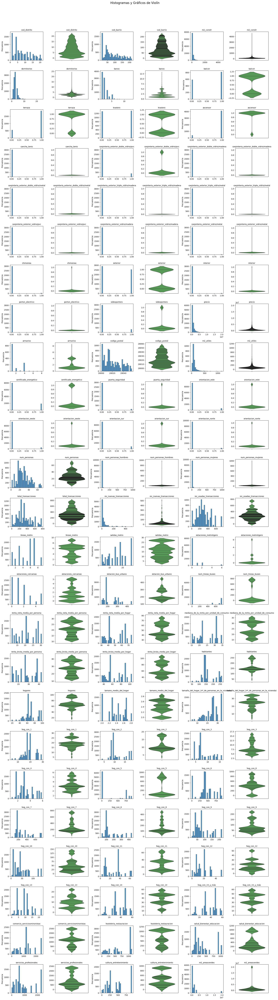

In [101]:
# Gráfico con histogramas y violín

# Parámetros
var_porfila = 3  # Número de variables por fila
graf_porvariable = 2  # Histograma y violín
tot_var = len(cols_num)

# Calcular el número de filas y columnas
n_cols = var_porfila * graf_porvariable  # Total de columnas por fila
n_rows = math.ceil(tot_var / var_porfila)  # Número de filas necesarias

# Crear subplots dinámicamente
fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(20, 3 * n_rows))
fig.suptitle('Histogramas y Gráficos de Violín', fontsize=16)

if n_rows == 1:
    axes = axes.reshape(1, -1)  # Convierte a 2D si hay solo una fila

# Añadir gráficos
for i, col in enumerate(cols_num):
    row = i // var_porfila  # Fila correspondiente
    col_hist = (i % var_porfila) * graf_porvariable  # Columna del histograma
    col_violin = col_hist + 1  # Columna del gráfico de violín

    # Histograma
    sns.histplot(dfEDA[col].dropna(), bins=30, ax=axes[row, col_hist])
    axes[row, col_hist].set_title(f'{col}', fontsize=10)
    axes[row, col_hist].set_xlabel("")
    axes[row, col_hist].set_ylabel("Frecuencia")

    # Gráfico de violín

    sns.violinplot(y=dfEDA[col].dropna(), ax=axes[row, col_violin], inner="stick", color='green', alpha=0.7)

    axes[row, col_violin].set_title(f'{col}', fontsize=10)
    axes[row, col_violin].set_ylabel("")
    axes[row, col_violin].set_xlabel("")

# Ajustar el diseño
plt.tight_layout(rect=[0, 0, 1, 0.96])


Observaciones:
- A primera vista vemos que tenemos dos tipos de variables númericas, discretas y continuas. Además muchsa de las variables discretas son binarias.
Variables continuas: precio,me_constr,etc
Variables binarias: variables de orientacion, carpinteria,exterior,...
Variables discretas no binarias:dormitorios , banos,..
- En los histogramas (azules) que muestran cómo se distribuyen los valores de cada variable , se  pueden identificar distribuciones sesgadas en algunas variables, con datos concentrados en ciertos rangos. Por ejemplo tanto  `precio` como  `m2_constr`y viv_nuevas_transaciones tienen distribuciones sesgadas a la derecho con acumulacion de valores bajos .
- En el caso de las variables binarias tienen solo dos valores posibles (0 o 1), indicando la presencia o ausencia de una característica en el inmueble como es el caso de `balcon`, `terraza`, `trastero`, `ascensor`, `nuda_propiedad`, `acceso_discapacidad`. Los gráficos de violín (verdes) y los histogramas nos muestran cuáles de estas variables tienen una distribución altamente desbalanceada (p.e interior ó tiene_armario)
- Sobre las variables con un solo valor pueden eliminarse del análisis o reemplazar los valores nulos por 0 si se asume que la ausencia del dato significa que la característica no está presente, como por ejemplo  `cancha_tenis`, `tiene_piscina`.
- Algunas variables como `num_plantas`, `num_personas`, `total_transacciones`, `lineas_metro`, `hogares`, `servicios_profesionales`, tienen una distribución amplia, lo que sugiere una gran variabilidad en los datos.

### *7.1.2 Variables categóricas*
Para las variables categóricas, vamos a utilizar gráficos de barras para realizar el analisis ya que ayudan a visualizar la frecuencia de cada categoría.

In [102]:
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 2
Columnas de tipo entero: ['cod_distrito', 'cod_barrio']
------------------------------------------------------
Número de columnas de tipo float: 73
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones',

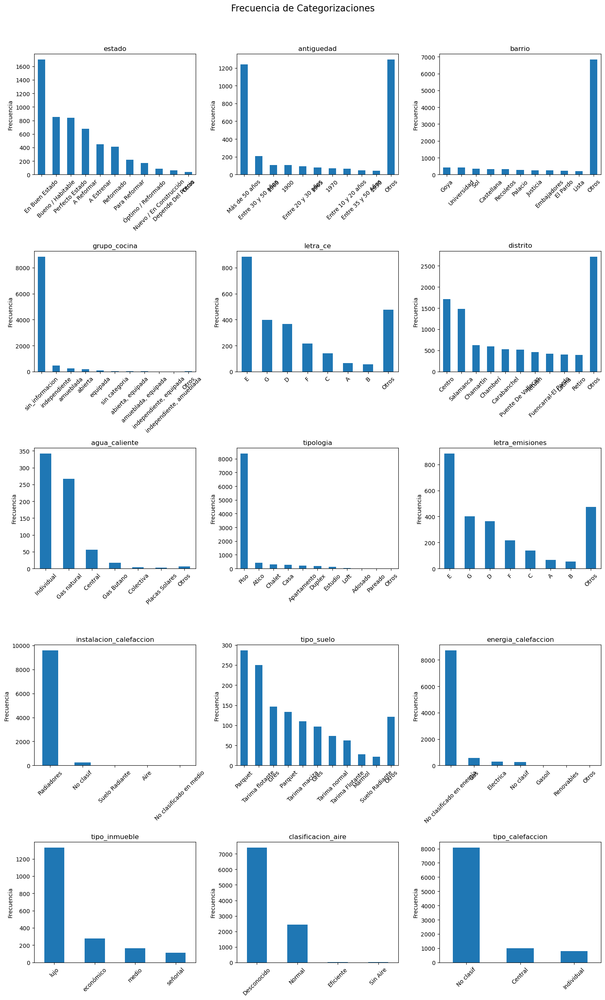

In [103]:
# Definir el número de gráficos por fila
num_por_fila = 3
listacol = cols_cat
# Calcular el número de filas necesarias
num_filas = (len(listacol) + num_por_fila - 1) // num_por_fila  # Redondea hacia arriba para cubrir todos los gráficos

# Crear la figura con subplots
fig, axes = plt.subplots(nrows=num_filas, ncols = num_por_fila, figsize=(15, 5 * num_filas))
fig.suptitle("Frecuencia de Categorizaciones", fontsize=16)

# Asegurarse de que `axes` es 2D
# axes = axes.reshape(num_filas, num_por_fila)
# Bucle para crear los gráficos en cada fila
for i, col in enumerate(listacol):
    # Obtener la fila y columna correspondiente
    row = i // num_por_fila
    col_idx = i % num_por_fila

    # Crear el gráfico de barras
    top_10 = graficobarrascategoricas(dfEDA, col)

    # Dibujar el gráfico de barras
    top_10.plot(kind='bar', ax=axes[row, col_idx])

    # Configurar los títulos y etiquetas
    axes[row, col_idx].set_title(f'{col}', fontsize=12)
    axes[row, col_idx].set_xlabel("")
    axes[row, col_idx].set_ylabel("Frecuencia")

    # Rotar las etiquetas del eje X
    axes[row, col_idx].tick_params(axis='x', rotation=45)

    # Ajustar el diseño
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Ajustar el diseño para que no se superpongan

Observaciones: En varias variables, hay una categoría dominante.
- `tipo_fachada`: Tiene una variedad de materiales, pero "Ladrillo" es el más común, lo que puede reflejar tendencias constructivas predominantes en la región.
- `tipo_calefaccion`: La mayoría de los inmuebles no tienen calefacción o no se ha especificado.
- `tipologia`: Nos indica que existen mucho más ofertas de "pisos" que de otra tipología de vivienda.
- `tipo_inmueble`: La categoría "lujo" tiene una mayor representación en comparación con otras categorías como "económico" o "medio". Hay que verificar si es por presencia de nulos en las observaciones de la mayoría de los inmuebles.
- `estado`: Presenta una mayor cantidad de registros en "En buen estado" y "Buena/muy buena calidad", indicando que la mayoría de los inmuebles ofertados están en condiciones óptimas.
- `letra_ce`: Muestra que muchos inmuebles tienen clasificaciones energéticas bajas (E, G, D), lo que puede ser un factor importante para compradores interesados en eficiencia.
-Existen categorias con muchos valores diferentes que se pueden agrupar para realizar el analisis, p.e. antiguedad ó estado.

## *7.2 Análisis bivariado*
El análisis bivariado nos permite estudiar la relación entre dos variables, ya sean numéricas o categóricas.

### *7.2.1 Variables numéricas*


#### *7.2.1.1 Pairplots*
Utilizaremos *Pairplots* para ver la relación entre nuestra target `precio` y algunas de las variables numéricas más relevantes identificadas después de la exploración del análisis univariado.

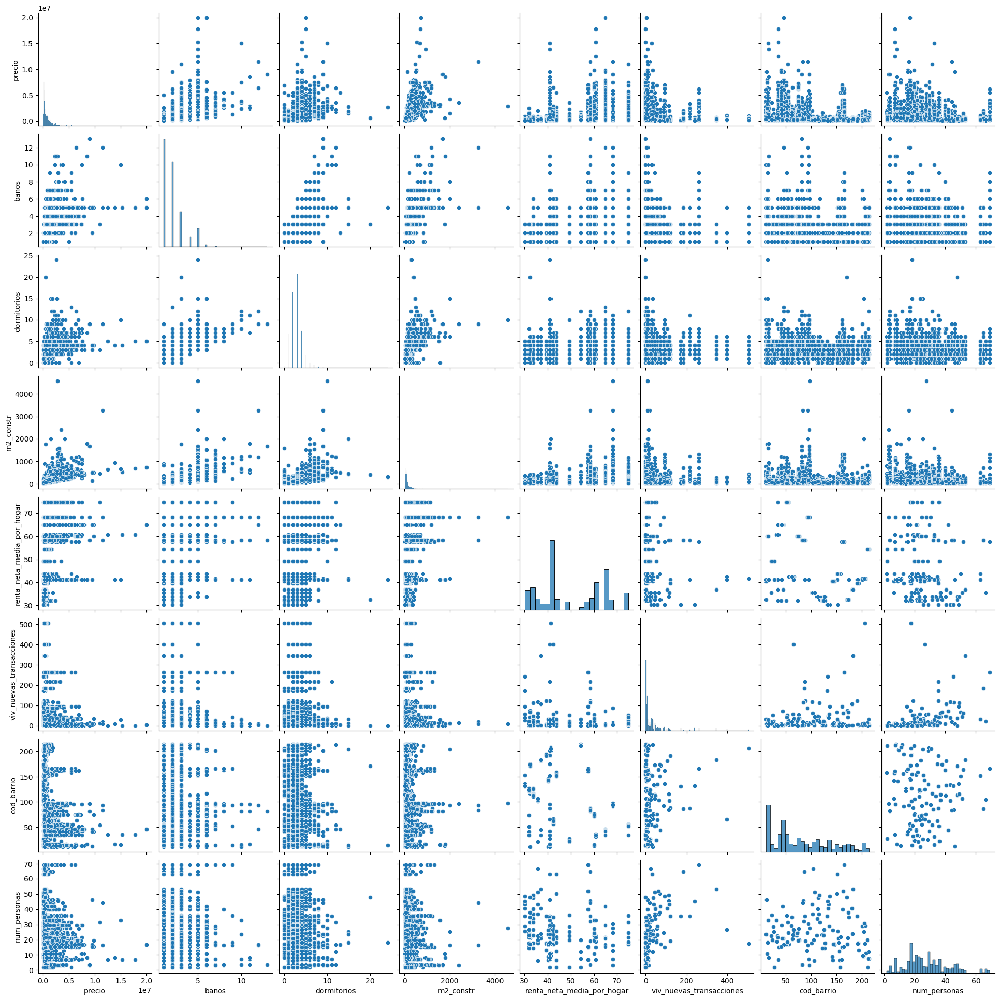

In [104]:
cols = ['precio', 'banos', 'dormitorios', 'm2_constr', 'renta_neta_media_por_hogar', 'viv_nuevas_transacciones', 'cod_barrio','num_personas']
sns.pairplot(dfEDA[cols])

Observaciones:
- `precio` vs. `m2_constr` y `m2_utiles`: Hay una correlación positiva, a medida que aumenta el tamaño construido (metros cuadrados), el precio tiende a incrementarse. La dispersión muestra una nube de puntos con una tendencia ascendente.
- `precio` vs. `dormitorios`: Al igual que en las variables de metros construidos, el precio aparenta tener una tendencia ascendente.
- `precio` vs. `cod_barrio`: La relación entre precio y código de barrio es menos clara. Es probable que el gráfico refleje precios variados dentro de cada barrio, y que el barrio afecte, pero de manera categórica. Será necesario analizar la comparación de medias por barrio.
- `precio` vs. `banos`: La mayoría de los datos están agrupados en la parte inferior izquierda del gráfico. Muchas viviendas tienen precios bajos y cuentan con un número reducido de baños.Es posible que haya una ligera correlación entre el número de baños y el precio de la vivienda. A medida que aumenta el número de baños ,aumente el precio de la vivienda.Hay un par de puntos alejados del grupo principal. Por ejemplo, un punto representa una vivienda con un precio muy alto pero con un número reducido de baños. Esto podría ser un error en los datos o una vivienda especial.
- `precio` vs.`viv_nuevas_transacciones`: Podemos ver una concentracion de transaciones d precios bajos en la esquina inferior izquierda.
-  `precio` vs. `renta neta media por hogar`. Muchos de los datos están concentrados en la esquina inferior izquierda del gráfico. Esto sugiere que la mayoría de las viviendas tienen precios bajos y están asociadas con hogares de renta media más baja. Aunque podemos ver algunos casos donde el precio de las viviendas o la renta media varía significativamente (posibles valores atípicos).

#### *7.2.1.2 Matriz de correlación y heatmap*
Utilizamos la matriz de correlación para  identificar relaciones entre variables numéricas.

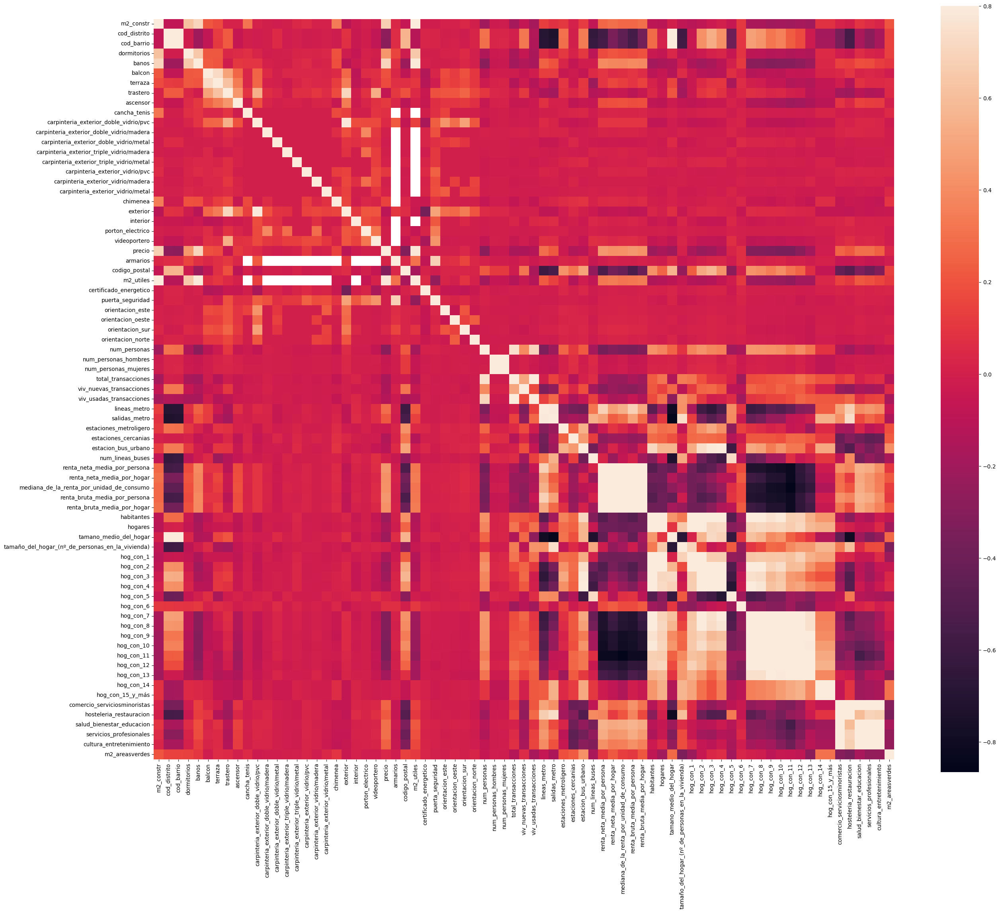

In [105]:
dfcorr =dfEDA.corr(numeric_only=True).copy()
f, ax = plt.subplots(figsize=(30, 25))
sns.heatmap(dfcorr, vmax=0.8, square=True);

El mapa de calor nos sirve para conocer las variables y sus relaciones.
A primera vista vemos que alguna variable'inmuebles_ingresos ó cancha_tenis que son lineas completamente blancas , lo que parece indicar ausencia de datos.
Tambien se puede observar que hay algunas variables muy correladas entre ellas.
Vamos a estudiar de que varibles se trata.

In [106]:
# Establecer un umbral para la correlación (80%)
threshold = 0.90

# Identificar pares de variables con correlación
correlations = []
already_seen = set()

for col in dfcorr.columns:
    for row in dfcorr.index:
        if abs(dfcorr.loc[row, col]) > threshold and col != row:
            pair = tuple(sorted((row, col)))  # Crear pares únicos
            if pair not in already_seen:
                correlations.append((row, col, dfcorr.loc[row, col]))
                already_seen.add(pair)  # Marcar par como ya visto

# Imprimir los resultados
print("Pares de variables con correlación mayor al 90%:")
for var1, var2, corr in correlations:
    print(f"{var1} y {var2}: {corr:.2f}")


Pares de variables con correlación mayor al 90%:
m2_utiles y m2_constr: 0.98
cod_barrio y cod_distrito: 0.99
num_personas_mujeres y num_personas_hombres: 0.99
viv_usadas_transacciones y total_transacciones: 0.94
renta_neta_media_por_hogar y renta_neta_media_por_persona: 0.95
mediana_de_la_renta_por_unidad_de_consumo y renta_neta_media_por_persona: 0.97
renta_bruta_media_por_persona y renta_neta_media_por_persona: 1.00
renta_bruta_media_por_hogar y renta_neta_media_por_persona: 0.96
mediana_de_la_renta_por_unidad_de_consumo y renta_neta_media_por_hogar: 0.98
renta_bruta_media_por_persona y renta_neta_media_por_hogar: 0.95
renta_bruta_media_por_hogar y renta_neta_media_por_hogar: 1.00
renta_bruta_media_por_persona y mediana_de_la_renta_por_unidad_de_consumo: 0.97
renta_bruta_media_por_hogar y mediana_de_la_renta_por_unidad_de_consumo: 0.98
renta_bruta_media_por_hogar y renta_bruta_media_por_persona: 0.96
hogares y habitantes: 0.93
hog_con_2 y habitantes: 0.98
hog_con_3 y habitantes: 0.90

Podemos observar que tenemos muchas variables con una correlación significativa, es tan fuerte que podría indicar multicolinealidad, es decir, que básicamente ofrecen la misma información.

Mostramos la correlación de la variable 'target' con las demás variables numéricas

In [107]:
dfcorr[['precio']].sort_values(by = 'precio',ascending = False).style.background_gradient()

,precio
precio,1.000000
m2_utiles,0.778172
banos,0.701304
m2_constr,0.671245
renta_bruta_media_por_persona,0.446217
renta_neta_media_por_persona,0.445143
dormitorios,0.440390
renta_bruta_media_por_hogar,0.422353
mediana_de_la_renta_por_unidad_de_consumo,0.418649
renta_neta_media_por_hogar,0.414906


Observaciones:
- Se puede apreciar una fuerte correlación entre la variable *target* `precio` con: `m2_utiles`, `m2_constr`, y `banos`.
- Existe una correlación más baja pero igualmente importante con: `cod_distrito`,`dormitorios`, `renta neta media por persona`, `renta_bruta_media_por_hogar`, `mediana de la renta por unidad de consumo`, `renta bruta media por persona`, `renta bruta media por hogar`, `salud_bienestar_educacion`, `servicios_profesionales`, y `lineas_metro`.
- Hay una correlación más baja con: `Nuda propiedad`, `codigo_postal`, `hog_con_7`, `hog_con_8`, `hog_con_9`, y `hog_con_10`, `hog_con_11`.

#### *7.2.1.3 Histogramas y distribución de variables numéricas* 
Seleccionamos un subconjunto de variables numéricas para hacer el estudio ya que identificamos que tienen alta correlación con la variable target 'precio'.

In [108]:
dfEDA.columns

Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'garaje', 'trastero', 'ascensor',
       'antiguedad', 'jardin', 'tipo_inmueble', 'cancha_tenis',
       'carpinteria_exterior_doble_vidrio/pvc',
       'carpinteria_exterior_doble_vidrio/madera',
       'carpinteria_exterior_doble_vidrio/metal',
       'carpinteria_exterior_triple_vidrio/madera',
       'carpinteria_exterior_triple_vidrio/metal',
       'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera',
       'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
       'armarios', 'codigo_postal', 'm2_utiles', 'tipo_suelo',
       'certificado_energetico', 'puerta_seguridad', 'gastos_comunidad',
       'agua_caliente', 'orientacion_este', 'orientacion_oeste',
       'orientacion_su

In [109]:
dfEDA["servicios_profesionales"].value_counts(dropna=False)

servicios_profesionales
582.00     1725
2315.00    1486
505.00      625
1910.00     596
854.00      529
189.00      521
1502.00     459
121.00      422
628.00      404
349.00      394
1049.00     390
347.00      373
828.00      343
969.00      290
1135.00     289
79.00       288
0.00        228
689.00      192
52.00       116
309.00      102
522.00       99
Name: count, dtype: int64

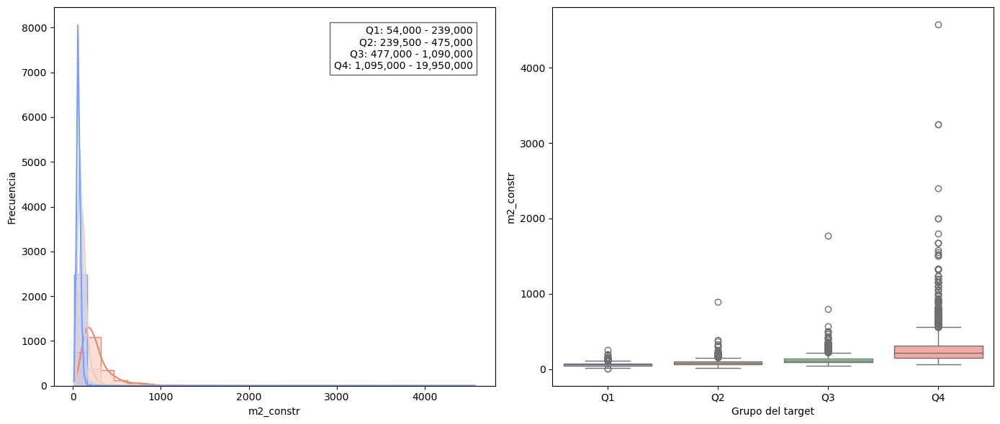

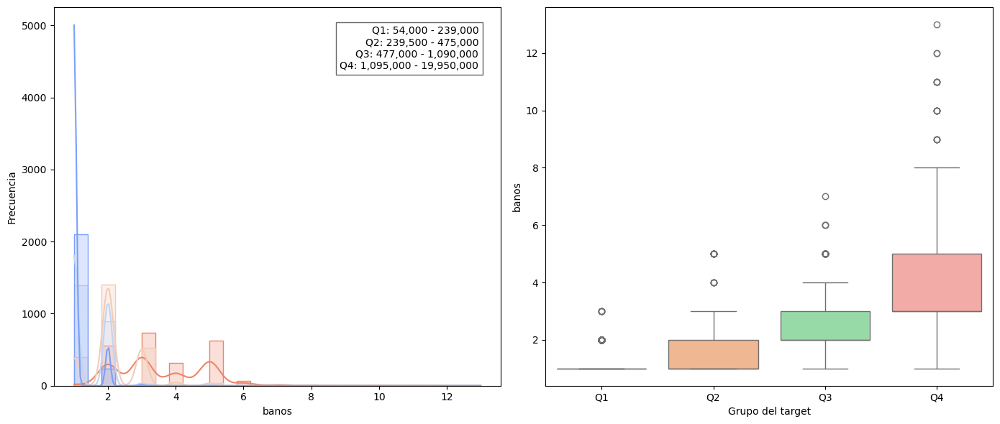

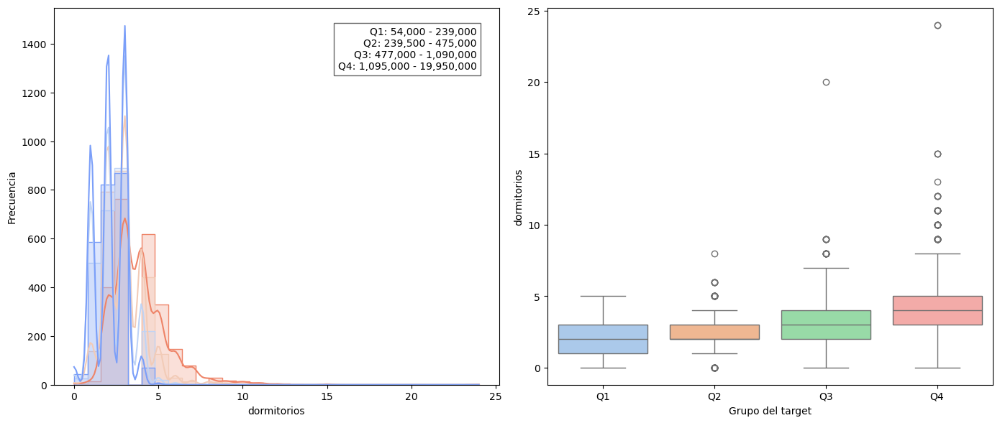

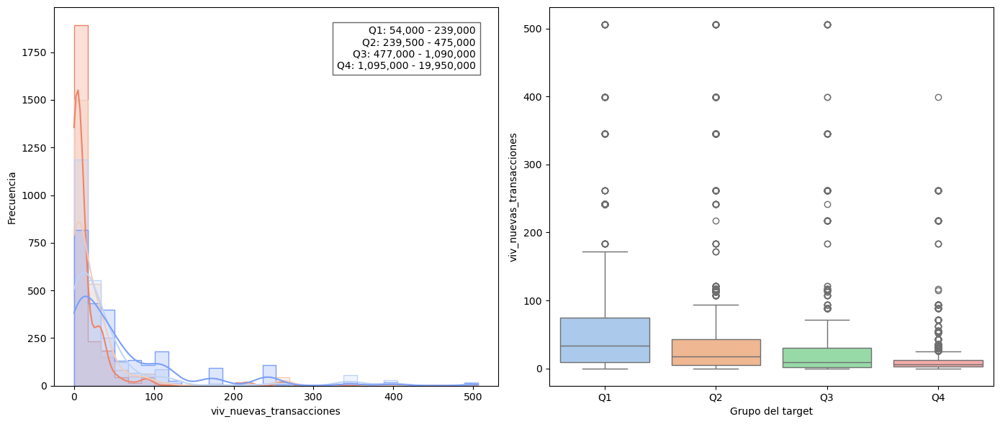

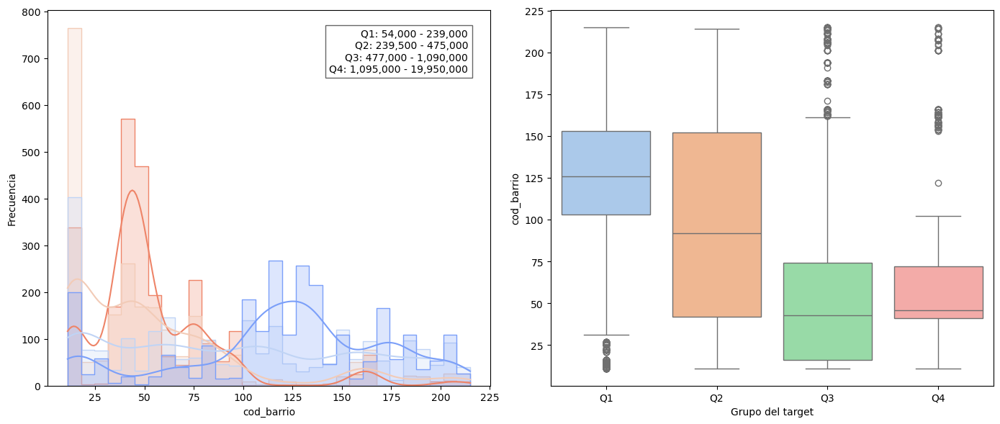

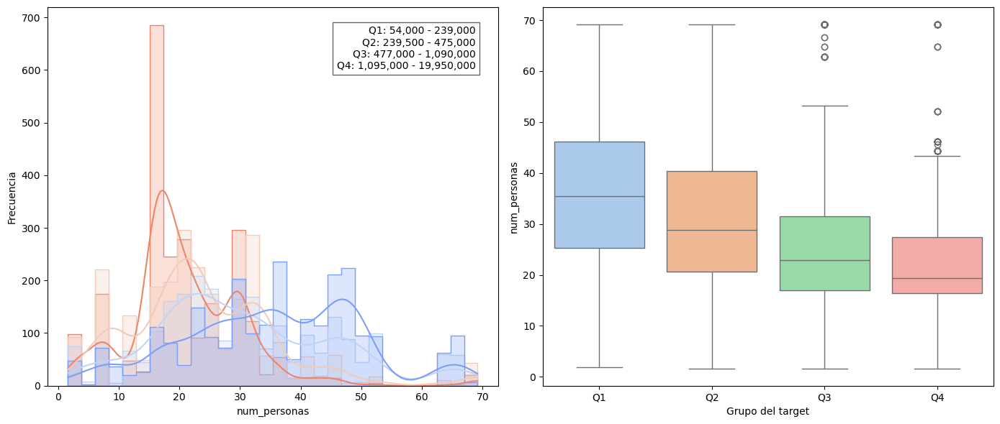

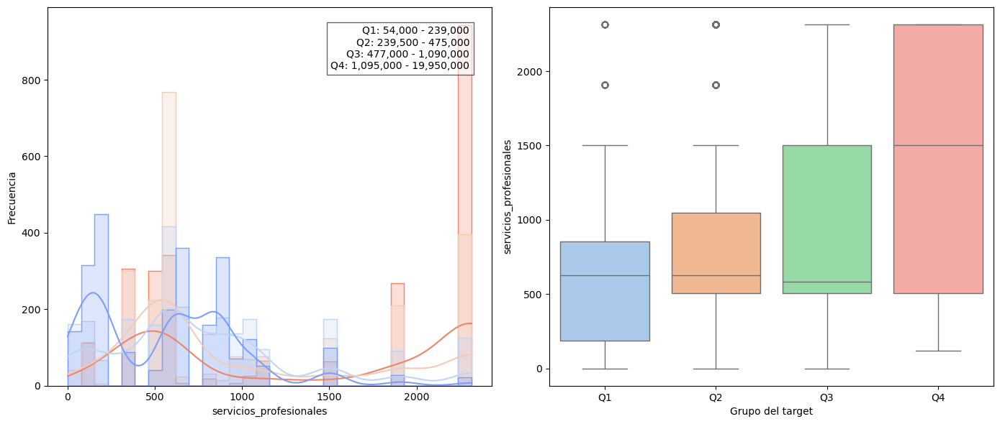

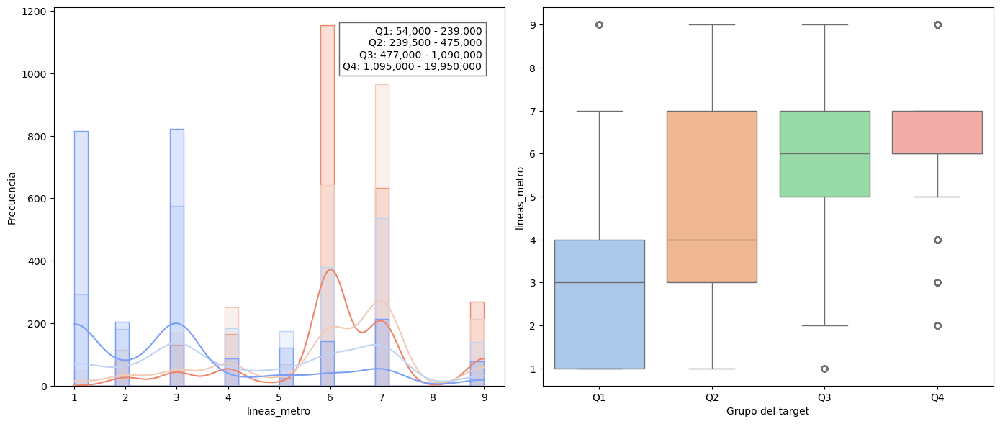

In [110]:
# Definir columnas numéricas a analizar
cols_var_num = [
     'm2_constr', 'banos', 'dormitorios', 'viv_nuevas_transacciones',  'cod_barrio', 
      'num_personas','servicios_profesionales', 'lineas_metro'
]

# Ordenar el dataset solo una vez si es necesario
dfEDA_sorted = dfEDA.sort_values('precio')

# Generar los gráficos con la transformación logarítmica en precio
for col in cols_var_num:
   plot_histogram_boxplot(df=dfEDA_sorted, input_name=col, target_name='precio')

Observaciones:
- En los histogramas, la mayoría de las variables presentan una distribución sesgada a la derecha. Esto significa que la mayoría de los valores están concentrados en el rango bajo, mientras que hay algunas propiedades con valores extremadamente altos.
- En los boxplots, los valores extremos o *outliers* son muy evidentes, especialmente en variables como `m2_constr` y `m2_utiles`.
- Existe una relación clara entre los metros cuadrados y el precio, donde a mayor tamaño del inmueble, mayor suele ser el precio. Sin embargo, la dispersión es alta, lo que indica que no siempre un inmueble más grande es más caro, probablemente debido a la ubicación o características adicionales. Los boxplots muestran una gran cantidad de valores atípicos, lo que sugiere que existen propiedades que, aún con tamaños pequeños, tienen precios extremadamente altos. Esto podría deberse a factores como la ubicación premium o características de lujo.
- Se observa una tendencia donde los inmuebles con más dormitorios y baños tienen un precio más alto. Sin embargo, el boxplot muestra que hay valores extremos, donde algunas viviendas con pocos dormitorios y baños tienen precios elevados, lo que podría ser indicativo de la ubicación de estas viviendas.
- Se evidencian diferencias significativas en los precios dependiendo del distrito o barrio. Los distritos más exclusivos tienen un precio significativamente más alto, mientras que en otras zonas el precio es más accesible. El boxplot muestra una gran dispersión en algunos distritos, lo que sugiere una combinación de propiedades de alto y bajo costo dentro del mismo distrito.
- Existe una correlación positiva entre la renta media del hogar y el precio del inmueble: las zonas con mayores ingresos tienden a tener propiedades más caras. El boxplot muestra una variabilidad considerable, lo que sugiere que aunque la renta media sea alta, hay excepciones con propiedades accesibles dentro de esas áreas.
- No parece haber una relación lineal clara entre el número de líneas de metro cercanas y el precio del inmueble. En el boxplot, se observa una dispersión importante, lo que indica que la cercanía a múltiples líneas de metro no es un factor determinante del precio por sí solo, pero podría influir dependiendo de la zona.

### *7.2.2 Variables categóricas*
Analizamos la relación de la variable target `precio` con las variables categóricas.

Generamos barplots con la media y mediana de la variable a analizar (precio)  frente a varias categóricas.

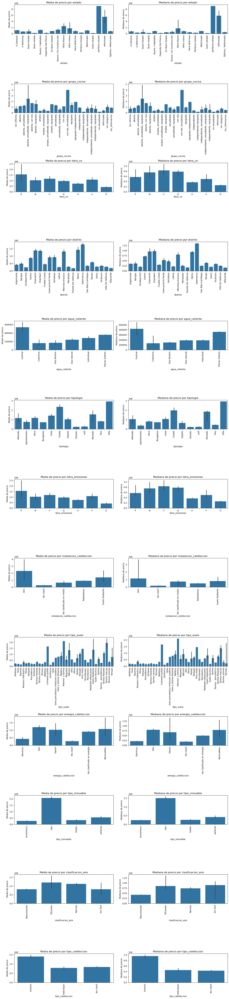

In [111]:
# de las variables categoricas quitamos barrio y antiguedad  y lo analizamos despues en un grafico a parte para mejorar la visualización

# Filtrar las variables categóricas excepto "barrio" y "antiguedad"
cols_a = [col for col in cols_cat if col not in ["barrio", "antiguedad"]]

# Generar gráficos de barras de media y mediana del precio
generar_barplot_media_mediana(dfEDA, cols_a, 'precio')




Observaciones:
- Se observan diferencias significativas en el precio promedio en función de distintas variables categóricas. 
- Se identifican algunas categorías en variables como `tipo_inmueble`, `distrito`, `barrio`, `estado` y `tipologia` que presentan precios significativamente más altos o bajos.
- En las variables `distrito`, se evidencian diferencias claras en el precio medio entre distintas zonas, lo que indica que la ubicación es un factor determinante en el valor de los inmuebles.
- En algunos gráficos, los intervalos de confianza son amplios, lo que indica que existe una gran dispersión en los precios dentro de ciertas categorías. Algunas variables como `energía_calefaccion`, `letra_ce` o `tipo_suelo` parecen tener un impacto menos significativo en el precio, ya que las diferencias entre categorías son menores.

Conclusión:
- Identificar las variables categóricas más influyentes: Variables como `tipo_inmueble`, `distrito`, `barrio`, `estado` y `tipologia` deben ser consideradas en cualquier análisis predictivo, ya que tienen un alto impacto en el precio.
- Reducir la cantidad de categorías poco representadas: Algunas categorías tienen muy pocos registros y podrían agruparse en una categoría más general para mejorar la interpretación de los datos.
- Analizar la interacción entre variables: Analizaremos si ciertas combinaciones de categorías influyen aún más en el precio, por ejemplo, la tipologia de un inmueble dentro de un distrito específico.
- Considerar la eliminación o transformación de variables menos relevantes: Si algunas variables categóricas no tienen una variación significativa en los precios, podrían descartarse en análisis posteriores.

#### *7.2.3 Combinación de variables categoricas vs precio*


##### Distrito y m2_contr vs precio

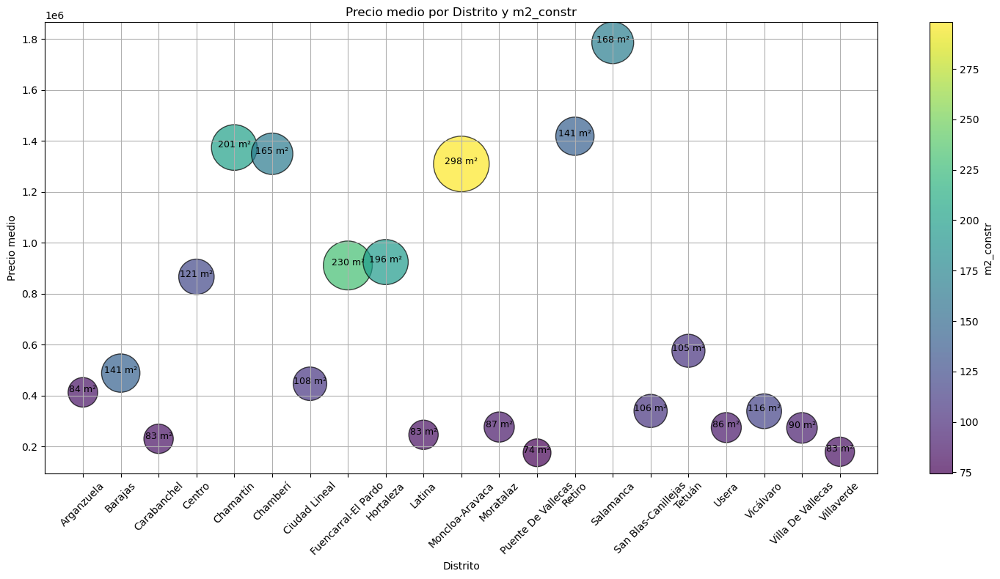

In [112]:

# Agrupación de datos
stats = dfEDA.groupby('distrito').agg({'precio': 'mean', 'm2_constr': 'mean'}).reset_index()

# Crear gráfico de burbujas con colores diferenciados
plt.figure(figsize=(15, 8))

# Usar una escala de colores para `m2_constr`
scatter = plt.scatter(
    stats['distrito'], stats['precio'],
    s=stats['m2_constr'] * 10,  # Tamaño según `m2_constr`
    c=stats['m2_constr'],       # Color según `m2_constr`
    cmap='viridis',             # Paleta de colores
    alpha=0.7, edgecolors='black'
)

plt.colorbar(scatter, label='m2_constr')  # Barra de color para referencia
plt.xticks(rotation=45)
plt.title('Precio medio por Distrito y m2_constr')
plt.xlabel('Distrito')
plt.ylabel('Precio medio')
plt.grid(True)

# Añadir etiquetas de m2 en cada burbuja
for i in range(len(stats)):
    plt.text(stats['distrito'][i], stats['precio'][i], f"{int(stats['m2_constr'][i])} m²", fontsize=9, ha='center')

plt.tight_layout()
plt.show()


Se observa que las viviendas tienden a ser más amplias dependiendo del distrito, y también presentan precios más elevados. Sin embargo, el distrito con el precio medio más alto es Salamanca, pero este no coincide con las viviendas de mayor tamaño en términos de metros cuadrados construidos. Esto indica que en Salamanca, el alto precio podría estar más relacionado con factores como la ubicación, o demanda, más que con el tamaño de las viviendas.

##### Dormitorios+baños con respecto distrito y el precio

Para analizar la relación entre el número de dormitorios y baños, su ubicación y el precio, vamos a generar una gráfica de calor que muestra el precio promedio de las viviendas (en miles de euros) en función de la suma de dormitorios y baños (eje X) y la ubicación (eje Y, que representa los diferentes distritos). 
El color azul representa precios más bajos y el rojo precios más altos.


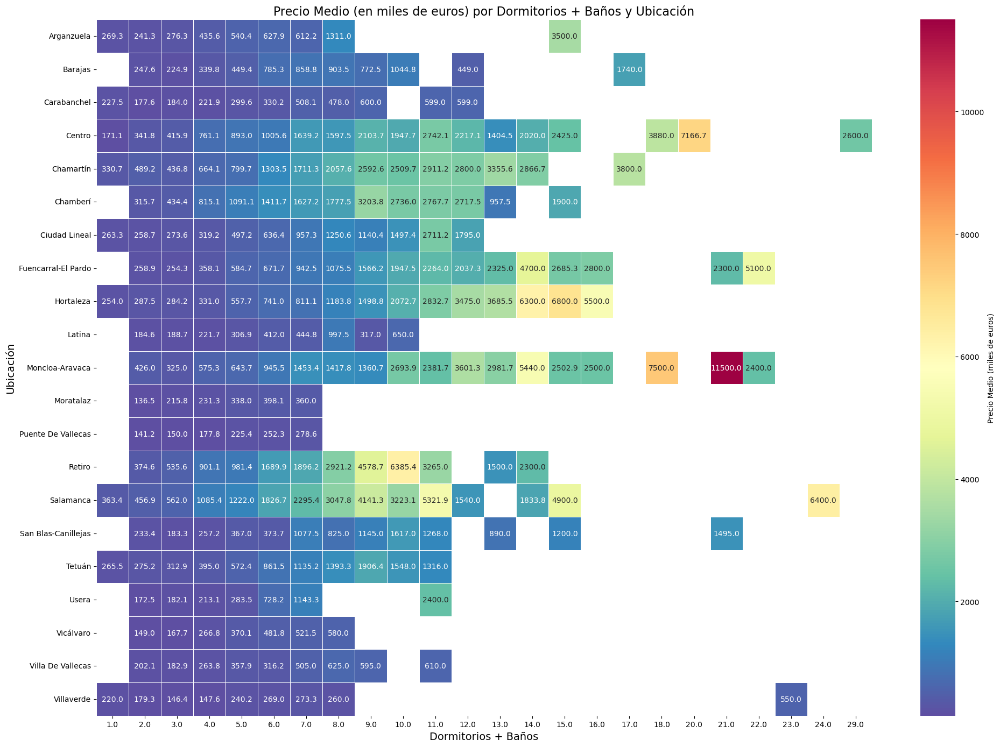

In [113]:
# Agrupar por distrito y dormitorios + baños, convertir precio a miles de euros
dfEDA["dormitorios_banos"] = dfEDA["dormitorios"] + dfEDA["banos"]
heatmap_data = (dfEDA.groupby(['distrito', 'dormitorios_banos'])['precio'].mean() / 1000).unstack()

# Crear el heatmap con la paleta invertida
plt.figure(figsize=(20, 14))
sns.heatmap(heatmap_data, 
            cmap='Spectral_r',  # Invertir la paleta de colores (r para reverse)
            annot=True,         # Mostrar valores numéricos
            fmt=".1f",          # Formato de los números
            linewidths=0.5,     # Separación entre celdas
            cbar_kws={'label': 'Precio Medio (miles de euros)'})  # Etiqueta para la barra de color

# Personalización del gráfico
plt.title('Precio Medio (en miles de euros) por Dormitorios + Baños y Ubicación', fontsize=16)
plt.xlabel('Dormitorios + Baños', fontsize=14)
plt.ylabel('Ubicación', fontsize=14)
plt.tight_layout()

# Mostrar el gráfico
plt.show()


A medida que aumenta la cantidad de dormitorios y baños, los precios tienden a ser más elevados.Sin embargo, este  patrón no es uniforme en todos los distritos, lo que indica que otros factores como la ubicación específica tienen un impacto significativo.
Algunos distritos presentan precios elevados incluso para viviendas más pequeñas, lo que sugiere que la ubicación puede ser el principal determinante del precio en esos casos (por ejemplo, distritos exclusivos como Salamanca).

En otros distritos, los precios parecen estar más relacionados con el tamaño de la vivienda.
Los distritos más asequibles tienen predominio de colores azulados incluso para viviendas más grandes.
Análisis de valores atípicos:

Puede haber distritos donde viviendas más grandes no correspondan proporcionalmente a precios más altos, lo cual podría indicar factores externos como demanda, nivel socioeconómico o antigüedad de las propiedades

In [114]:
#Elimino la variable creada para la visualizacion
dfEDA=dfEDA.drop(columns="dormitorios_banos")

# *8. Generación de un fichero para el desarrollo de un modelo inicial baseline*



Vamos a generar un primer modelo baseline con los datos en bruto.

In [115]:
dfEDA.shape

(9871, 98)

In [116]:
# Exportar CSV de control para generación de un primer modelo baseline
dfEDA.to_csv("dfbaseline_sin_process.csv",index=False)

# *9. Limpieza y procesamiento de datos*
Dependiendo de la cantidad de valores nulos y duplicados detectados, se pueden tomar las siguientes acciones:
- Eliminar registros duplicados si no aportan valor al análisis.
- Gestionar valores faltantes:
    Aquellos valores nulos que se imputarán a un valor fijo ("Desconcido" en categoricas, 0 en númericas) se realizaran en este capitulo.
    La imputación de nulos que conlleve la utilización de estadisticos, ya sea la moda,la mediana o la media del conjunto de datos, se realizará la imputación después de dividir entre train,validacion y test. Esto garantizará que la información de los tres conjuntos de datos permanezca independiente.
    Si lo realizaramos antes el modelo de entrenamiento podría beneficiarse de información del conjunto de validación o test, generando resultados optimistas y poco realistas.Además garantiza que las métricas obtenidas en validación y test sean fiables y representen el rendimiento del modelo en datos desconocidos.


## *9.1 Variables categóricas: agrupación e imputación de nulos*


 
- *Algunas variables categóricas previamente definidas se convertirán en numéricas tras su agrupación, con el objetivo de utilizarlas en el modelo.** Ejemplos de estas variables incluyen `estado` y `letra_ce`.  
- *Las variables categóricas que se conserven como tales al finalizar este capítulo tendrán sus valores nulos imputados con "Desconocido".*



In [117]:
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 2
Columnas de tipo entero: ['cod_distrito', 'cod_barrio']
------------------------------------------------------
Número de columnas de tipo float: 73
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones',

Veamos el porcentaje de nulos de cada varaible

In [118]:
# Iterar sobre las columnas categóricas y mostrar solo las que tienen valores nulos > 0%
for col in cols_cat:
    porcentaje_nulos = (dfEDA[col].isna().sum() / len(dfEDA)) * 100
    if porcentaje_nulos > 0:
        print(f"Porcentaje de valores nulos en la columna '{col}': {porcentaje_nulos:.2f}%")


Porcentaje de valores nulos en la columna 'estado': 44.21%
Porcentaje de valores nulos en la columna 'antiguedad': 66.04%
Porcentaje de valores nulos en la columna 'letra_ce': 78.48%
Porcentaje de valores nulos en la columna 'agua_caliente': 93.03%
Porcentaje de valores nulos en la columna 'letra_emisiones': 78.48%
Porcentaje de valores nulos en la columna 'tipo_suelo': 86.55%
Porcentaje de valores nulos en la columna 'tipo_inmueble': 80.92%


Revisamos los valores que toma cada variable

### *9.1.1 Distrito y Barrio*

La columnas distrito y barrio no tiene valores nulos

In [119]:
dfEDA['distrito'].value_counts(dropna=False)

distrito
Centro                 1714
Salamanca              1486
Chamartín               625
Chamberí                596
Carabanchel             532
Puente De Vallecas      520
Tetuán                  459
Fuencarral-El Pardo     422
Latina                  405
Retiro                  395
Ciudad Lineal           392
Moncloa-Aravaca         373
San Blas-Canillejas     344
Arganzuela              290
Hortaleza               289
Villaverde              288
Villa De Vallecas       229
Usera                   194
Vicálvaro               116
Moratalaz               103
Barajas                  99
Name: count, dtype: int64

In [120]:
dfEDA['barrio'].value_counts(dropna=False)

barrio
Goya           432
Universidad    411
Sol            339
Castellana     326
Recoletos      325
              ... 
La Paz           8
Aeropuerto       7
Valderrivas      3
Horcajo          1
El Goloso        1
Name: count, Length: 131, dtype: int64

Observaciones:
- No se necesita hacer agrupación.
- No se necesita imputar nulos.

### *9.1.2 Estado*

In [121]:
dfEDA['estado'].value_counts(dropna=False)

estado
NaN                        4364
En Buen Estado             1698
Bueno / Habitable           853
Perfecto Estado             840
A Reformar                  678
A Estrenar                  450
Reformado                   413
Para Reformar               219
Óptimo / Reformado          168
Nuevo / En Construcción      85
Depende Del Precio           64
Obra Nueva                   17
reformado                     9
Obra nueva                    7
Buen Estado                   3
Buen estado                   1
buen estado                   1
perfecto estado               1
Name: count, dtype: int64

Creamos un diccionario de mapeo para agrupar las categorías y posteriormente convertirlas a numéricas:
NaN: 0, Para reformar: 1, Buen estado: 2, Perfecto estado: 3, Reformado: 4, Obra nueva: 5

In [122]:
estado_map = {
    "en buen estado": 2,
    "buen estado": 2,
    "bueno / habitable": 2,
    "perfecto estado": 3,
    "a estrenar": 5,
    "reformado": 4,
    "a reformar": 1,
    "para reformar": 1,
    "estado a reformar": 1,
    "óptimo / reformado": 4,
    "nuevo / en construcción": 5,
    "depende del precio": 1,
    "estado obra nueva": 5,
    "obra nueva": 5
}

dfEDA["estado"] = dfEDA["estado"].str.lower() 
dfEDA['estado'] = dfEDA['estado'].replace(estado_map)
dfEDA['estado'].value_counts(dropna=False)
print(f"Porcentaje de valores nulos en la columna 'estado': {(dfEDA['estado'].isna().sum() / len(dfEDA) * 100):.2f}%")


Porcentaje de valores nulos en la columna 'estado': 44.21%


In [123]:
# Imputamos 0 a los valores nulos
dfEDA["estado"] = dfEDA["estado"].fillna(0)
dfEDA["estado"].value_counts(dropna=False)

estado
0.00    4364
2.00    2556
1.00     961
3.00     841
4.00     590
5.00     559
Name: count, dtype: int64

In [124]:
dfEDA["estado"]=dfEDA["estado"].astype(int)

Hemos creado un diccionario llamado estado_map para asignar un valor numérico a cada descripción del estado de una vivienda, agrupando términos similares bajo un mismo número, convirtiendo datos categóricos en valores númericos, para que los modelos de análisis pueden manejarlos fácilmente.
Los valores asignados siguen una escala jerárquica: desde 0 valores faltantes, 1 para viviendas en mal estado (por ejemplo, "a reformar"), hasta 5 para viviendas nuevas o en perfecto estado. Esta transformación simplifica el análisis y añade consistencia a la información del dataset. 

### *9.2.3 Antigüedad*

In [125]:
dfEDA["antiguedad"].value_counts(dropna=False)

antiguedad
NaN                   6519
Más de 50 años        1241
Entre 30 y 50 años     208
1960                   107
1900                   105
                      ... 
1923                     1
1949                     1
 1925                    1
1965.0                   1
 1923                    1
Name: count, Length: 165, dtype: int64

In [126]:

dfEDA["antiguedad"]=dfEDA["antiguedad"].str.strip()
dfEDA['antiguedad'] = dfEDA['antiguedad'].str.replace(r'^\s+|\s+$', '', regex=True)

# Aplicamos la función para agrupar el año en que fue construida la vivienda
dfEDA['antiguedad'] = dfEDA['antiguedad'].apply(categorize_ano_construccion)

# Aplicacamos la funcion agrupar_antiguedad para agrupar las disintas categorias de antigüedad
dfEDA['antiguedad'] = dfEDA['antiguedad'].apply(agrupar_antiguedad)


In [127]:
# Verificamos los primeros registros para comprobar que la agrupación fue realizada correctamente
dfEDA['antiguedad'].value_counts(dropna=False)


antiguedad
NaN                 6519
Mas_50_anos         2341
Entre_30_50_anos     522
Entre_10_30_anos     391
Menos_5_anos          72
Entre_5_10_anos       26
Name: count, dtype: int64

In [128]:
print(f"Porcentaje de valores nulos en la columna 'antiguedad': {(dfEDA['antiguedad'].isna().sum() / len(dfEDA) * 100):.2f}%")


Porcentaje de valores nulos en la columna 'antiguedad': 66.04%


In [129]:
dfEDA['antiguedad'] = dfEDA['antiguedad'].astype('category')

Observaciones:
- Se imputarán los nulos con el valor 'Desconocido'.

### *9.2.4 Tipo de suelo* ####################################

In [130]:
dfEDA["tipo_suelo"].value_counts(dropna=False)

tipo_suelo
NaN                                  8543
Parquet                               286
Tarima flotante                       250
 Gres                                 146
 Parquet                              133
Tarima maciza                         110
Gres                                   97
 Tarima normal                         73
 Tarima Flotante                       62
Mármol                                 28
Suelo Radiante                         22
 Baldosa                               21
 Terrazo                               16
 Sintasol                              16
 Otros                                 14
Terrazo                                 7
 Porcelánico                            7
Parket                                  6
Tarima                                  5
Moqueta                                 4
Tarima normal                           3
Madera                                  3
 Mosaico Hidráulico                     3
Radiante-refrescante   

In [131]:
# Asegurarse de que todos los valores sean cadenas, manejar valores NaN
dfEDA['tipo_suelo'] = dfEDA['tipo_suelo'].astype(str).str.lower().apply(unidecode).str.strip()
# Aplicar la función a la columna
dfEDA['tipo_suelo'] = dfEDA['tipo_suelo'].apply(categorizar_suelo)

Observaciones:
- Se imputarán los nulos con el valor 'Desconocido'.

### *9.2.5 Letra de consumo / Letra emisiones (certificado energético)*

In [132]:
# Chequeo de valores columnas letra_ce
dfEDA["letra_ce"].value_counts(dropna=False)

letra_ce
NaN    7747
E       885
G       399
D       365
F       216
C       139
A        65
B        55
Name: count, dtype: int64

In [133]:
# Chequeo de valores columnas letra_ce
dfEDA["letra_emisiones"].value_counts(dropna=False)

letra_emisiones
NaN    7747
E       884
G       400
D       365
F       216
C       139
A        65
B        55
Name: count, dtype: int64

In [134]:
mapeo_calificacion = {"A": 7, "B": 6, "C": 5, "D": 4, "E": 3, "F": 2, "G": 1}

for col in ["letra_ce", "letra_emisiones"]:
    # Asegurarte de que las columnas sean categóricas, y agregar el valor 0 como categoría
    if dfEDA[col].dtype.name == 'category':
        dfEDA[col] = dfEDA[col].cat.add_categories([0])
    
    # Aplicar el mapeo y rellenar los nulos
    dfEDA[col] = dfEDA[col].map(mapeo_calificacion).fillna(0).astype('int')

# Verificar los resultados
print(dfEDA[["letra_ce", "letra_emisiones"]].head())


   letra_ce  letra_emisiones
0         2                2
1         3                3
2         0                0
3         0                0
4         0                0


Al igual que el estado se han transformado las  variables 'letra_ce' y 'letra_emisiones' a enteras para utilizarla en el modelo

### *9.2.6 Tipología de propiedad*

In [135]:
dfEDA['tipologia'].value_counts(dropna=False)

tipologia
Piso           8373
Atico           407
Chalet          291
Casa            258
Apartamento     212
Duplex          170
Estudio         111
Loft             32
Adosado          12
Pareado           3
Bungalow          1
Villa             1
Name: count, dtype: int64

In [136]:


# Diccionario de mapeo para agrupar valores en la columna 'tipo_propiedad'
mapeo_tipologia = {
    'Piso': 'Piso',
    'Apartamento': 'Piso',
    'Ático': 'Atico',
    'Atico': 'Atico',
    'Dúplex': 'Duplex',
    'Duplex': 'Duplex',
    'Estudio': 'Estudio',
    'Loft': 'Piso',
    'Chalet': 'Chalet',
    'Chalet Adosado': 'Chalet',
    'Chalet Pareado': 'Chalet',
    'Adosado': 'Casa',
    'Pareado': 'Casa',
    'Villa': 'Chalet',
    'Bungalow': 'Casa',
    'Casa': 'Casa'
}

dfEDA['tipologia'] = dfEDA['tipologia'].replace(mapeo_tipologia)
dfEDA['tipologia'].value_counts(dropna=False)


tipologia
Piso       8617
Atico       407
Chalet      292
Casa        274
Duplex      170
Estudio     111
Name: count, dtype: int64

In [137]:
print(f"Porcentaje de valores nulos en la columna 'tipologia': {(dfEDA['tipologia'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'tipologia': 0.00%


Observaciones:
- No se necesita imputar nulos.

### *9.2.7 Calefacción*

Tenemos 3 variables asociadas a la calefaccion instalacion_calefaccion,energia_calefaccion y tipo_calefaccion. Además tenemos una columna asociada a la generación del agua caliente de la vivienda. Analizaremos los valores que tiene cada una de ellas.


In [138]:

dfEDA["instalacion_calefaccion"].value_counts(dropna=False)

instalacion_calefaccion
Radiadores                 9568
No clasif                   265
Suelo Radiante               21
Aire                         13
No clasificado en medio       4
Name: count, dtype: int64

Observaciones:
- Existe poca variabilidad en los datos teniendo una mayoría de valores de 'Radiadores', eliminaremos esta columna.


In [139]:
dfEDA['agua_caliente'].value_counts(dropna=False)

agua_caliente
NaN                9183
 Individual         342
 Gas natural        267
 Central             56
 Gas Butano          17
 Colectiva            4
 Placas Solares       2
Name: count, dtype: int64

In [140]:


# Reemplazar 'Colectiva' por 'Central'
dfEDA['agua_caliente'] =dfEDA['agua_caliente'].str.strip()
dfEDA['agua_caliente'] = dfEDA['agua_caliente'].replace('Colectiva', 'Central')

# Verificar los resultados
print(dfEDA['agua_caliente'].value_counts())

dfEDA['energia_calefaccion'].value_counts(dropna=False)
dfEDA['tipo_calefaccion'].value_counts(dropna=False)
#Realizamos la agrupación de tipo_calefaccion con agua_caliente en cal_comunitaria
#si tipo_calefaccion'ó agua_caliente es central valdrá 2, de los que no son centrales si cualquiera de los dos es individual el valor es 1 y si no 0

dfEDA["tipo_calefaccion"] = dfEDA["tipo_calefaccion"].str.lower() 
# Definir las condiciones
condiciones = [
    (dfEDA["tipo_calefaccion"] == "Central") | (dfEDA["agua_caliente"] == "Central"),  # Si cualquiera es central
    (dfEDA["tipo_calefaccion"] == "Individual") | (dfEDA["agua_caliente"] == "Individual")  # Si cualquiera es individual
]

# Valores para cada condición
valores = [2, 1]

# Crear la nueva variable en el DataFrame
dfEDA["ins_comunitaria"] = np.select(condiciones, valores, default=0)

dfEDA["ins_comunitaria"]=dfEDA["ins_comunitaria"].fillna(0)


dfEDA["agua_caliente"] = dfEDA["agua_caliente"].str.lower() 
dfEDA["energia_calefaccion"] = dfEDA["energia_calefaccion"].str.lower() 
#Ahora creamos una columna que indique el tipo de enrgia que utiliza la calafaccion y el agua
#agua_caliente,Gas natural  ,Gas Butano  ,Placas Solares  
# energia_calefaccion Gas     ,      Electrica      ,  Gasoil                        
# Definir las condiciones para la columna 'energia'
condiciones = [
    (dfEDA["agua_caliente"] == "placas solares") | (dfEDA["energia_calefaccion"] == "renovables"),  # Renovables
    (dfEDA["energia_calefaccion"] == "electrica"),  # Eléctrica
    (dfEDA["agua_caliente"].isin(["gas natural", "gas butano"])) | (dfEDA["energia_calefaccion"] == "gas"),  # Gas
    (dfEDA["energia_calefaccion"] == "gasoil")  # Gasoil
]

# Valores correspondientes a cada condición
valores = [4, 3, 2, 1]

# Asignar valores a la nueva columna 'energia'
dfEDA["energia"] = np.select(condiciones, valores, default=0)

 

agua_caliente
Individual        342
Gas natural       267
Central            60
Gas Butano         17
Placas Solares      2
Name: count, dtype: int64


In [141]:
dfEDA["energia"].value_counts(dropna=False)

energia
0    8706
2     847
3     289
1      17
4      12
Name: count, dtype: int64

             
Agrupadas las variables Observaciones: 'agua_caliente', 'energia_calefaccion', y 'tipo_calefaccion' ya que se refieren al mismo servicio para el inmueble y de esta manera ayudamos a completar datos faltantes.
#Ademas eliminamos la variable instalacion_calefaccion por que tiene muy poca variabilidad

In [142]:

# Eliminamos las columnas que ya no se utilizaran
cols_eliminar=['agua_caliente','energia_calefaccion','tipo_calefaccion','instalacion_calefaccion']
dfEDA=dfEDA.drop(columns=cols_eliminar)

### *9.2.8 Tipo de inmueble*

In [143]:
dfEDA['tipo_inmueble'].value_counts(dropna=False)

tipo_inmueble
NaN          7988
lujo         1331
económico     276
medio         163
señorial      113
Name: count, dtype: int64

Observaciones:
- No se necesita hacer agrupación.
- Se imputarán los nulos con el valor 'Desconocido'.

### *9.2.9 Tipo de cocina*

In [144]:
dfEDA["grupo_cocina"].value_counts(dropna=False)

grupo_cocina
sin_informacion                       8854
independiente                          447
amueblada                              231
abierta                                188
equipada                                80
sin categoria                           26
abierta, equipada                        8
amueblada, equipada                      8
independiente, equipada                  4
independiente, amueblada                 3
reformada                                2
independiente, amueblada, equipada       2
Sin reforma                              2
amplia, amueblada                        2
amplia                                   2
abierta, amueblada, equipada             2
abierta, amueblada                       2
con isla, amueblada                      1
amplia, equipada                         1
equipada independiente                   1
amplia, amueblada, equipada              1
independiente equipada                   1
abierta, con isla                        

In [145]:
# Aplicar la función categorizar_cocina a la columna 'grupo_cocina'
dfEDA['grupo_cocina'] = dfEDA['grupo_cocina'].apply(categorizar_cocina)

In [146]:
# Mostrar el resultado
print(dfEDA['grupo_cocina'].value_counts())


grupo_cocina
Desconocido      8882
Independiente     458
Amueblada         242
Abierta           201
Equipada           81
Reformada           2
Sin reforma         2
Isla                2
No amueblada        1
Name: count, dtype: int64


In [147]:
print(f"Porcentaje de valores nulos en la columna 'grupo_cocina': {(dfEDA['grupo_cocina'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'grupo_cocina': 0.00%


### *9.2.10 Aire acondicionado*

In [148]:
dfEDA["clasificacion_aire"].value_counts(dropna=False)

clasificacion_aire
Desconocido    7410
Normal         2424
Eficiente        26
Sin Aire         11
Name: count, dtype: int64

In [149]:
print(f"Porcentaje de valores nulos en la columna 'clasificacion_aire': {(dfEDA['clasificacion_aire'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'clasificacion_aire': 0.00%


Observaciones:
- No se necesita agrupar.
- No se necesita imputar nulos.

### *9.2.12 Piscina*

In [150]:
dfEDA["piscina"].value_counts(dropna=False)

piscina
NaN                                          5786
sin piscina                                  3341
1                                             379
comunitaria                                   180
1.0                                            97
propia                                         77
privada                                         9
1 piscina de adultos y 1 piscina de ninos       1
con salorium                                    1
Name: count, dtype: int64

In [151]:
# Definir el mapeo ordinal
piscina_mapping = {
    "sin piscina": 0,
    "comunitaria": 1,
    "propia": 2,
    "privada": 2,
    "1 piscina de adultos y 1 piscina de niños": 1,  # Se agrupa como "Comunitaria"
    "con salorium": 1  # Se agrupa como "Comunitaria"
}
# Aplicar el mapeo ordinal a la columna "piscina"
dfEDA["piscina"] = dfEDA["piscina"].map(piscina_mapping)

In [152]:
dfEDA["piscina"] .value_counts(dropna=False)

piscina
NaN     6263
0.00    3341
1.00     181
2.00      86
Name: count, dtype: int64

In [153]:
# Imputar valores faltantes como "Sin piscina" (0)
dfEDA["piscina"].fillna(0, inplace=True)

In [154]:
dfEDA["piscina"] .value_counts(dropna=False)

piscina
0.00    9604
1.00     181
2.00      86
Name: count, dtype: int64

In [155]:
dfEDA["piscina"]=dfEDA["piscina"].astype(int)

### *9.2.13 Planta*

In [156]:
dfEDA['planta'].value_counts(dropna=False)

planta
NaN                            4460
1                              1363
2                               826
3                               718
4                               549
5                               337
6                               300
0                               186
2.0                             138
1.0                             134
7                               127
Planta baja                     115
3.0                             100
4.0                              82
Entreplanta                      74
8                                60
5.0                              58
9                                48
6.0                              34
planta baja                      27
Principal                        17
7.0                              15
10                               15
11                               12
bajo                             12
13                               11
8.0                               8
12                   

Se van a agrupar los valores encontrados

In [157]:
dfEDA['planta'] = dfEDA['planta'].str.replace(' ,', '').str.strip()
dfEDA.loc[dfEDA['planta'] == 'Entreplanta', 'planta'] = 0.5
# Sustituir "Planta baja" por 0 en la columna 'planta'
val=('Planta baja','bajo','Planta baja, principal','planta baja')
dfEDA['planta'] = dfEDA['planta'].replace(val, 0)
# Reemplazar "Semi-sótano" por "-0,5" en la columna 'planta'
dfEDA['planta'] = dfEDA['planta'].replace('Semi-sótano', -0.5)
val=('Sótano (-1), 6','Sótano (-1), 2')
dfEDA['planta'] = dfEDA['planta'].replace(val, -1)

# Eliminar esta fila por que son 3 viviendas
dfEDA = dfEDA[dfEDA['planta'] != 'Planta baja, de la 1 a la 3, 5']
dfEDA = dfEDA[dfEDA['planta'] != 'De la principal a la 2']

# Actualizar la columna planta para las filas que cumplen con las condiciones
dfEDA.loc[(dfEDA['planta'] == 'Principal') & (dfEDA['tipologia'] == 'Piso'), 'planta'] = 3
# Actualizar la columna planta para las filas que cumplen con las condiciones
dfEDA.loc[(dfEDA['planta'] == 'Principal') & (dfEDA['tipologia'] == 'Apartamento'), 'planta'] = 3
# A los chalets y las casas les asigno planta 0
dfEDA.loc[dfEDA['tipologia'] == 'Chalet', 'planta'] = 0
dfEDA.loc[dfEDA['tipologia'] == 'Casa', 'planta'] = 0
dfEDA['planta'] = dfEDA['planta'].replace('Más de 20', 22)

# Hay áticos con valor 'planta = 1' en los datos, puede ser un error en la web de la vivieda, poner como nulos para asignarles el valor de la última planta en el barrio
dfEDA.loc[(dfEDA['planta'] == 1) & (dfEDA['tipologia'] == 'Atico'), 'planta'] = np.nan

dfEDA["planta"].value_counts(dropna=False)


planta
 NaN     4049
 1       1241
 2        826
 3        716
 0        706
 4        548
 5        337
 6        299
 0        186
 2.0      137
 1.0      130
 7        127
 3.0      100
 4.0       82
0.50       73
 8         60
 5.0       58
 9         48
 6.0       34
 10        15
 7.0       15
 11        12
 13        11
 3         10
 8.0        8
 12         6
 9.0        5
 14         5
 22         4
 -1         4
-0.50       4
 15         3
 0.0        2
 -1         2
 10.0       2
 17         1
 27         1
 16         1
 20         1
 18         1
Name: count, dtype: int64

In [158]:
print(f"Porcentaje de valores nulos en la columna 'planta': {(dfEDA['planta'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'planta': 41.02%


Los valores nulos de la columna planta se imputaran despues de la division entre train,validacion y test

### *9.2.14 Jardín*

In [159]:

dfEDA["jardin"].value_counts(dropna=False)

jardin
NaN            7859
sin jardin     1496
comunitario     278
privado         237
Name: count, dtype: int64

In [160]:

# Definir el mapeo ordinal
jardin_mapping = {
    "sin jardin": 0,
    "comunitario": 1,
    "privado": 2
}

# Aplicar el mapeo ordinal a la columna "jardin"
dfEDA["jardin"] = dfEDA["jardin"].map(jardin_mapping)

# Si jardin_codificado sigue teniendo NaN (casos donde jardin era NaN), podemos asumir "Sin jardín" = 0
dfEDA["jardin"].fillna(0, inplace=True)
dfEDA["jardin"]=dfEDA["jardin"].astype(int)



In [161]:
dfEDA["jardin"].value_counts(dropna=False)

jardin
0    9355
1     278
2     237
Name: count, dtype: int64

Variable convertida a entero para utilizarla en el modelo

### *9.2.13 Imputación de nulos de las variables categóricas*

In [162]:
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 9
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'piscina', 'letra_emisiones', 'ins_comunitaria', 'energia']
------------------------------------------------------
Número de columnas de tipo float: 73
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'carpinteria_exterior_doble_vidrio/pvc', 'carpinteria_exterior_doble_vidrio/madera', 'carpinteria_exterior_doble_vidrio/metal', 'carpinteria_exterior_triple_vidrio/madera', 'carpinteria_exterior_triple_vidrio/metal', 'carpinteria_exterior_vidrio/pvc', 'carpinteria_exterior_vidrio/madera', 'carpinteria_exterior_vidrio/metal', 'chimenea', 'exterior', 'interior', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_p

In [163]:
# Filtrar columnas categóricas con porcentaje de nulos mayor a 0
columnas_cat_con_nulos = (dfEDA[cols_cat].isnull().mean() * 100)[dfEDA[cols_cat].isnull().mean() * 100 > 0]
columnas_cat_con_nulos

antiguedad      66.04
tipo_inmueble   80.93
dtype: float64

In [164]:
for col in columnas_cat_con_nulos.index:  # Iterar sobre las columnas categóricas con nulos
    if dfEDA[col].dtype.name == 'category':  # Verificar si es una columna categórica
        dfEDA[col] = dfEDA[col].cat.add_categories('Desconocido')  # Añadir la nueva categoría

dfEDA[columnas_cat_con_nulos.index] = dfEDA[columnas_cat_con_nulos.index].fillna('Desconocido')

# Confirmar los cambios
print(dfEDA[columnas_cat_con_nulos.index].isnull().sum())

antiguedad       0
tipo_inmueble    0
dtype: int64


## *9.3 Variables booleanas: agrupación e imputación de nulos*

In [165]:
cols_booleanas_con_nulos = (dfEDA[cols_bool].isnull().mean() * 100)[dfEDA[cols_bool].isnull().mean() * 100 > 0]
cols_booleanas_con_nulos

balcon                                      85.82
terraza                                     75.38
trastero                                    73.37
ascensor                                    54.30
cancha_tenis                                69.28
carpinteria_exterior_doble_vidrio/pvc       65.66
carpinteria_exterior_doble_vidrio/madera    69.29
carpinteria_exterior_doble_vidrio/metal     69.29
carpinteria_exterior_triple_vidrio/madera   69.29
carpinteria_exterior_triple_vidrio/metal    69.29
carpinteria_exterior_vidrio/pvc             69.29
carpinteria_exterior_vidrio/madera          69.29
carpinteria_exterior_vidrio/metal           69.29
chimenea                                    69.24
exterior                                    44.92
interior                                    69.27
porton_electrico                            69.29
videoportero                                66.62
puerta_seguridad                            69.04
dtype: float64

#### *9.3.1 Ascensor*

In [166]:

#El codigo tecnico obligó desde el 2006 a que todas las viviendas tuvieran ascensor siempre que tengan mas de 3 alturas
dfEDA.loc[
    ((dfEDA['antiguedad'].isin(['Menos de 5 años', 'Entre 5 y 10 años', 'Entre 10 y 15 años'])) | 
     (dfEDA['estado'] == 'Obra nueva')) & 
    ((dfEDA['tipologia'] != 'Chalet') & (dfEDA['tipologia'] != 'Casa')), 
    'ascensor'
] = 1
columnas_binarias_con_nulos = (dfEDA['ascensor'].isnull().mean() * 100)[dfEDA['ascensor'].isnull().mean() * 100 > 0]
columnas_binarias_con_nulos


array([54.295846])

Seguimos teniendo un 54,34 % de valores nulos en ascensor

Observaciones:
Le aplicaremos la moda por barrio para la imputación de nulos

#### 9.3.2 Balcón, Terraza, Trastero

En el caso de estas variables vamos a asumir que la ausencia de información sobre la terraza,balcón y trasero significa que el inmueble no tiene una. 

In [167]:
#Las columnas `balcon`, `terraza` , y `trastero` son columnas significativos y no tenemos forma de saber si los valores faltantes no están por que las viviendas no tienen o porque se desconoce el dato. Vamos a a aplicar la moda para quitar los valores nulos pero crearemos a su vez una columna asociada que indique si el valor de la fila es real o se ha completado con la moda.
cols_con_0=['balcon', 'terraza', 'trastero','chimenea','cancha_tenis' ]
# a estas columnas los valores nulos les imputo 0
dfEDA[cols_con_0]=dfEDA[cols_con_0].fillna(0)


#### *9.3.4 Carpinterias*



Para las variables relacionadas con carpinterías, crearemos un diccionario que asigne un valor numérico según su calidad y eficiencia energética. Este enfoque permite clasificar las carpinterías de manera lógica, teniendo en cuenta que su precio tiende a aumentar a medida que mejora su eficiencia. Así, este criterio facilita el análisis y la integración de esta información en el modelo de datos.Además a los valores nulos les imputamos 0.

In [168]:
# Diccionario para asignar valores de eficiencia
eficiencia_carpinteria = {
    'carpinteria_exterior_vidrio/metal': 1,
    'carpinteria_exterior_vidrio/madera': 2,
    'carpinteria_exterior_vidrio/pvc': 3,
    'carpinteria_exterior_doble_vidrio/metal': 4,
    'carpinteria_exterior_doble_vidrio/madera': 5,
    'carpinteria_exterior_doble_vidrio/pvc': 6,
    'carpinteria_exterior_triple_vidrio/metal': 7,
    'carpinteria_exterior_triple_vidrio/madera': 8
}

# Crear una columna nueva con los valores de eficiencia
def calcular_eficiencia(row):
    valores = [eficiencia_carpinteria[col] for col in eficiencia_carpinteria if row[col] == 1]
    return max(valores) if valores else None

dfEDA['eficiencia_carpinteria'] = dfEDA.apply(calcular_eficiencia, axis=1)
dfEDA['eficiencia_carpinteria'] = dfEDA['eficiencia_carpinteria'].fillna(0)

dfEDA=dfEDA.drop(columns=['carpinteria_exterior_triple_vidrio/madera','carpinteria_exterior_triple_vidrio/metal',
                          'carpinteria_exterior_vidrio/metal','carpinteria_exterior_vidrio/madera',
                          'carpinteria_exterior_vidrio/pvc','carpinteria_exterior_doble_vidrio/metal',
                          'carpinteria_exterior_doble_vidrio/madera','carpinteria_exterior_doble_vidrio/pvc'])


In [169]:
dfEDA["eficiencia_carpinteria"].value_counts(dropna=False)

eficiencia_carpinteria
0.00    9460
6.00     370
1.00      12
2.00       9
4.00       7
5.00       5
3.00       5
8.00       1
7.00       1
Name: count, dtype: int64

In [170]:
dfEDA["eficiencia_carpinteria"]=dfEDA["eficiencia_carpinteria"].astype(int)

#### *9.3.5 Interior/Exterior*

Redefiniremos la columna "exterior" y le asignaremos valores numéricos en función del siguiente criterio:
Si la columna "exterior" tiene  valor 1, se transforma en 2;
Si la columna "interior" tiene valor 1, se le asigna 0;
Y  para el resto de las filas, se asigna un valor de 1., ya que suponemos que hay menos viviendas totalmente interiores.

In [171]:
dfEDA["interior"].value_counts(dropna=False)

interior
NaN     6837
0.00    3008
1.00      25
Name: count, dtype: int64

In [172]:
dfEDA["exterior"].value_counts(dropna=False)

exterior
NaN     4434
0.00    2891
1.00    2545
Name: count, dtype: int64

In [173]:
# Crear una nueva columna basada en las condiciones de 'exterior' e 'interior'
# Aplicar la función fila por fila
dfEDA['exterior'] = dfEDA.apply(clasificar_vivienda, axis=1)
dfEDA['exterior'] =dfEDA['exterior'].astype(int)
dfEDA=dfEDA.drop(columns="interior")


### 9.3.6 Imputación de nulos de las variables booleanas


In [174]:
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 11
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'exterior', 'piscina', 'letra_emisiones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria']
------------------------------------------------------
Número de columnas de tipo float: 63
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'lineas_metro', 'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano', 'num_lineas_buses', 'renta_neta_media_por_persona', 'renta_neta_media_por_hogar', 'me

In [175]:
columnas_binarias_con_nulos = (dfEDA[cols_bool].isnull().mean() * 100)[dfEDA[cols_bool].isnull().mean() * 100 > 0]
columnas_binarias_con_nulos

ascensor           54.30
porton_electrico   69.29
videoportero       66.62
puerta_seguridad   69.04
dtype: float64

La imputación de nulos se realizará con la moda de cada barrio por lo que haremos la imputación despues de dividir entre train,validacion y test para garantizar que la información de estos tres conjuntos de datos permanezca independiente
Si lo realizaramos antes el modelo de entrenamiento podría beneficiarse de información del conjunto de validación o test, generando resultados optimistas y poco realistas.Además garantiza que las métricas obtenidas en validación y teest sean fiables y representen el rendimiento del modelo en datos desconocidos.

## *9.4 Variables numéricas: agrupación e imputación de nulos*

In [176]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(dfEDA)

Número de columnas de tipo entero: 11
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'exterior', 'piscina', 'letra_emisiones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria']
------------------------------------------------------
Número de columnas de tipo float: 63
Columnas de tipo float: ['m2_constr', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'precio', 'armarios', 'codigo_postal', 'm2_utiles', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_personas_hombres', 'num_personas_mujeres', 'total_transacciones', 'viv_nuevas_transacciones', 'viv_usadas_transacciones', 'lineas_metro', 'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano', 'num_lineas_buses', 'renta_neta_media_por_persona', 'renta_neta_media_por_hogar', 'me

In [177]:
num_nobool

['hog_con_9',
 'estaciones_metroligero',
 'piscina',
 'hog_con_12',
 'hog_con_4',
 'total_transacciones',
 'lineas_metro',
 'm2_areasverdes',
 'viv_usadas_transacciones',
 'energia',
 'hog_con_6',
 'cultura_entretenimiento',
 'jardin',
 'salud_bienestar_educacion',
 'hog_con_13',
 'hog_con_7',
 'exterior',
 'cod_distrito',
 'm2_constr',
 'hosteleria_restauracion',
 'habitantes',
 'hog_con_2',
 'renta_neta_media_por_persona',
 'cod_barrio',
 'hog_con_3',
 'precio',
 'hog_con_8',
 'armarios',
 'm2_utiles',
 'hog_con_5',
 'num_lineas_buses',
 'banos',
 'mediana_de_la_renta_por_unidad_de_consumo',
 'hogares',
 'estado',
 'hog_con_10',
 'estaciones_cercanias',
 'estacion_bus_urbano',
 'hog_con_1',
 'renta_bruta_media_por_hogar',
 'tamaño_del_hogar_(nº_de_personas_en_la_vivienda)',
 'comercio_serviciosminoristas',
 'dormitorios',
 'ins_comunitaria',
 'salidas_metro',
 'hog_con_11',
 'num_personas_hombres',
 'num_personas',
 'hog_con_14',
 'hog_con_15_y_más',
 'viv_nuevas_transacciones',
 'co

In [178]:
# Filtrar columnas númericas con porcentaje de nulos mayor a 0
columnas_cat_con_nulos = (dfEDA[num_nobool].isnull().mean() * 100)[dfEDA[num_nobool].isnull().mean() * 100 > 0]
columnas_cat_con_nulos

armarios      87.48
m2_utiles     77.22
banos          4.26
dormitorios    2.26
dtype: float64

Al igual que las variables binarias , las variables númericas no binarias la imputación de nulos se realizará despues de dividir entre train,validacion y test para garantizar que la información de estos tres conjuntos de datos permanezca independiente, ya que el criterio que se va a seguir para realizar esta imputación será la mediana del valor por barrio.


### *9.4.1 Metros cuadrados útiles*

In [179]:
dfEDA["m2_utiles"].value_counts(dropna=False)

m2_utiles
NaN       7622
60.00       62
75.00       57
50.00       55
80.00       53
          ... 
355.00       1
480.00       1
193.00       1
11.00        1
198.00       1
Name: count, Length: 279, dtype: int64

In [180]:
print(f"Porcentaje de valores nulos en la columna 'm2_utiles': {(dfEDA['m2_utiles'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'm2_utiles': 77.22%


In [181]:
# Calcular la relación solo cuando 'm2_utiles' no sea nulo
dfEDA.loc[dfEDA["m2_utiles"].notnull(), "porc"] = dfEDA["m2_constr"] / dfEDA["m2_utiles"]
dfEDA.porc.describe()

count   2248.00
mean       1.18
std        0.16
min        1.00
25%        1.08
50%        1.15
75%        1.24
max        3.64
Name: porc, dtype: float64

In [182]:
# Para los valores nulos calculamos los m2_utiles como 0.8 de los contruidos
# También podríamos calcular el índice con los valores que tenemos
def calcular_utiles(m2_constr):
    return m2_constr * 0.85 # aplicar el cálculo de los m2_utiles
# Aplicar la función únicamente donde 'm2_utiles' es nulo
dfEDA.loc[dfEDA["m2_utiles"].isnull(), "m2_utiles"] = dfEDA.loc[dfEDA["m2_utiles"].isnull(), "m2_constr"].apply(calcular_utiles)


In [183]:
print(f"Porcentaje de valores nulos en la columna 'm2_utiles': {(dfEDA['m2_utiles'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'm2_utiles': 0.00%


In [184]:
dfEDA=dfEDA.drop(columns="porc")

### *9.4.2 Amueblado*

In [185]:
dfEDA["amueblado"].value_counts(dropna=False)

amueblado
NaN                       8688
1.0                        707
Sí                         250
No                         153
Sólo cocina amueblada       61
Parcialmente amueblado       9
1                            2
Name: count, dtype: int64

In [186]:

# Crear un diccionario de mapeo para convertir los valores
amueblado_map = {
    "Sí": 1,
    "No": 0,
    "1.0": 1,
    "0.0": 0,
    "0": 0,
    "Sólo cocina amueblada": 0.1,
    "Parcialmente amueblado": 0.5
}

# Aplicar el mapeo a la columna "amueblado" e imputar los valores nulos con 0
dfEDA['amueblado'] = dfEDA['amueblado'].map(amueblado_map)
dfEDA['amueblado']=dfEDA['amueblado'].fillna(0)
dfEDA['amueblado']=dfEDA['amueblado'].astype(float)
dfEDA["amueblado"].value_counts(dropna=False)



amueblado
0.00    8843
1.00     957
0.10      61
0.50       9
Name: count, dtype: int64

### *9.4.3 Baños*

In [187]:
#### Baños
dfEDA['banos'].value_counts(dropna=False)

banos
1.00     3914
2.00     3083
3.00     1285
5.00      671
NaN       420
4.00      374
6.00       74
7.00       22
8.00       11
10.00       5
9.00        4
11.00       4
12.00       2
13.00       1
Name: count, dtype: int64

In [188]:
#### Asumimos que la tipologia Estudio, si está vacia tiene 1 baño

dfEDA.loc[(dfEDA['tipologia'] == 'Estudio') & (dfEDA['banos'].isnull()), 'banos'] = 1

In [189]:
print(f"Porcentaje de valores nulos en la columna 'banos': {(dfEDA['banos'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'banos': 4.19%


La imputación de nulos de la varaible banos se hará despues de dividir entre train y test, ay que vamos a utilizar el estaditico mediana aplicado a los datos

### *9.4.4 Dormitorios*

In [190]:

dfEDA['dormitorios'].value_counts(dropna=False)

dormitorios
3.00     3397
2.00     2731
4.00     1347
1.00     1241
5.00      480
NaN       223
6.00      183
7.00       94
0.00       80
8.00       39
9.00       22
10.00      14
11.00       8
12.00       4
15.00       3
24.00       2
13.00       1
20.00       1
Name: count, dtype: int64

La tipologia Estudios se caracteria por que no tiene dormitorios, sino que el salón la cocina y el dormitorio están en la misma estancia

In [191]:
# Establecer 'dormitorios' a 0 donde es nulo y la 'tipologia' es 'Estudio'
dfEDA.loc[(dfEDA['tipologia'] == 'Estudio') & dfEDA['dormitorios'].isnull(), 'dormitorios'] = 0

In [192]:
print(f"Porcentaje de valores nulos en la columna 'dormitorios': {(dfEDA['dormitorios'].isna().sum() / len(dfEDA) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'dormitorios': 1.75%


La imputación de nulos de la varaible dormitorios se hará despues de dividir entre train y test, ay que vamos a utilizar el estaditico mediana aplicado a los datos

### *9.4.5 Gastos de comunidad*

In [193]:
dfEDA["gastos_comunidad"].value_counts(dropna=False)

gastos_comunidad
NaN    9341
50       31
60       21
100      17
40       14
       ... 
54        1
66        1
83        1
486       1
850       1
Name: count, Length: 211, dtype: int64

No existe un criterio sencillo para imputar los nulos de gastos de comunidad, vamos a prescindir de la columna por que podemos introducir sesgos en el model

In [194]:
dfEDA=dfEDA.drop(columns='gastos_comunidad')
# Imputar los nulos de gastos de comunidad con la media por barrio y tipología

### *9.4.6 Garaje*

In [195]:
dfEDA["garaje"].value_counts(dropna=False)

garaje
NaN          7919
1.0          1334
0.0           613
4 privado       2
1 privado       1
2 privado       1
Name: count, dtype: int64

In [196]:

# Aplicamos las funciones a la columna 'garaje'
dfEDA['num_garajes'] = dfEDA['garaje'].apply(lambda x: extract_num(x))
#dfEDA['tipo_garaje'] = dfEDA['garaje'].apply(lambda x: extract_texto(x, "privado", "público"))

In [197]:

dfEDA['num_garajes'].value_counts(dropna=False)

num_garajes
NaN     7919
1.00    1335
0.00     613
4.00       2
2.00       1
Name: count, dtype: int64

In [198]:
#Eliminamos la columna  'garaje
dfEDA=dfEDA.drop(columns='garaje')

### *7.3.12 Imputación de nulos de las variables numéricas*

In [199]:
# Identificamos las columnas con más del 95% de valores nulos para eliminarlas
for col in num_nobool:
    porcentaje_nulos = dfEDA[col].isnull().mean() * 100
    if porcentaje_nulos > 95:
        print(f'Columna {col}: {porcentaje_nulos:.2f}% nulos')

In [200]:
# Filtrar columnas con porcentaje de nulos mayor a 0
columnas_con_nulos = (dfEDA[num_nobool].isnull().mean() * 100)[dfEDA[num_nobool].isnull().mean() * 100 > 0]
columnas_con_nulos

armarios      87.48
banos          4.19
dormitorios    1.75
dtype: float64

Al iguales que las variables binarias, la imputación de los valores nulos de las variables númericas no binarias se va a realizar despues de dividir el dataset en entrenamiento,  validación y el test.

Variabilidad de los datos

In [201]:
# Para verificar la variabilidad de los datos comprobamos si hay columnas con un 90% o más de los datos iguales,
[col for col in num_nobool if dfEDA[col].value_counts(normalize=True).max() >= 0.95]
dfEDA["piscina"].value_counts(dropna=False)



piscina
0    9603
1     181
2      86
Name: count, dtype: int64

In [202]:
dfEDA['eficiencia_carpinteria'].value_counts(dropna=False)


eficiencia_carpinteria
0    9460
6     370
1      12
2       9
4       7
5       5
3       5
8       1
7       1
Name: count, dtype: int64

In [203]:
dfEDA['ins_comunitaria'].value_counts(dropna=False)

ins_comunitaria
0    9468
1     342
2      60
Name: count, dtype: int64

Aunque estas columnas piscina tiene muy poca variabilidad ,son caracteristicas de las viviendas que por si solas no aportarian en un modelo por su gran cantidad de valores nulos y su poca variabilidad pero que agrupadas on otrass variables  pueden influir en la predición del precio de las viviendas.Mantenemos las columna. 

# *10. Correlación entre variables númericas*

Analizamos la correlación entre las variables númericas una vez realizada la transformación de los datos

In [204]:
# Seleccionar solo las columnas numéricas
dfn = dfEDA.select_dtypes(include=["number"])

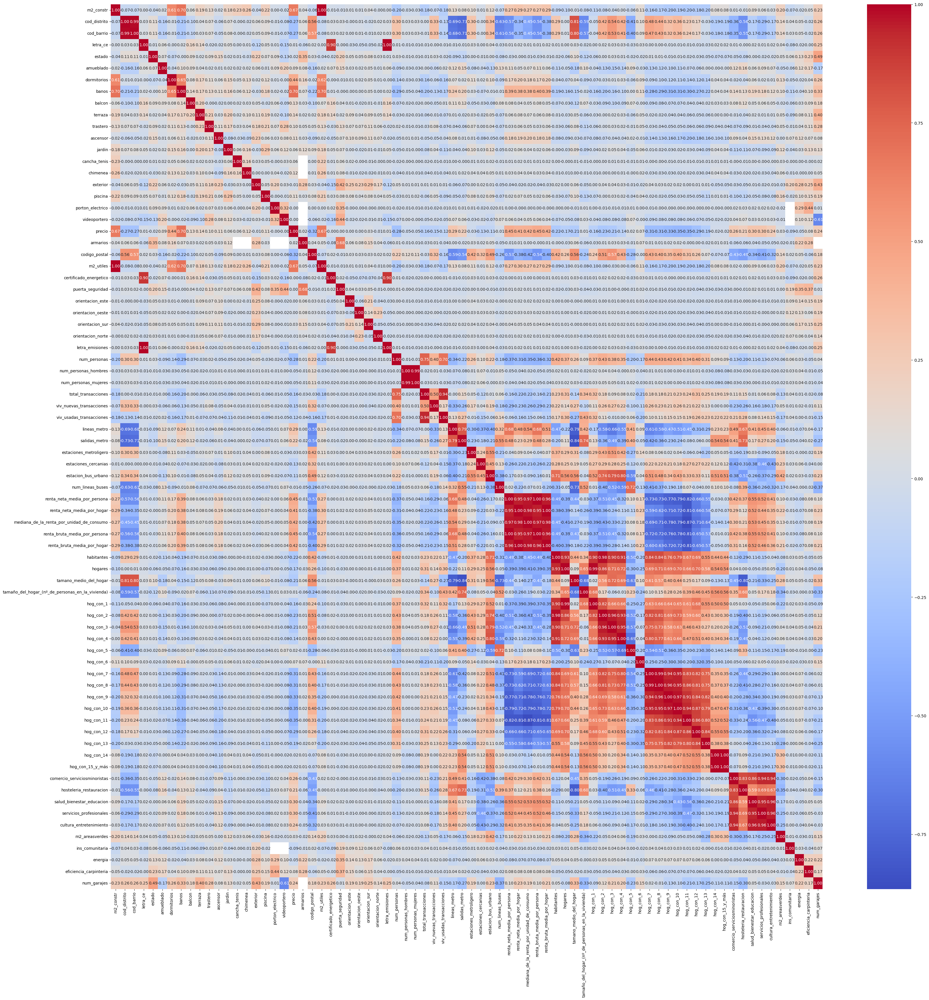

In [205]:
# Calcular la matriz de correlación
correlation_matrix = dfn.corr()

# Graficar el heatmap
plt.figure(figsize=(40, 40))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f",cmap='coolwarm')
plt.show()

En la matriz de correlación, observamos la presencia de algunos puntos rojos. Esto indica que existen variables altamente correlacionadas entre sí, lo que significa que están proporcionando información redundante al modelo. Por lo tanto, procederemos a generar una lista de columnas que se pueden eliminar, ya que otras variables ya representan la misma información de manera efectiva. Este proceso nos ayudará a optimizar el modelo y evitar problemas de multicolinealidad

Creamos un dataset que incluye únicamente las variables numéricas. Luego, analizamos la correlación entre ellas para identificar aquellas que están altamente correlacionadas (con un coeficiente superior al 90%). Posteriormente, eliminamos una de las variables en cada par altamente correlacionado para reducir la multicolinealidad y optimizar el rendimiento del modelo. Este proceso no solo mejora la interpretabilidad, sino que también ayuda a evitar redundancias en los datos

In [206]:
# Establecer un umbral para la correlación (90%)
threshold = 0.90

# Identificar pares de variables con correlación
correlations = []
already_seen = set()

for col in dfcorr.columns:
    for row in dfcorr.index:
        if abs(dfcorr.loc[row, col]) > threshold and col != row:
            pair = tuple(sorted((row, col)))  # Crear pares únicos
            if pair not in already_seen:
                correlations.append((row, col, dfcorr.loc[row, col]))
                already_seen.add(pair)  # Marcar par como ya visto

# Imprimir los resultados
print("Pares de variables con correlación mayor al 90%:")
for var1, var2, corr in correlations:
    print(f"{var1} y {var2}: {corr:.2f}")


Pares de variables con correlación mayor al 90%:
m2_utiles y m2_constr: 0.98
cod_barrio y cod_distrito: 0.99
num_personas_mujeres y num_personas_hombres: 0.99
viv_usadas_transacciones y total_transacciones: 0.94
renta_neta_media_por_hogar y renta_neta_media_por_persona: 0.95
mediana_de_la_renta_por_unidad_de_consumo y renta_neta_media_por_persona: 0.97
renta_bruta_media_por_persona y renta_neta_media_por_persona: 1.00
renta_bruta_media_por_hogar y renta_neta_media_por_persona: 0.96
mediana_de_la_renta_por_unidad_de_consumo y renta_neta_media_por_hogar: 0.98
renta_bruta_media_por_persona y renta_neta_media_por_hogar: 0.95
renta_bruta_media_por_hogar y renta_neta_media_por_hogar: 1.00
renta_bruta_media_por_persona y mediana_de_la_renta_por_unidad_de_consumo: 0.97
renta_bruta_media_por_hogar y mediana_de_la_renta_por_unidad_de_consumo: 0.98
renta_bruta_media_por_hogar y renta_bruta_media_por_persona: 0.96
hogares y habitantes: 0.93
hog_con_2 y habitantes: 0.98
hog_con_3 y habitantes: 0.90

Para determinar qué variable eliminaremos entre las que están correlacionadas, analizaremos la correlación de cada una de ellas con la variable objetivo, ademas tendremos en cuenta el % de nulos que tenia la variable en dataset original. Este enfoque nos permitirá identificar cuál aporta menos información relevante al modelo y, de esa manera, optimizar el conjunto de variables.

In [207]:
dfcorr[['precio']].sort_values(by = 'precio',ascending = False).style.background_gradient()

,precio
precio,1.000000
m2_utiles,0.778172
banos,0.701304
m2_constr,0.671245
renta_bruta_media_por_persona,0.446217
renta_neta_media_por_persona,0.445143
dormitorios,0.440390
renta_bruta_media_por_hogar,0.422353
mediana_de_la_renta_por_unidad_de_consumo,0.418649
renta_neta_media_por_hogar,0.414906


### Análisis de las variables a eliminar

#### Comparaciones entre variables:
- **m2_utiles y m2_constr:**  
  Eliminamos `m2_utiles`, ya que `m2_constr` no tenía valores nulos en el dataset original.

- **cod_barrio y cod_distrito:**  
  De momento mantenemos las dos, lnecesitaremos ambas varaibles en para realizar la imputación de nulos.
  
- **num_personas_mujeres y num_personas_hombres:**  
  Nos quedamos con `num_personas_hombres`, ya que está más correlacionada con la variable target.

- **viv_usadas_transacciones y total_transacciones:**  
  Nos quedamos con `total_transacciones`, ya que está más correlacionada con la variable target.

---

#### Bloque de variables relacionadas con la renta:
- **Variables analizadas:**  
  `renta_neta_media_por_persona`, `renta_neta_media_por_hogar`, `mediana_de_la_renta_por_unidad_de_consumo`, `renta_bruta_media_por_persona`, `renta_bruta_media_por_hogar`

- **Decisión:**  
  Nos quedamos con `renta_bruta_media_por_persona`, ya que es la variable más correlacionada con el precio.

---

#### Bloque de variables relacionadas con los hogares:
- **Variables analizadas:**  
  `habitantes`, `hogares`, `hog_con_1`, `hog_con_2`, `hog_con_3`, `hog_con_4`, `hog_con_5`, `hog_con_6`,  
  `hog_con_7`, `hog_con_8`, `hog_con_9`, `hog_con_10`, `hog_con_11`, `hog_con_12`, `hog_con_13`, `hog_con_14`, `hog_con_15_y_más`

- **Decisión:**  
  Nos quedamos con las columnas `habitantes`, `hog_con_10` y `hog_con_15_y_más`.

#### Bloque de variables relacionadas con servicios deen el barrio:
- **Variables analizadas:** 
 `servicios_profesionales `, `comercio_serviciosminoristas `, `cultura_entretenimiento `,  `salud_bienestar_educacion `

 - **Decisión:**  
  Nos quedamos con las todas las columnas, se creará una columna como suma de las cuatro.


In [208]:

# Lista de variables a eliminar
cols_eliminar = ['m2_utiles', 'num_personas_mujeres', 'viv_usadas_transacciones', 'renta_neta_media_por_persona', 
    'renta_neta_media_por_hogar', 'mediana_de_la_renta_por_unidad_de_consumo', 'renta_bruta_media_por_hogar', 
    'hogares', 'hog_con_1', 'hog_con_2', 'hog_con_3',  'hog_con_4', 'hog_con_5',  'hog_con_6',    'hog_con_7', 'hog_con_8', 
    'hog_con_9', 'hog_con_11', 'hog_con_12', 'hog_con_13',  'hog_con_14']

# Eliminar las variables del DataFrame
dfEDA = dfEDA.drop(columns=cols_eliminar)

print("Variables eliminadas correctamente. El nuevo DataFrame tiene estas columnas:")
print(dfEDA.columns)


Variables eliminadas correctamente. El nuevo DataFrame tiene estas columnas:
Index(['url', 'm2_constr', 'distrito', 'cod_distrito', 'barrio', 'cod_barrio',
       'letra_ce', 'tipologia', 'estado', 'amueblado', 'planta', 'dormitorios',
       'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'antiguedad',
       'jardin', 'tipo_inmueble', 'cancha_tenis', 'chimenea', 'exterior',
       'piscina', 'porton_electrico', 'videoportero', 'precio', 'web',
       'armarios', 'codigo_postal', 'tipo_suelo', 'certificado_energetico',
       'puerta_seguridad', 'orientacion_este', 'orientacion_oeste',
       'orientacion_sur', 'clasificacion_aire', 'grupo_cocina',
       'orientacion_norte', 'letra_emisiones', 'num_personas',
       'num_personas_hombres', 'total_transacciones',
       'viv_nuevas_transacciones', 'lineas_metro', 'salidas_metro',
       'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano',
       'num_lineas_buses', 'renta_bruta_media_por_persona', 'habitantes

# *10. Division entre train y test*

## *_10.1. Agrupación viviendas por precio promedio barrio_*

In [209]:
print(f"El DataFrame dfEDA tiene {dfEDA.shape[0]} filas y {dfEDA.shape[1]} columnas.")

El DataFrame dfEDA tiene 9870 filas y 66 columnas.


In [ ]:
# Calcular el precio promedio por barrio
codbarrio_precios = dfEDA.groupby('cod_barrio')['precio'].mean().reset_index()

# Clasificar los códigos de barrio en cinco grupos y obtener los límites de los intervalos
codbarrio_precios['cod_barrio_group'], bins = pd.qcut(
    codbarrio_precios['precio'], q=5, labels=[1, 2, 3, 4,5], retbins=True)

# Crear un diccionario de mapeo para asignar grupos a cada barrio en el DataFrame original
cod_barrio_mapping = dict(zip(codbarrio_precios['cod_barrio'], codbarrio_precios['cod_barrio_group']))
dfEDA['cod_barrio_group'] = dfEDA['cod_barrio'].map(cod_barrio_mapping)

# Contar viviendas por grupo
cod_barrio_group_counts = dfEDA["cod_barrio_group"].value_counts(dropna=False).sort_index()

# Descripciones de los grupos con rangos de precios
descriptions = {
    1: "las más baratas entre todas las categorías",
    2: "con precios moderadamente bajos en relación con los demás grupos",
    3: "con un rango de precios similar a las del Grupo 4",
    4: "más costosas que las del Grupo 3, pero similares",  
    6: "las viviendas más caras en el conjunto de datos"
}

# Mostrar la descripción de cada grupo con su rango de precios
for i, (group, count) in enumerate(cod_barrio_group_counts.items()):
    lower_bound = bins[i]  # Límite inferior del grupo
    upper_bound = bins[i + 1]  # Límite superior del grupo
    print(
        f"Grupo {group}: Este grupo contiene {count} viviendas. "
        f"Rango de precios: {lower_bound:.2f} - {upper_bound:.2f}. "
        f"Estas viviendas son {descriptions.get(group, 'una descripción no especificada.')}"
    )


Grupo 1: Este grupo contiene 1602 viviendas. Rango de precios: 111940.91 - 232568.00. Estas viviendas son las más baratas entre todas las categorías
Grupo 2: Este grupo contiene 1206 viviendas. Rango de precios: 232568.00 - 334194.44. Estas viviendas son con precios moderadamente bajos en relación con los demás grupos
Grupo 3: Este grupo contiene 1322 viviendas. Rango de precios: 334194.44 - 590108.70. Estas viviendas son con un rango de precios similar a las del Grupo 4
Grupo 4: Este grupo contiene 2149 viviendas. Rango de precios: 590108.70 - 937714.29. Estas viviendas son más costosas que las del Grupo 3, pero similares
Grupo 5: Este grupo contiene 3591 viviendas. Rango de precios: 937714.29 - 3109250.00. Estas viviendas son una descripción no especificada.


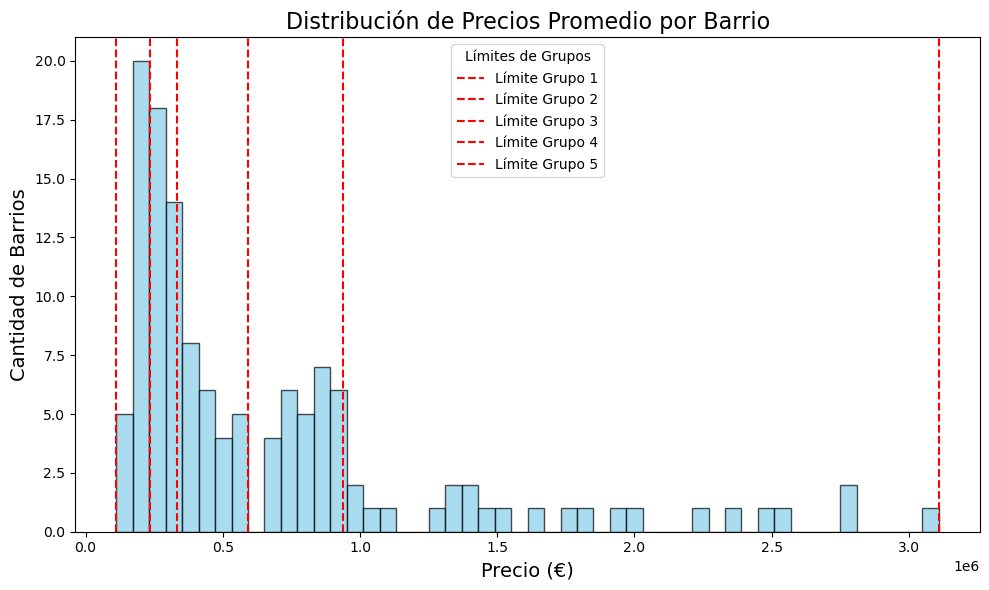

In [211]:
# Histograma de precios
plt.figure(figsize=(10, 6))
plt.hist(codbarrio_precios['precio'], bins=50, color='skyblue', edgecolor='black', alpha=0.7)
plt.title('Distribución de Precios Promedio por Barrio', fontsize=16)
plt.xlabel('Precio (€)', fontsize=14)
plt.ylabel('Cantidad de Barrios', fontsize=14)

# Añadir límites de los grupos
for i, b in enumerate(bins):
    plt.axvline(x=b, color='red', linestyle='--', label=f'Límite Grupo {i+1}' if i < len(bins)-1 else None)

# Leyenda y visualización
plt.legend(title='Límites de Grupos', fontsize=10)
plt.tight_layout()
plt.show()


<Figure size 2000x1400 with 0 Axes>

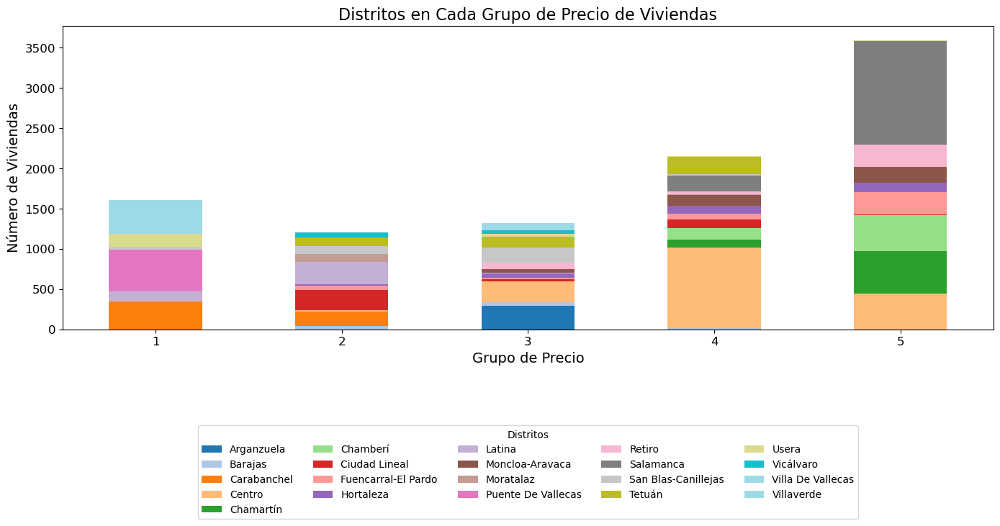

In [212]:
# Crear una tabla cruzada de grupos y barrios
cross_tab = pd.crosstab(dfEDA['cod_barrio_group'], dfEDA['distrito'])

# Crear el gráfico de barras apiladas
plt.figure(figsize=(20, 14))
cross_tab.plot(kind='bar', stacked=True, figsize=(14, 8), colormap='tab20')

# Etiquetas y título del gráfico
plt.title('Distritos en Cada Grupo de Precio de Viviendas', fontsize=16)
plt.xlabel('Grupo de Precio', fontsize=14)
plt.ylabel('Número de Viviendas', fontsize=14)
plt.xticks(fontsize=12, rotation=0)
plt.yticks(fontsize=12)
plt.legend(
    title='Distritos',
    bbox_to_anchor=(0.5, -0.3),  # Centrado horizontalmente debajo del gráfico
    loc='upper center',  # Colocar en el centro superior de la caja especificada por bbox_to_anchor
    fontsize=10,
    ncol=5  # Organizar en múltiples columnas según el número de elementos
)
plt.tight_layout()


# Mostrar el gráfico
plt.show()


En el grafico se aprecia que las viviendas del distrito de Salmanca estan entre el grupo 4 y 5, y el grupo 1 está formado por viviendas de los barrios de Puente de Vallecas, Carabanchel Villaverde y Villa de Vallecas fundamentalmente.

10.2 Division entre train ,validacion y test

In [213]:
#Incluyo la columna url para crear df_ids para almacenar los identificadores de lcada vivienda
dfM=dfEDA
print(dfM['cod_barrio_group'].value_counts())

cod_barrio_group
5    3591
4    2149
1    1602
3    1322
2    1206
Name: count, dtype: int64


In [214]:
# Dividir las columnas objetivo y características
#y = dfbaseline['cod_barrio_group'].values  # Asegúrate de usar la columna correcta para 'cod_barrio_group'
y = dfM['precio'].values  # Asegúrate de usar la columna correcta para 'cod_barrio_group'
#X = dfM.drop(columns=['cod_barrio_group', 'url'])
df_ids = dfM[['url']]
#X = dfM.drop(columns=['url','precio'])
X = dfM.drop(columns=['precio'])
# Primera clasificación entre train y test, estratificando por 'cod_barrio_group'
X_train, X_test, y_train, y_test, ids_train, ids_test = train_test_split(X, y, df_ids, test_size=0.2, random_state=42, stratify=X['cod_barrio_group'], shuffle=True
)

#Realizo otra division para modelos en los que necesite soo dividir entre train y test
# Primera clasificación entre train y test, estratificando por 'cod_barrio_group'
X_train1, X_test1, y_train1, y_test1, ids_train1, ids_test1 = train_test_split(X, y, df_ids, test_size=0.2, random_state=42, stratify=X['cod_barrio_group'], shuffle=True
)

# Verificar la distribución de las clases en train y test
print("Distribución en el conjunto de entrenamiento:")
#print(y_train.value_counts())

print(pd.Series(y_train).value_counts())
print("Distribución en el conjunto de test:")
#print(y_test.value_counts())
print(pd.Series(y_test).value_counts())

# Segunda división: Train y Validación a partir de X_train, estratificando también
X_train, X_val, y_train, y_val = train_test_split(
    X_train, y_train, test_size=0.2, random_state=42, stratify=X_train['cod_barrio_group'], shuffle=True
)

# Verificar la distribución de las clases en train y validación
print("Distribución en el conjunto de validación:")

print(pd.Series(y_val).value_counts())
# Número de registros del dataset de train, test y validación
print("Número de observaciones")
print("- Train: ", X_train.shape[0])
print("- Test:  ", X_test.shape[0])
print("- Val:   ", X_val.shape[0])

# Resetear los índices para cada conjunto
dftrain = X_train
dftest = X_test
dfval = X_val

# Resetear los índices para cada conjunto
dftrain1 = X_train1
dftest1 = X_test1

# # Resetear los índices para cada conjunto
# dftrain = X_train.reset_index(drop=True)
# dftest = X_test.reset_index(drop=True)
# dfval = X_val.reset_index(drop=True)

# # Resetear los índices para cada conjunto
# dftrain1 = X_train1.reset_index(drop=True)
# dftest1 = X_test1.reset_index(drop=True)



Distribución en el conjunto de entrenamiento:
230000.00     52
220000.00     50
350000.00     50
240000.00     50
280000.00     48
              ..
1725000.00     1
409990.00      1
256910.00      1
92260.00       1
2449000.00     1
Name: count, Length: 1439, dtype: int64
Distribución en el conjunto de test:
155000.00     17
330000.00     16
850000.00     15
950000.00     14
1200000.00    14
              ..
70256.00       1
346900.00      1
797000.00      1
318900.00      1
267000.00      1
Name: count, Length: 743, dtype: int64
Distribución en el conjunto de validación:
225000.00     15
1200000.00    14
2500000.00    13
950000.00     13
350000.00     11
              ..
173630.00      1
785000.00      1
286000.00      1
224000.00      1
4800000.00     1
Name: count, Length: 662, dtype: int64
Número de observaciones
- Train:  6316
- Test:   1974
- Val:    1580


Comprobamos que entrenameros con viviendas de los 131 barriode de Madrid

In [215]:
X_train['cod_barrio'].nunique(),X_train1['cod_barrio'].nunique()

(131, 131)

# *11. Feature Engineering*

## *11.1 Variables pendientes de imputar nulos*

In [216]:
# Función `columnas_por_tipo` que muestra un resumen de los tipo de columnas que hay en el dataframe
boolean_columns, cols_num, cat_columns,object_columns,other_columns,num_nobool, cols_noboolean = columnas_por_tipo(X_train)

Número de columnas de tipo entero: 12
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'exterior', 'piscina', 'letra_emisiones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria', 'cod_barrio_group']
------------------------------------------------------
Número de columnas de tipo float: 43
Columnas de tipo float: ['m2_constr', 'amueblado', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'armarios', 'codigo_postal', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_personas_hombres', 'total_transacciones', 'viv_nuevas_transacciones', 'lineas_metro', 'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano', 'num_lineas_buses', 'renta_bruta_media_por_persona', 'habitantes', 'tamano_medio_del_hogar', 'tamaño_del_hogar_(nº_de_personas_


#### * 11.1.1 Imputacion de nulos con la moda por barrio en variables booleanas *

In [217]:
[col for col in boolean_columns if dfEDA[col].isna().any()]

['ascensor', 'porton_electrico', 'videoportero', 'puerta_seguridad']

In [218]:

modas_por_barrio_bol = calcular_estadistico_por_col(X_train, 'cod_barrio', boolean_columns, 'mode')
modas_por_barrio_bol1 = calcular_estadistico_por_col(X_train1, 'cod_barrio', boolean_columns, 'mode')

modas_por_distrito_bol = calcular_estadistico_por_col(X_train, 'cod_distrito', boolean_columns, 'mode')
modas_por_distrito_bol1 = calcular_estadistico_por_col(X_train1, 'cod_distrito', boolean_columns, 'mode')


media_por_distrito_bol = calcular_estadistico_por_col(X_train, 'cod_distrito', boolean_columns, 'mean')
media_por_distrito_bol1 = calcular_estadistico_por_col(X_train1, 'cod_distrito', boolean_columns, 'mean')

# Imputar valores nulos con la moda por barrio en  X_train, X_val y X_test
X_train_imputado = imputar_valores(X_train, modas_por_barrio_bol, 'cod_barrio')
X_val_imputado = imputar_valores(X_val, modas_por_barrio_bol, 'cod_barrio')
X_test_imputado = imputar_valores(X_test, modas_por_barrio_bol, 'cod_barrio')
X_train1_imputado = imputar_valores(X_train1, modas_por_barrio_bol1, 'cod_barrio')

X_test1_imputado = imputar_valores(X_test1, modas_por_barrio_bol1, 'cod_barrio')




In [219]:
#comprobamos una de las columnas
X_train_imputado["ascensor"].value_counts(dropna=False)

ascensor
1.00    5931
0.00     371
NaN       14
Name: count, dtype: int64

In [220]:
#itlizando la moda por barrio quedan nulos por que hay barrios que todos los valores son nan, aplico la moda del distrito
X_train_imputado = imputar_valores(X_train, modas_por_distrito_bol, 'cod_distrito')
X_val_imputado = imputar_valores(X_val, modas_por_distrito_bol, 'cod_distrito')
X_test_imputado = imputar_valores(X_test, modas_por_distrito_bol, 'cod_distrito')
X_train1_imputado = imputar_valores(X_train1, modas_por_distrito_bol1, 'cod_distrito')
X_test1_imputado = imputar_valores(X_test1, modas_por_distrito_bol1, 'cod_distrito')

#Igualamos X_train_imputado  a X_train

In [221]:
X_train =X_train_imputado 
X_val =X_val_imputado 
X_test =X_test_imputado 
X_train1 =X_train1_imputado 
X_test1 =X_test_imputado 

In [222]:
modas_por_barrio_bol.keys()

dict_keys(['balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte'])

In [223]:
valores_ascensor = modas_por_barrio_bol.get("ascensor")
print(valores_ascensor)

{11: 1.0, 12: 1.0, 13: 1.0, 14: 1.0, 15: 1.0, 16: 1.0, 21: 1.0, 22: 1.0, 23: 1.0, 24: 1.0, 25: 1.0, 26: 1.0, 27: 1.0, 31: 1.0, 32: 1.0, 33: 1.0, 34: 1.0, 35: 1.0, 36: 1.0, 41: 1.0, 42: 1.0, 43: 1.0, 44: 1.0, 45: 1.0, 46: 1.0, 51: 1.0, 52: 1.0, 53: 1.0, 54: 1.0, 55: 1.0, 56: 1.0, 61: 1.0, 62: 1.0, 63: 1.0, 64: 1.0, 65: 1.0, 66: 0.0, 71: 1.0, 72: 1.0, 73: 1.0, 74: 1.0, 75: 1.0, 76: 1.0, 81: 1.0, 82: 1.0, 83: 1.0, 84: 1.0, 85: 1.0, 86: 0.0, 87: 1.0, 88: nan, 91: 1.0, 92: 1.0, 93: 1.0, 94: 1.0, 95: 1.0, 96: 0.0, 97: 1.0, 101: 1.0, 102: 1.0, 103: 1.0, 104: 1.0, 105: 0.0, 106: 1.0, 107: 1.0, 111: 1.0, 112: 1.0, 113: 1.0, 114: 1.0, 115: 1.0, 116: 1.0, 117: 1.0, 121: 1.0, 122: 1.0, 123: 1.0, 124: 1.0, 125: 0.0, 126: 1.0, 127: 1.0, 131: 1.0, 132: 1.0, 133: 1.0, 134: 1.0, 135: 1.0, 136: 1.0, 141: 1.0, 142: 1.0, 143: 1.0, 144: 1.0, 145: 1.0, 146: 1.0, 151: 1.0, 152: 1.0, 153: 1.0, 154: 1.0, 155: 1.0, 156: 1.0, 157: 1.0, 158: 1.0, 159: 1.0, 161: 1.0, 162: 1.0, 163: 1.0, 164: 1.0, 165: 1.0, 166: 1.

In [224]:
#Comprobamos que no tenemos nulos en varibles binarias
[col for col in X_train_imputado.columns if X_train_imputado[col].isnull().sum() > 0]

['planta', 'dormitorios', 'banos', 'armarios', 'num_garajes']

#### * 11.2.1 Imputacion de nulos con la mediana de grupos de m2_constr y barrio s *


Las variables numericas vamos a imputar nulos teniendo en cuenta dos agrupaciones,  barrio y cod_barrio_m2_contr

* Planta: Mediana por barrio y tipologia
* banos: Mediana por barrio y cod_barrio_m2_contr
* dormitorios : Mediana por barrio y cod_barrio_m2_contr

Llamamos a la funcion clasificar_barrios_por_m2 para crear en los conjuntos de train la agrupación de m2_constr y barrio

In [225]:

# Clasificación en X_train y obtener los límites de corte
X_train, bins_xtrain = clasificar_barrios_por_m2(X_train, num_grupos=5)
X_train1, bins_xtrain1 = clasificar_barrios_por_m2(X_train1, num_grupos=5)


Clasificación de barrios según m2_constr:
Grupo 1: 979 viviendas, rango de m2_constr: 52.17 - 78.66
Grupo 2: 1009 viviendas, rango de m2_constr: 78.66 - 91.91
Grupo 3: 1141 viviendas, rango de m2_constr: 91.91 - 125.23
Grupo 4: 1709 viviendas, rango de m2_constr: 125.23 - 175.33
Grupo 5: 1478 viviendas, rango de m2_constr: 175.33 - 1002.67

Clasificación de barrios según m2_constr:
Grupo 1: 1170 viviendas, rango de m2_constr: 52.62 - 79.11
Grupo 2: 1279 viviendas, rango de m2_constr: 79.11 - 91.76
Grupo 3: 1477 viviendas, rango de m2_constr: 91.76 - 124.80
Grupo 4: 2129 viviendas, rango de m2_constr: 124.80 - 158.44
Grupo 5: 1841 viviendas, rango de m2_constr: 158.44 - 944.00


Aplicamos la clasificación realizada en X_train a los conjuntos de datos de validación y test

In [226]:
# Aplicar clasificación en X_val y X_test
X_val = aplicar_clasificacion(X_val, bins_xtrain )
X_test = aplicar_clasificacion(X_test, bins_xtrain )
X_test1 = aplicar_clasificacion(X_test1, bins_xtrain1)

In [227]:

X_train['cod_barrio'].unique()



array([ 11,  87,  46,  12, 157,  41,  16,  25, 107,  15, 124,  14, 153,
        43, 166,  42,  74,  45,  54, 206,  32, 133,  64, 102,  97,  61,
        92,  65, 115,  22, 104,  83, 201,  55,  51,  24,  76, 134, 183,
        62, 151,  35, 152,  73, 136,  75,  93, 117, 182,  44, 161,  53,
       205, 135,  94, 103,  13, 171, 122,  63, 175, 116,  71,  66,  84,
        81, 114, 156,  33,  96, 145, 194,  31,  23, 131, 213, 155, 207,
        36,  26, 181,  52,  34, 112, 127, 208, 165,  86, 113, 174, 159,
       101,  21, 214,  82, 125, 132, 163, 121, 154, 202,  95, 172,  72,
       106,  56, 204,  91, 215, 191,  27, 162, 146, 141, 142, 105, 173,
       211, 123, 126, 212, 164, 111, 143, 192, 144, 203,  85, 158, 193,
        88], dtype=int64)

11.2.1.1 Baños y dormitorios

In [228]:
X_train['banos'].value_counts(dropna=False)

banos
1.00     2492
2.00     1989
3.00      817
5.00      434
NaN       269
4.00      233
6.00       45
7.00       18
8.00        6
10.00       4
9.00        4
11.00       3
12.00       2
Name: count, dtype: int64

In [229]:
X_train['dormitorios'].value_counts(dropna=False)

dormitorios
3.00     2127
2.00     1729
4.00      873
1.00      829
5.00      312
6.00      119
NaN       107
0.00       94
7.00       64
8.00       24
9.00       14
10.00       9
11.00       6
12.00       4
15.00       2
20.00       1
24.00       1
13.00       1
Name: count, dtype: int64

In [230]:
cols=["dormitorios","banos","armarios"]
cols_agr=["cod_barrio",'cod_barrio_m2_contr']
cols_agr2=["cod_distrito",'cod_barrio_m2_contr']

modas_por_barrio = calcular_est_por_cols(X_train, cols_agr, cols, 'mode')
modas_por_barrio1 = calcular_est_por_cols(X_train1, cols_agr, cols, 'mode')

modas_por_distrito = calcular_est_por_cols(X_train, cols_agr, cols, 'mode')
modas_por_distrito1 = calcular_est_por_cols(X_train1, cols_agr, cols, 'mode')

median_por_barrio = calcular_est_por_cols(X_train, cols_agr, cols, 'median')
median_por_barrio1 = calcular_est_por_cols(X_train1, cols_agr, cols, 'median')

median_por_distrito = calcular_est_por_cols(X_train, cols_agr2, cols, 'median')
median_por_distrito1 = calcular_est_por_cols(X_train1, cols_agr2, cols, 'median')

media_por_distrito = calcular_est_por_cols(X_train, cols_agr2, cols, 'mean')
media_por_distrito1 = calcular_est_por_cols(X_train1, cols_agr2, cols, 'mean')





In [231]:
# Imputar valores nulos con la moda por barrio en  X_train, X_val y X_test
X_train_imputado = imputar_cols_valores(X_train, median_por_barrio, cols_agr)
X_val_imputado = imputar_cols_valores(X_val, median_por_barrio, cols_agr)
X_test_imputado = imputar_cols_valores(X_test, median_por_barrio, cols_agr)
X_train1_imputado = imputar_cols_valores(X_train1, median_por_barrio1, cols_agr)
X_test1_imputado = imputar_cols_valores(X_test1, median_por_barrio1, cols_agr)

In [232]:
# Imputar valores nulos con la moda por distito en  X_train, X_val y X_test
X_train_imputado = imputar_cols_valores(X_train, median_por_distrito, cols_agr)
X_val_imputado = imputar_cols_valores(X_val, median_por_distrito, cols_agr)
X_test_imputado = imputar_cols_valores(X_test, median_por_distrito, cols_agr)
X_train1_imputado = imputar_cols_valores(X_train1, median_por_distrito1, cols_agr)
X_test1_imputado = imputar_cols_valores(X_test1, median_por_distrito1, cols_agr)

Comprobación en los nulos de baño, del barrio de Embajadores, doc_barrio=12

In [233]:
dfEDA.query("banos.isnull() and m2_constr==32")[["m2_constr","barrio","distrito"]]

,m2_constr,barrio,distrito
107,32.00,Embajadores,Centro
1869,32.00,Palomeras Bajas,Puente De Vallecas
4375,32.00,Ríos Rosas,Chamberí


In [234]:

X_train_imputado.query(" m2_constr==32 & barrio=='Embajadores'")[["banos","distrito","m2_constr","barrio","cod_barrio_m2_contr"]]

,banos,distrito,m2_constr,barrio,cod_barrio_m2_contr
2162,1.00,Centro,32.00,Embajadores,1
107,1.00,Centro,32.00,Embajadores,1
2943,1.00,Centro,32.00,Embajadores,1
1961,1.00,Centro,32.00,Embajadores,1


In [235]:
print(f"Porcentaje de valores nulos en la columna 'banos': {(X_train_imputado['banos'].isna().sum() / len(X_train_imputado) * 100):.2f}%")
print(f"Porcentaje de valores nulos en la columna 'dormitorios': {(X_train_imputado['dormitorios'].isna().sum() / len(X_train_imputado) * 100):.2f}%")
print(f"Porcentaje de valores nulos en la columna 'armarios': {(X_train_imputado['armarios'].isna().sum() / len(X_train_imputado) * 100):.2f}%")

Porcentaje de valores nulos en la columna 'banos': 3.82%
Porcentaje de valores nulos en la columna 'dormitorios': 1.47%
Porcentaje de valores nulos en la columna 'armarios': 78.91%


In [236]:
# hay que tener en cuenta que puede ocurrir que no tenga valores por estas agrupaciones, si es asi se toma la mediana de todo el dataset
X_train_imputado, mediana_dict = imputar_col_con_mediana(X_train, cols)
X_train1_imputado, mediana_dict1 = imputar_col_con_mediana(X_train1, cols)

X_val_imputado, _ = imputar_col_con_mediana(X_val, cols, mediana_dict)
X_test_imputado, _ = imputar_col_con_mediana(X_test, cols, mediana_dict)
X_test1_imputado, _ = imputar_col_con_mediana(X_test1, cols, mediana_dict1)

In [237]:
#Eliminamos la columna cod_barrio_m2_contr creada para la imputacion de nulos

In [238]:
X_train_imputado=X_train_imputado.drop(columns="cod_barrio_m2_contr")
X_test_imputado=X_test_imputado.drop(columns="cod_barrio_m2_contr")
X_test1_imputado=X_test1_imputado.drop(columns="cod_barrio_m2_contr")
X_train1_imputado=X_train1_imputado.drop(columns="cod_barrio_m2_contr")
X_val_imputado=X_val_imputado.drop(columns="cod_barrio_m2_contr")

In [239]:
X_train =X_train_imputado 
X_val =X_val_imputado 
X_test =X_test_imputado 
X_train1 =X_train1_imputado 
X_test1 =X_test_imputado 

11.2.1.2 Planta

In [240]:
X_train['planta'].value_counts(dropna=False)

planta
 NaN     2575
 1        791
 2        514
 3        474
 0        470
 4        353
 5        206
 6        196
 0        129
 2.0       83
 1.0       81
 7         79
 3.0       66
 4.0       53
0.50       42
 8         37
 9         34
 5.0       33
 6.0       25
 10        12
 7.0       11
 11         8
 3          7
 13         7
 8.0        5
 14         3
 -1         3
 12         3
 22         3
 -1         2
 15         2
-0.50       2
 0.0        2
 9.0        1
 27         1
 16         1
 10.0       1
 18         1
Name: count, dtype: int64

In [241]:
# Convertir la columna 'planta' a valores numéricos (reemplaza no numéricos con NaN)
X_train['planta'] = pd.to_numeric(X_train['planta'], errors='coerce')
X_train1['planta'] = pd.to_numeric(X_train1['planta'], errors='coerce')

In [242]:
max_planta_barrio = X_train[X_train['cod_barrio'].notnull() & X_train['planta'].notnull()].groupby('cod_barrio')['planta'].max().astype(int)
max_planta_distrito = X_train[X_train['cod_distrito'].notnull() & X_train['planta'].notnull()].groupby('cod_distrito')['planta'].max().astype(int)

max_planta_barrio1 = X_train1[X_train1['cod_barrio'].notnull() & X_train['planta'].notnull()].groupby('cod_barrio')['planta'].max().astype(int)
max_planta_distrito1 = X_train1[X_train1['cod_distrito'].notnull() & X_train['planta'].notnull()].groupby('cod_distrito')['planta'].max().astype(int)

# Convertir el resultado a un diccionario
max_planta_barrio_dict = max_planta_barrio.to_dict()
max_planta_distrito_dict = max_planta_distrito.to_dict()

max_planta_barrio_dict1 = max_planta_barrio1.to_dict()
max_planta_distrito_dict1 = max_planta_distrito1.to_dict()

In [243]:
def imputar_planta_por_barrio(df, max_planta_barrio_dict,tipologia):
    """
    Imputa los valores nulos en la columna 'planta' de un DataFrame para las filas donde la tipología es 'Atico',
    usando los valores máximos de planta por barrio provenientes de un diccionario.

    Args:
        df: DataFrame con los datos a imputar.
        max_planta_barrio_dict: Diccionario con los máximos de planta por barrio.
    
    Returns:
        DataFrame con los valores imputados en la columna 'planta'.
    """
    df['planta'] = df.apply(
        lambda row: max_planta_barrio_dict.get(row['cod_barrio'], row['planta']) 
        if row['tipologia'] == tipologia and pd.isnull(row['planta']) 
        else row['planta'],
        axis=1
    )
    return df




In [244]:
# Uso de la función
X_train = imputar_planta_por_barrio(X_train, max_planta_barrio_dict,'Atico')
X_test = imputar_planta_por_barrio(X_test, max_planta_barrio_dict,'Atico')
X_val = imputar_planta_por_barrio(X_val, max_planta_barrio_dict,'Atico')
X_train1 = imputar_planta_por_barrio(X_train1, max_planta_barrio_dict1,'Atico')
X_test1 = imputar_planta_por_barrio(X_test1, max_planta_barrio_dict1,'Atico')

In [245]:
X_train =X_train_imputado 
X_val =X_val_imputado 
X_test =X_test_imputado 
X_train1 =X_train1_imputado 
X_test1 =X_test_imputado 

Ahora imputo los nulos de planta del resto de tipologias diferentes a Atico

In [246]:
lista = dfEDA['tipologia'].unique()
tipol_NoAticos = [tipologia for tipologia in lista if tipologia != 'Atico']

In [247]:
tipol_NoAticos

['Piso', 'Chalet', 'Casa', 'Duplex', 'Estudio']

In [248]:
X_train.query("planta.isnull()").count()

url                                                 2451
m2_constr                                           2451
distrito                                            2451
cod_distrito                                        2451
barrio                                              2451
cod_barrio                                          2451
letra_ce                                            2451
tipologia                                           2451
estado                                              2451
amueblado                                           2451
planta                                                 0
dormitorios                                         2451
banos                                               2451
balcon                                              2451
terraza                                             2451
trastero                                            2451
ascensor                                            2451
antiguedad                     

In [249]:
cols=["planta"]
cols_agr=["cod_barrio",'tipologia']
cols_agr2=["cod_distrito",'tipologia']
#filtro el dataframe X_Train y X_train1 para que no contenga los aticos


X_train_filtrado = X_train.loc[X_train['tipologia'].isin(tipol_NoAticos)]
X_train_filtrado1 = X_train1.loc[X_train1['tipologia'].isin(tipol_NoAticos)]


modas_por_barrio_bol = calcular_est_por_cols(X_train_filtrado, cols_agr, cols, 'mode')
modas_por_barrio_bol1 = calcular_est_por_cols(X_train_filtrado1, cols_agr, cols, 'mode')

modas_por_distrito_bol = calcular_est_por_cols(X_train_filtrado, cols_agr, cols, 'mode')
modas_por_distrito_bol1 = calcular_est_por_cols(X_train_filtrado1, cols_agr, cols, 'mode')

median_por_barrio_bol = calcular_est_por_cols(X_train_filtrado, cols_agr, cols, 'median')
median_por_barrio_bol1 = calcular_est_por_cols(X_train_filtrado1, cols_agr, cols, 'median')

median_por_distrito_bol = calcular_est_por_cols(X_train_filtrado, cols_agr2, cols, 'median')
median_por_distrito_bol1 = calcular_est_por_cols(X_train_filtrado1, cols_agr2, cols, 'median')

media_por_distrito_bol = calcular_est_por_cols(X_train_filtrado, cols_agr2, cols, 'mean')
media_por_distrito_bol1 = calcular_est_por_cols(X_train_filtrado1, cols_agr2, cols, 'mean')



In [250]:
# Imputar valores nulos con la moda por barrio en  X_train_filtrado, X_val y X_test
X_train_imputado = imputar_cols_valores(X_train, median_por_barrio_bol, cols_agr)
X_val_imputado = imputar_cols_valores(X_val, median_por_barrio_bol, cols_agr)
X_test_imputado = imputar_cols_valores(X_test, median_por_barrio_bol, cols_agr)
X_train1_imputado = imputar_cols_valores(X_train1, median_por_barrio_bol1, cols_agr)
X_test1_imputado = imputar_cols_valores(X_test1, median_por_barrio_bol1, cols_agr)

La mediana por barrio se quedará vacio si hay algun barrio que no tenga ningun valor de planta

In [251]:
# Imputar valores nulos con la moda por barrio en  X_train_filtrado, X_val y X_test
X_train_imputado = imputar_cols_valores(X_train, median_por_distrito_bol, cols_agr2)
X_val_imputado = imputar_cols_valores(X_val, median_por_distrito_bol, cols_agr2)
X_test_imputado = imputar_cols_valores(X_test, median_por_distrito_bol, cols_agr2)
X_train1_imputado = imputar_cols_valores(X_train1, median_por_distrito_bol1, cols_agr2)
X_test1_imputado = imputar_cols_valores(X_test1, median_por_distrito_bol1, cols_agr2)

In [252]:
X_train_imputado.query("planta.isnull()").count()

url                                                 11
m2_constr                                           11
distrito                                            11
cod_distrito                                        11
barrio                                              11
cod_barrio                                          11
letra_ce                                            11
tipologia                                           11
estado                                              11
amueblado                                           11
planta                                               0
dormitorios                                         11
banos                                               11
balcon                                              11
terraza                                             11
trastero                                            11
ascensor                                            11
antiguedad                                          11
jardin    

In [253]:
# Si despues de agrupar la mediana por tipologia y distrito sigue habiendo nulos, aplico la planta 2 a todos los nulos


In [254]:
X_train_imputado.loc[X_train_imputado['planta'].isnull(), 'planta'] = 2
X_val_imputado.loc[X_val_imputado['planta'].isnull(), 'planta'] = 2
X_test_imputado.loc[X_test_imputado['planta'].isnull(), 'planta'] = 2
X_train1_imputado.loc[X_train1_imputado['planta'].isnull(), 'planta'] = 2
X_test1_imputado.loc[X_test1_imputado['planta'].isnull(), 'planta'] = 2

In [255]:
print(f"Porcentaje de valores nulos en la columna 'planta': {(X_train_imputado['banos'].isna().sum() / len(X_train_imputado) * 100):.2f}%")


Porcentaje de valores nulos en la columna 'planta': 0.00%


In [256]:
#convertimos a entero el valor de planta
# Convertir la columna 'planta' a valores numéricos (reemplaza no numéricos con NaN)
X_train_imputado['planta'] = X_train_imputado['planta'].astype(float)
X_val_imputado['planta'] = X_val_imputado['planta'].astype(float)
X_test_imputado['planta'] = X_test_imputado['planta'].astype(float)
X_test1_imputado['planta'] = X_test1_imputado['planta'].astype(float)
X_train1_imputado['planta'] = X_train1_imputado['planta'].astype(float)


In [257]:
X_train =X_train_imputado 
X_val =X_val_imputado 
X_test =X_test_imputado 
X_train1 =X_train1_imputado 
X_test1 =X_test_imputado 

In [258]:
X_train.shape,X_val.shape,X_test.shape,X_train1.shape,X_test1.shape

((6316, 66), (1580, 66), (1974, 66), (7896, 66), (1974, 66))

11.2.1.3 Numero garajes

In [259]:
dfEDA["num_garajes"].value_counts(dropna=False)

num_garajes
NaN     7919
1.00    1335
0.00     613
4.00       2
2.00       1
Name: count, dtype: int64

Voy a imputar el numero de garajes con la moda por barrio

In [260]:
X_train.query("num_garajes.isnull()").count()

url                                                 5064
m2_constr                                           5064
distrito                                            5064
cod_distrito                                        5064
barrio                                              5064
cod_barrio                                          5064
letra_ce                                            5064
tipologia                                           5064
estado                                              5064
amueblado                                           5064
planta                                              5064
dormitorios                                         5064
banos                                               5064
balcon                                              5064
terraza                                             5064
trastero                                            5064
ascensor                                            5064
antiguedad                     

In [261]:
cols=["num_garajes"]
modas_por_barrio = calcular_estadistico_por_col(X_train, 'cod_barrio', cols, 'mode')
modas_por_barrio1 = calcular_estadistico_por_col(X_train1, 'cod_barrio', cols, 'mode')

modas_por_distrito = calcular_estadistico_por_col(X_train, 'cod_distrito', cols, 'mode')
modas_por_distrito1 = calcular_estadistico_por_col(X_train1, 'cod_distrito', cols, 'mode')


media_por_distrito = calcular_estadistico_por_col(X_train, 'cod_distrito', cols, 'mean')
media_por_distrito1 = calcular_estadistico_por_col(X_train1, 'cod_distrito', cols, 'mean')

# Imputar valores nulos con la moda por barrio en  X_train, X_val y X_test
X_train_imputado = imputar_valores(X_train, modas_por_barrio, 'cod_barrio')
X_val_imputado = imputar_valores(X_val, modas_por_barrio, 'cod_barrio')
X_test_imputado = imputar_valores(X_test, modas_por_barrio, 'cod_barrio')
X_train1_imputado = imputar_valores(X_train1, modas_por_barrio1, 'cod_barrio')

X_test1_imputado = imputar_valores(X_test1, modas_por_barrio1, 'cod_barrio')

In [262]:
X_train_imputado["num_garajes"].value_counts(dropna=False)

num_garajes
1.00    4044
0.00    2189
NaN       80
4.00       2
2.00       1
Name: count, dtype: int64

In [263]:

# Imputar valores nulos con la moda por barrio en  X_train, X_val y X_test
X_train_imputado = imputar_valores(X_train, modas_por_distrito, 'cod_distrito')
X_val_imputado = imputar_valores(X_val, modas_por_distrito, 'cod_distrito')
X_test_imputado = imputar_valores(X_test, modas_por_distrito, 'cod_distrito')
X_train1_imputado = imputar_valores(X_train1, modas_por_distrito1, 'cod_distrito')

X_test1_imputado = imputar_valores(X_test1, modas_por_distrito1, 'cod_distrito')

In [264]:
X_train_imputado["num_garajes"].value_counts(dropna=False)

num_garajes
1.00    5075
0.00    1238
4.00       2
2.00       1
Name: count, dtype: int64

In [265]:
X_train =X_train_imputado 
X_val =X_val_imputado 
X_test =X_test_imputado 
X_train1 =X_train1_imputado 
X_test1 =X_test_imputado 

In [266]:
def mostrar_porcentaje_nulos(df):
    """
    Muestra el porcentaje de valores nulos por columna en un DataFrame.

    Args:
        df (pd.DataFrame): DataFrame de pandas.
    """
    for col in df.columns:
        porcentaje_nulos = df[col].isnull().mean() * 100
        if porcentaje_nulos > 0:
            print(f'Columna {col}: {porcentaje_nulos:.2f}% nulos')


In [267]:
mostrar_porcentaje_nulos(X_train)

In [268]:
mostrar_porcentaje_nulos(X_val)

In [269]:
mostrar_porcentaje_nulos(X_test)

In [270]:

mostrar_porcentaje_nulos(X_train1)

In [271]:
mostrar_porcentaje_nulos(X_test1)

## *11.2 Categorical encoding*

In [272]:
# Tomamos todas las variables que comienzan por census y 
# Volvemos a calcular la tipología de las variables después de borrar columnas
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(X_train)


Número de columnas de tipo entero: 12
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'letra_ce', 'estado', 'jardin', 'exterior', 'piscina', 'letra_emisiones', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria', 'cod_barrio_group']
------------------------------------------------------
Número de columnas de tipo float: 44
Columnas de tipo float: ['m2_constr', 'amueblado', 'planta', 'dormitorios', 'banos', 'balcon', 'terraza', 'trastero', 'ascensor', 'cancha_tenis', 'chimenea', 'porton_electrico', 'videoportero', 'armarios', 'codigo_postal', 'certificado_energetico', 'puerta_seguridad', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_personas_hombres', 'total_transacciones', 'viv_nuevas_transacciones', 'lineas_metro', 'salidas_metro', 'estaciones_metroligero', 'estaciones_cercanias', 'estacion_bus_urbano', 'num_lineas_buses', 'renta_bruta_media_por_persona', 'habitantes', 'tamano_medio_del_hogar', 'tamaño_del_hogar_(nº_de

In [273]:
# Realizamos el encoding de las varibles categoricas

In [274]:
cols=['tipologia', 'antiguedad', 'tipo_inmueble', 'clasificacion_aire','tipo_suelo', 'grupo_cocina']

In [275]:
# Guardar las columnas originales que no están en `cols`
non_encoded_columns = [col for col in X_train.columns if col not in cols]
non_encoded_columns1 = [col for col in X_train1.columns if col not in cols]
# Transformar las columnas categóricas con OneHotEncoder
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
encoder1 = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
encoder.fit(X_train[cols])
encoder1.fit(X_train1[cols])

# Codificar las columnas categóricas y combinar con las columnas originales
X_train_encoded = pd.DataFrame(encoder.transform(X_train[cols]), columns=encoder.get_feature_names_out(cols), index=X_train.index)
X_test_encoded = pd.DataFrame(encoder.transform(X_test[cols]), columns=encoder.get_feature_names_out(cols), index=X_test.index)
X_val_encoded = pd.DataFrame(encoder.transform(X_val[cols]), columns=encoder.get_feature_names_out(cols), index=X_val.index)

# Combinar las columnas codificadas con las originales que no fueron transformadas
X_train_final = pd.concat([X_train[non_encoded_columns], X_train_encoded], axis=1)
X_test_final = pd.concat([X_test[non_encoded_columns], X_test_encoded], axis=1)
X_val_final = pd.concat([X_val[non_encoded_columns], X_val_encoded], axis=1)

# Si tienes X_train1 y X_test1, repite el mismo proceso
X_train1_encoded = pd.DataFrame(encoder1.transform(X_train1[cols]), columns=encoder1.get_feature_names_out(cols), index=X_train1.index)
X_test1_encoded = pd.DataFrame(encoder1.transform(X_test1[cols]), columns=encoder1.get_feature_names_out(cols), index=X_test1.index)

X_train1_final = pd.concat([X_train1[non_encoded_columns1], X_train1_encoded], axis=1)
X_test1_final = pd.concat([X_test1[non_encoded_columns1], X_test1_encoded], axis=1)


In [276]:
# X_train_final = encode_columns(X_train, cols)
# X_test_final = encode_columns(X_test, cols)
# X_val_final = encode_columns(X_val, cols)

# X_train1_final = encode_columns(X_train1, cols)
# X_test1_final = encode_columns(X_test1, cols)

In [277]:
X_train_final.columns.tolist()

['url',
 'm2_constr',
 'distrito',
 'cod_distrito',
 'barrio',
 'cod_barrio',
 'letra_ce',
 'estado',
 'amueblado',
 'planta',
 'dormitorios',
 'banos',
 'balcon',
 'terraza',
 'trastero',
 'ascensor',
 'jardin',
 'cancha_tenis',
 'chimenea',
 'exterior',
 'piscina',
 'porton_electrico',
 'videoportero',
 'web',
 'armarios',
 'codigo_postal',
 'certificado_energetico',
 'puerta_seguridad',
 'orientacion_este',
 'orientacion_oeste',
 'orientacion_sur',
 'orientacion_norte',
 'letra_emisiones',
 'num_personas',
 'num_personas_hombres',
 'total_transacciones',
 'viv_nuevas_transacciones',
 'lineas_metro',
 'salidas_metro',
 'estaciones_metroligero',
 'estaciones_cercanias',
 'estacion_bus_urbano',
 'num_lineas_buses',
 'renta_bruta_media_por_persona',
 'habitantes',
 'tamano_medio_del_hogar',
 'tamaño_del_hogar_(nº_de_personas_en_la_vivienda)',
 'hog_con_10',
 'hog_con_15_y_más',
 'comercio_serviciosminoristas',
 'hosteleria_restauracion',
 'salud_bienestar_educacion',
 'servicios_profesi

## *11.3 Generación de nuevas variables*

#### *1.3.1 Total estaciones*

In [278]:
cols=['estaciones_metroligero', 'estaciones_cercanias','estacion_bus_urbano', 'salidas_metro']

# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = create_col_suma(X_train_final, 'total_estaciones', cols)
X_test_final = create_col_suma(X_test_final, 'total_estaciones', cols)
X_val_final = create_col_suma(X_val_final, 'total_estaciones', cols)
X_train1_final = create_col_suma(X_train1_final, 'total_estaciones', cols)
X_test1_final = create_col_suma(X_test1_final, 'total_estaciones', cols)

#### *11.3.2 Habitaciones*

In [279]:
cols=['dormitorios', 'banos']

# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = create_col_suma(X_train_final, 'habitaciones', cols)
X_test_final = create_col_suma(X_test_final, 'habitaciones', cols)
X_val_final = create_col_suma(X_val_final, 'habitaciones', cols)
X_train1_final = create_col_suma(X_train1_final, 'habitaciones', cols)
X_test1_final = create_col_suma(X_test1_final, 'habitaciones', cols)

#### *11.3.3 Atributos lujo*

In [280]:
cols=['cancha_tenis', 'piscina','terraza','jardin','num_garajes','trastero','chimenea']

# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = create_col_suma(X_train_final, 'atrib_lujo', cols)
X_test_final = create_col_suma(X_test_final, 'atrib_lujo', cols)
X_val_final = create_col_suma(X_val_final, 'atrib_lujo', cols)
X_train1_final = create_col_suma(X_train1_final, 'atrib_lujo', cols)
X_test1_final = create_col_suma(X_test1_final, 'atrib_lujo', cols)

#### *11.3.4 Resto Atributos*

In [281]:
cols=['ascensor', 'balcon','armarios','amueblado','exterior','porton_electrico', 'videoportero','letra_ce','puerta_seguridad']

# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = create_col_suma(X_train_final, 'atrib', cols)
X_test_final = create_col_suma(X_test_final, 'atrib', cols)
X_val_final = create_col_suma(X_val_final, 'atrib', cols)
X_train1_final = create_col_suma(X_train1_final, 'atrib', cols)
X_test1_final = create_col_suma(X_test1_final, 'atrib', cols)

#### *11.3.5 Servicios Barrio*

In [282]:
cols=['comercio_serviciosminoristas','hosteleria_restauracion','salud_bienestar_educacion','servicios_profesionales','cultura_entretenimiento']
	
# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = create_col_suma(X_train_final, 'serv_barrio', cols)
X_test_final = create_col_suma(X_test_final, 'serv_barrio', cols)
X_val_final = create_col_suma(X_val_final, 'serv_barrio', cols)
X_train1_final = create_col_suma(X_train1_final, 'serv_barrio', cols)
X_test1_final = create_col_suma(X_test1_final, 'serv_barrio', cols)


#### *8.3.3 🚩Precio medio por barrio*

In [283]:
# Calculate the average price per neighborhood
#quitar esta variable, si apareciera un barrio nuevo no tendriamos forma de alimentar esta variable y el modelo nofuncionaria
#precio_medio_barrio = dfEDA.groupby('cod_barrio')['precio'].transform('mean')

# Create a new column 'precio_medio_barrio' in the DataFrame
#dfEDA['precio_medio_barrio'] = precio_medio_barrio

Elimino variables que sen utilizado en la generación de otras variables

In [284]:

cols_eliminar=["dormitorios","banos",'estaciones_metroligero', 'estaciones_cercanias','estacion_bus_urbano', 'salidas_metro','ascensor', 'balcon','armarios','cancha_tenis',
               'piscina','terraza','jardin','num_garajes','trastero','chimenea','exterior','porton_electrico',
                 'videoportero','puerta_seguridad','letra_ce','letra_emisiones','comercio_serviciosminoristas','hosteleria_restauracion',
                 'salud_bienestar_educacion','servicios_profesionales','cultura_entretenimiento']
	

# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = X_train_final.drop(columns=cols_eliminar)
X_test_final = X_test_final.drop(columns=cols_eliminar)
X_val_final = X_val_final.drop(columns=cols_eliminar)
X_train1_final = X_train1_final.drop(columns=cols_eliminar)
X_test1_final = X_test1_final.drop(columns=cols_eliminar)

## *11.4 Normalización*

Como nuestros datos tienen muchos valores outliers, vamos a utilizar **RobustScaler** para escalar las características de manera que los valores extremos no afecten de forma significativa al modelo, asegurando una mejor estabilidad y precisión en nuestras predicciones.

In [285]:
#Elimino estas columnas que no nos sirven ni aportan para el entrenamiento del modelo
cols_eliminar=["barrio","distrito","web"]
	

# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = X_train_final.drop(columns=cols_eliminar)
X_test_final = X_test_final.drop(columns=cols_eliminar)
X_val_final = X_val_final.drop(columns=cols_eliminar)
X_train1_final = X_train1_final.drop(columns=cols_eliminar)
X_test1_final = X_test1_final.drop(columns=cols_eliminar)

In [286]:
# Guardar la columna 'url' antes de escalar
url_train = X_train_final['url']
url_test = X_test_final['url']
url_val = X_val_final['url']
url_train1 = X_train1_final['url']
url_test1 = X_test1_final['url']

In [287]:
url_train.nunique(), X_train.shape

(6316, (6316, 66))

In [288]:


# Quitar la columna 'url' para aplicar RobustScaler
X_train = X_train_final.drop(columns=['url']).copy()
X_test = X_test_final.drop(columns=['url']).copy()
X_val = X_val_final.drop(columns=['url']).copy()
X_train1 = X_train1_final.drop(columns=['url']).copy()
X_test1 = X_test1_final.drop(columns=['url']).copy()
# X_train=X_train_final.copy()
# X_test=X_test_final.copy()
# X_val=X_val_final.copy()
# X_train1=X_train1_final.copy()
# X_test1=X_test1_final.copy()

# Inicializar el escalador
scaler_X = RobustScaler()
scaler_y = RobustScaler()
scaler_X1 = RobustScaler()
scaler_y1 = RobustScaler()

# Ajustar y transformar las variables independientes (X)
X_train_scaled = scaler_X.fit_transform(X_train)
X_test_scaled = scaler_X.transform(X_test)
X_val_scaled = scaler_X.transform(X_val)

X_train1_scaled = scaler_X1.fit_transform(X_train1)
X_test1_scaled = scaler_X1.transform(X_test1)



# Ajustar y transformar la variable target (y)
y_train_scaled = scaler_y.fit_transform(y_train.reshape(-1, 1))
y_test_scaled = scaler_y.transform(y_test.reshape(-1, 1))
y_val_scaled = scaler_y.transform(y_val.reshape(-1, 1))


y_train1_scaled = scaler_y1.fit_transform(y_train1.reshape(-1, 1))
y_test1_scaled = scaler_y1.transform(y_test1.reshape(-1, 1))

# Convertir de nuevo a DataFrame si es necesario
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test.columns)
X_val_scaled = pd.DataFrame(X_val_scaled, columns=X_val.columns)

X_train1_scaled = pd.DataFrame(X_train1_scaled, columns=X_train1.columns)
X_test1_scaled = pd.DataFrame(X_test1_scaled, columns=X_test1.columns)

# Añadir nuevamente la columna 'url'
X_train_scaled['url'] = url_train.reset_index(drop=True)
X_test_scaled['url'] = url_test.reset_index(drop=True)
X_val_scaled['url'] = url_val.reset_index(drop=True)
X_train1_scaled['url'] = url_train1.reset_index(drop=True)
X_test1_scaled['url'] = url_test1.reset_index(drop=True)
# Si necesitas volver a la escala original después de predecir:
# y_pred_original = scaler_y.inverse_transform(y_pred_scaled)


# *12. 🚩Análisis estadístico final: hallazgos clave y patrones relevantes*


Vamos a realizar las siguientes tareas

- Resúmenes estadísticos: Valores como la media, mediana, desviación estándar y percentiles.
- Graficas con las distribuciones de las variables relevantes.
- Relaciones entre variables: Correlaciones o dependencias entre las variables mediante gráficos como diagramas de dispersión o mapas de calor.
- Valores atípicos y anomalías: Identificación de datos fuera de lo esperado o que puedan influir en el modelo.
- Datos faltantes: Resumen de la cantidad y ubicación de los datos ausentes.
- Normalizciones o cambios de escala.

Unimos la varaible target y el conjunto de datos de train para hacer el analisis estadistico final

In [289]:
X_train_final.shape

(6316, 70)

Creamos el dataframe dftrain con los datos de las viviendas y el preci

In [290]:
dftrain = X_train_final.copy()
dftrain['target'] = y_train_scaled

In [291]:
dftrain.shape

(6316, 71)

In [292]:
dftrain.describe().T

,count,mean,std,min,25%,50%,75%,max
m2_constr,6316.00,139.62,151.41,10.00,68.00,98.00,151.00,3250.00
cod_distrito,6316.00,7.83,5.73,1.00,4.00,6.00,12.00,21.00
cod_barrio,6316.00,82.01,57.38,11.00,41.00,66.00,124.25,215.00
estado,6316.00,1.40,1.53,0.00,0.00,1.00,2.00,5.00
amueblado,6316.00,0.10,0.30,0.00,0.00,0.00,0.00,1.00
planta,6316.00,2.59,2.26,-1.00,1.00,2.00,3.00,27.00
codigo_postal,6316.00,28021.20,15.07,28001.00,28009.00,28017.00,28032.00,28055.00
certificado_energetico,6316.00,0.19,0.39,0.00,0.00,0.00,0.00,1.00
orientacion_este,6316.00,0.06,0.23,0.00,0.00,0.00,0.00,1.00
orientacion_oeste,6316.00,0.05,0.22,0.00,0.00,0.00,0.00,1.00


Destamos algunos valores de la matriz estadistica de los datos:

1. **Rango de valores extremos**:
   - La columna `m2_constr` muestra un amplio rango de valores (mínimo de 10 hasta un máximo de 4574). Este rango incluye valores atípicos.
   - En la columna `target`, el valor máximo (19,950,000) es significativamente superior al percentil 75 (1,090,000), lo que sugiere la presencia de valores extremos.

2. **Distribuciones sesgadas**:
   - Varias columnas, como `m2_areasverdes`, presentan medias mucho mayores que los valores medianos (percentil 50), lo que indica una distribución altamente sesgada hacia la derecha.
   - Otro ejemplo es `num_personas_hombres`, donde el valor máximo (965) es extremadamente alto comparado con el percentil 75 (16.98).

3. **Datos categóricos codificados**:
   - Variables como `orientacion_este`, `orientacion_oeste`, `orientacion_sur` y `orientacion_norte` parecen codificarse como indicadores binarios, donde el máximo es 1 y la mayoría de los valores son 0. Estas variables podrían analizarse para determinar si son útiles en el modelo.



#### Tipos de variables

In [293]:
# Tomamos todas las variables que comienzan por census y 
# Volvemos a calcular la tipología de las variables después de borrar columnas
cols_bool, cols_num, cols_cat, cols_obj, cols_other, num_nobool, cols_noboolean = columnas_por_tipo(dftrain)


Número de columnas de tipo entero: 7
Columnas de tipo entero: ['cod_distrito', 'cod_barrio', 'estado', 'ins_comunitaria', 'energia', 'eficiencia_carpinteria', 'cod_barrio_group']
------------------------------------------------------
Número de columnas de tipo float: 63
Columnas de tipo float: ['m2_constr', 'amueblado', 'planta', 'codigo_postal', 'certificado_energetico', 'orientacion_este', 'orientacion_oeste', 'orientacion_sur', 'orientacion_norte', 'num_personas', 'num_personas_hombres', 'total_transacciones', 'viv_nuevas_transacciones', 'lineas_metro', 'num_lineas_buses', 'renta_bruta_media_por_persona', 'habitantes', 'tamano_medio_del_hogar', 'tamaño_del_hogar_(nº_de_personas_en_la_vivienda)', 'hog_con_10', 'hog_con_15_y_más', 'm2_areasverdes', 'tipologia_Atico', 'tipologia_Casa', 'tipologia_Chalet', 'tipologia_Duplex', 'tipologia_Estudio', 'tipologia_Piso', 'antiguedad_Desconocido', 'antiguedad_Entre_10_30_anos', 'antiguedad_Entre_30_50_anos', 'antiguedad_Entre_5_10_anos', 'antig

Todos las variables son de tipo númerica salvo distrito y barrio que tienen su correspondiente variable númerica y web que la eliminamos por que no aporta información a la hora de predecir el precio de las viviendas

#### Matriz de correlacción

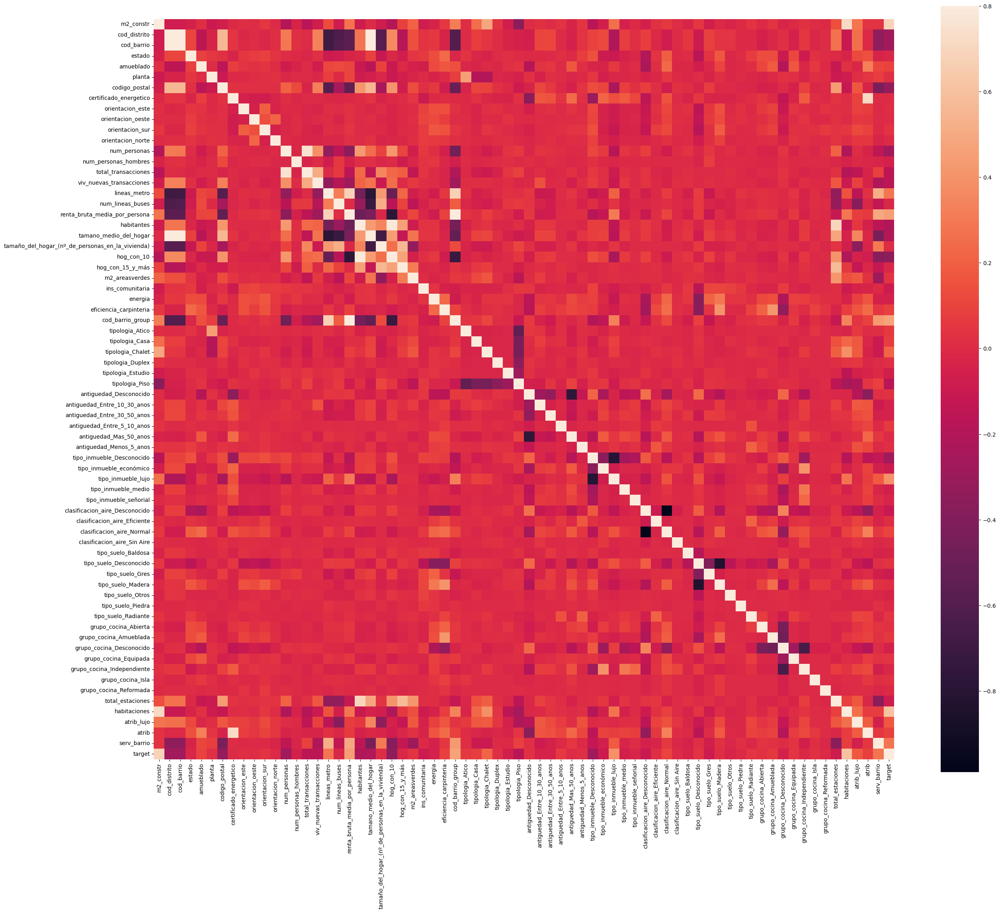

In [294]:
dfcorr =dftrain.corr(numeric_only=True).copy()
f, ax = plt.subplots(figsize=(30, 25))
sns.heatmap(dfcorr, vmax=0.8, square=True);

Se ven algunos cuadrados blancos que significan que hay variables correladas, revisemos las varibles con una correlación fuerte entre ellas, y las variables mas correladas con la varaible target.

#### Pares de variables correladas

In [317]:
# Establecer un umbral para la correlación (80%)
threshold = 0.90

# Identificar pares de variables con correlación
correlations = []
already_seen = set()

for col in dfcorr.columns:
    for row in dfcorr.index:
        if abs(dfcorr.loc[row, col]) > threshold and col != row:
            pair = tuple(sorted((row, col)))  # Crear pares únicos
            if pair not in already_seen:
                correlations.append((row, col, dfcorr.loc[row, col]))
                already_seen.add(pair)  # Marcar par como ya visto

# Imprimir los resultados
print("Pares de variables con correlación mayor al 90%:")
for var1, var2, corr in correlations:
    print(f"{var1} y {var2}: {corr:.2f}")

Pares de variables con correlación mayor al 90%:
cod_barrio y cod_distrito: 0.99
clasificacion_aire_Normal y clasificacion_aire_Desconocido: -0.99


Eliminaremos las variables Cod_distrito y clasificacion_aire_Desconocido

In [296]:
cols_eliminar=["cod_distrito","clasificacion_aire_Desconocido"]
	

# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_final = X_train_final.drop(columns=cols_eliminar)
X_test_final = X_test_final.drop(columns=cols_eliminar)
X_val_final = X_val_final.drop(columns=cols_eliminar)
X_train1_final = X_train1_final.drop(columns=cols_eliminar)
X_test1_final = X_test1_final.drop(columns=cols_eliminar)


# Aplicar la función a cada conjunto de datos con 5 columnas
X_train_scaled = X_train_scaled.drop(columns=cols_eliminar)
X_test_scaled = X_test_scaled.drop(columns=cols_eliminar)
X_val_scaled = X_val_scaled.drop(columns=cols_eliminar)
X_train1_scaled = X_train1_scaled.drop(columns=cols_eliminar)
X_test1_scaled = X_test1_scaled.drop(columns=cols_eliminar)

#### Variables correladas con la variable target

In [297]:
dfcorr[['target']].sort_values(by = 'target',ascending = False).style.background_gradient()

,target
target,1.000000
m2_constr,0.681816
habitaciones,0.608864
cod_barrio_group,0.470188
renta_bruta_media_por_persona,0.449989
tipo_inmueble_lujo,0.392998
lineas_metro,0.285117
serv_barrio,0.278381
tipologia_Chalet,0.216724
atrib_lujo,0.175062


<!-- Puntos a realizar...

*  Normalizar los valores en barrio. Hecho
*  Normalizar los valores en Tipologia.Hecho
*  Rellenar nulos en las columnas  para hacer el Clustering...
* Analizar de manera mas profunda feature engineering . -->

In [298]:
# Forzar la recolección de basura
gc.collect()

359527

# *13. Generación de ficheros .csv*


## *13.2 Exportación train,test,validacion para generación del modelo*

In [299]:
# Ruta relativa del archivo
ruta_guardado_relativa = '../04-modelos/data/'

# Crear el directorio de destino si no existe
directorio_destino = os.path.dirname(ruta_guardado_relativa)
os.makedirs(directorio_destino, exist_ok=True)

# Guardar el DataFrame dfEDA en la ruta relativa especificada
#df_clustering.to_csv(ruta_guardado_relativa,sep=";", index=False)

In [300]:
# #Elimino estas columnas que no nos sirven ni aportan para el entrenamiento del modelo
# cols_eliminar=["barrio","distrito","web"]
	

# # Aplicar la función a cada conjunto de datos con 5 columnas
# #X_train_scaled = X_train_scaled.drop(columns=cols_eliminar)
# X_test_scaled = X_test_scaled.drop(columns=cols_eliminar)
# X_val_scaled = X_val_scaled.drop(columns=cols_eliminar)
# X_train1_scaled = X_train1_scaled.drop(columns=cols_eliminar)
# X_test1_scaled = X_test1_scaled.drop(columns=cols_eliminar)

In [301]:
# X_train_final.reset_index(drop=True, inplace=True)
# X_test_final.reset_index(drop=True, inplace=True)
# X_val_final.reset_index(drop=True, inplace=True)
# X_train1_final.reset_index(drop=True, inplace=True)
# X_test1_final.reset_index(drop=True, inplace=True)
# X_train_scaled.reset_index(drop=True, inplace=True)
# X_test_scaled.reset_index(drop=True, inplace=True)
# X_val_scaled.reset_index(drop=True, inplace=True)
# X_train1_scaled.reset_index(drop=True, inplace=True)
# X_test1_scaled.reset_index(drop=True, inplace=True)

In [302]:

X_train_final['target'] = y_train
X_test_final['target'] = y_test
X_val_final['target'] = y_val
X_train1_final['target'] = y_train1
X_test1_final['target'] = y_test1


X_train_scaled['target'] = y_train_scaled
X_test_scaled['target'] = y_test_scaled
X_val_scaled['target'] = y_val_scaled
X_train1_scaled['target'] = y_train1_scaled
X_test1_scaled['target'] = y_test1_scaled

In [303]:
X_train_final.to_csv(ruta_guardado_relativa+"X_train.csv",sep=";",index=False)
X_test_final.to_csv(ruta_guardado_relativa+"X_test.csv",sep=";",index=False)
X_val_final.to_csv(ruta_guardado_relativa+"X_val.csv",sep=";",index=False)
X_train1_final.to_csv(ruta_guardado_relativa+"X_train_VC.csv",sep=";",index=False)
X_test1_final.to_csv(ruta_guardado_relativa+"X_test_VC.csv",sep=";",index=False)
df_ids.to_csv(ruta_guardado_relativa + "df_ids.csv", sep=";", index=False)


In [304]:
X_train1_scaled.columns

Index(['m2_constr', 'cod_barrio', 'estado', 'amueblado', 'planta',
       'codigo_postal', 'certificado_energetico', 'orientacion_este',
       'orientacion_oeste', 'orientacion_sur', 'orientacion_norte',
       'num_personas', 'num_personas_hombres', 'total_transacciones',
       'viv_nuevas_transacciones', 'lineas_metro', 'num_lineas_buses',
       'renta_bruta_media_por_persona', 'habitantes', 'tamano_medio_del_hogar',
       'tamaño_del_hogar_(nº_de_personas_en_la_vivienda)', 'hog_con_10',
       'hog_con_15_y_más', 'm2_areasverdes', 'ins_comunitaria', 'energia',
       'eficiencia_carpinteria', 'cod_barrio_group', 'tipologia_Atico',
       'tipologia_Casa', 'tipologia_Chalet', 'tipologia_Duplex',
       'tipologia_Estudio', 'tipologia_Piso', 'antiguedad_Desconocido',
       'antiguedad_Entre_10_30_anos', 'antiguedad_Entre_30_50_anos',
       'antiguedad_Entre_5_10_anos', 'antiguedad_Mas_50_anos',
       'antiguedad_Menos_5_anos', 'tipo_inmueble_Desconocido',
       'tipo_inmueble_

In [305]:
X_train_scaled.to_csv(ruta_guardado_relativa+"X_train_scaled.csv",sep=";",index=False)
X_test_scaled.to_csv(ruta_guardado_relativa+"X_test_scaled.csv",sep=";",index=False)
X_val_scaled.to_csv(ruta_guardado_relativa+"X_val_scaled.csv",sep=";",index=False)
X_train1_scaled.to_csv(ruta_guardado_relativa+"X_train_scaledVC.csv",sep=";",index=False)
X_test1_scaled.to_csv(ruta_guardado_relativa+"X_test_scaledVC.csv",sep=";",index=False)


## *13.2 Exportación Clustering*



Se va a generar un dataframe con todos los datos para realizar el analisis del clustering

In [306]:
dftrain1 = X_train1_scaled.copy()
dftrain1['target'] = y_train1_scaled
dftest1 = X_test1_scaled.copy()
dftest1['target'] = y_test1_scaled

In [307]:
dftest1.head()

,m2_constr,cod_barrio,estado,amueblado,planta,codigo_postal,certificado_energetico,orientacion_este,orientacion_oeste,orientacion_sur,orientacion_norte,num_personas,num_personas_hombres,total_transacciones,viv_nuevas_transacciones,lineas_metro,num_lineas_buses,renta_bruta_media_por_persona,habitantes,tamano_medio_del_hogar,tamaño_del_hogar_(nº_de_personas_en_la_vivienda),hog_con_10,hog_con_15_y_más,m2_areasverdes,ins_comunitaria,energia,eficiencia_carpinteria,cod_barrio_group,tipologia_Atico,tipologia_Casa,tipologia_Chalet,tipologia_Duplex,tipologia_Estudio,tipologia_Piso,antiguedad_Desconocido,antiguedad_Entre_10_30_anos,antiguedad_Entre_30_50_anos,antiguedad_Entre_5_10_anos,antiguedad_Mas_50_anos,antiguedad_Menos_5_anos,tipo_inmueble_Desconocido,tipo_inmueble_económico,tipo_inmueble_lujo,tipo_inmueble_medio,tipo_inmueble_señorial,clasificacion_aire_Eficiente,clasificacion_aire_Normal,clasificacion_aire_Sin Aire,tipo_suelo_Baldosa,tipo_suelo_Desconocido,tipo_suelo_Gres,tipo_suelo_Madera,tipo_suelo_Otros,tipo_suelo_Piedra,tipo_suelo_Radiante,grupo_cocina_Abierta,grupo_cocina_Amueblada,grupo_cocina_Desconocido,grupo_cocina_Equipada,grupo_cocina_Independiente,grupo_cocina_Isla,grupo_cocina_No amueblada,grupo_cocina_Reformada,grupo_cocina_Sin reforma,total_estaciones,habitaciones,atrib_lujo,atrib,serv_barrio,url,target
0,0.10,-0.61,-0.50,1.00,0.00,-0.09,0.00,0.00,0.00,0.00,0.00,0.45,0.58,1.27,0.61,0.25,756.00,0.00,-0.10,-1.14,1.12,0.00,0.45,-0.20,0.00,2.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.67,0.00,0.50,0.00,https://www.pisos.com/comprar/piso-universidad_malasana28015-40049467030_109300/,0.43
1,-0.05,-0.40,-0.50,1.00,0.50,-0.43,0.00,0.00,0.00,0.00,0.00,-0.11,-0.14,-0.68,-0.27,-0.50,527.00,0.37,-0.47,0.00,-1.02,-0.80,-1.30,0.71,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.60,0.33,-1.00,0.50,-0.80,https://www.pisosmadrid.com.es/propiedad/4047995-piso-en-venta-en-salamanca-madrid,0.37
2,0.70,1.69,-0.50,0.00,0.00,0.86,0.00,0.00,0.00,0.00,0.00,-0.40,-0.38,1.61,15.03,-0.75,0.00,-0.42,0.26,0.69,-0.95,0.02,-0.65,0.38,0.00,0.00,0.00,-0.33,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.71,1.00,2.00,0.00,0.31,https://www.pisosmadrid.com.es/propiedad/4042092-piso-en-venta-en-las-mercedes-madrid,-0.06
3,-0.64,0.58,0.50,0.00,0.00,0.34,0.00,0.00,0.00,0.00,0.00,1.26,1.26,0.82,0.79,-0.75,0.00,-0.69,1.99,0.77,0.49,2.34,0.90,0.80,0.00,2.00,0.00,-1.00,0.00,0.00,0.00,0.00,0.00,0.00,-1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-1.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.90,-0.33,0.00,-0.50,0.07,https://www.pisos.com/comprar/piso-carabanchel_vista_alegre28025-48368053795_104700/,-0.37
4,2.71,-0.30,2.00,1.00,1.00,-0.69,0.00,0.00,0.00,1.00,0.00,-0.50,-0.56,-0.28,-0.06,0.00,0.00,0.68,0.00,-0.31,0.00,-0.78,-0.45,-0.11,0.00,2.00,0.00,0.33,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.05,1.00,2.00,0.50,1.79,https://www.pisos.com/comprar/piso-recoletos28001-44197454409_108900/,6.28


In [308]:
# Añadir la columna target al DataFrame combinado
# Añadir la columna target al DataFrame combinado
df_clustering = pd.concat([dftrain1, dftest1], axis=0, ignore_index=True)
# Eliminar cualquier índice previo y reiniciar antes de guardar
df_clustering.reset_index(drop=True, inplace=True)

df_clustering=reduce_mem_usage(df_clustering, turn_cat=False, silence=True)

df_clustering.sample(10)




,m2_constr,cod_barrio,estado,amueblado,planta,codigo_postal,certificado_energetico,orientacion_este,orientacion_oeste,orientacion_sur,orientacion_norte,num_personas,num_personas_hombres,total_transacciones,viv_nuevas_transacciones,lineas_metro,num_lineas_buses,renta_bruta_media_por_persona,habitantes,tamano_medio_del_hogar,tamaño_del_hogar_(nº_de_personas_en_la_vivienda),hog_con_10,hog_con_15_y_más,m2_areasverdes,ins_comunitaria,energia,eficiencia_carpinteria,cod_barrio_group,tipologia_Atico,tipologia_Casa,tipologia_Chalet,tipologia_Duplex,tipologia_Estudio,tipologia_Piso,antiguedad_Desconocido,antiguedad_Entre_10_30_anos,antiguedad_Entre_30_50_anos,antiguedad_Entre_5_10_anos,antiguedad_Mas_50_anos,antiguedad_Menos_5_anos,tipo_inmueble_Desconocido,tipo_inmueble_económico,tipo_inmueble_lujo,tipo_inmueble_medio,tipo_inmueble_señorial,clasificacion_aire_Eficiente,clasificacion_aire_Normal,clasificacion_aire_Sin Aire,tipo_suelo_Baldosa,tipo_suelo_Desconocido,tipo_suelo_Gres,tipo_suelo_Madera,tipo_suelo_Otros,tipo_suelo_Piedra,tipo_suelo_Radiante,grupo_cocina_Abierta,grupo_cocina_Amueblada,grupo_cocina_Desconocido,grupo_cocina_Equipada,grupo_cocina_Independiente,grupo_cocina_Isla,grupo_cocina_No amueblada,grupo_cocina_Reformada,grupo_cocina_Sin reforma,total_estaciones,habitaciones,atrib_lujo,atrib,serv_barrio,url,target
7888,-0.41,-0.39,1.50,1.00,3.00,-0.34,0,0,0,0,0,-0.17,-0.24,-0.22,-0.30,-0.50,527,0.37,-0.47,0.00,-1.02,-0.80,-1.30,0.71,0,0,6,0.33,1,0,0,0,0,-1,-1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,-1,0,0,0,0,0,0,-0.60,-0.33,1,0.50,-0.80,https://www.pisos.com/comprar/atico-ibiza28009-35867084168_100500/,0.49
7459,0.04,0.55,0.00,0.00,0.00,0.09,0,0,0,0,0,0.51,0.49,0.17,1.12,-0.75,0,-0.69,1.99,0.77,0.49,2.34,0.90,0.80,0,0,0,-0.67,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.90,0.33,-1,0.50,0.07,https://www.redpiso.es/inmueble/piso-en-venta-en-calle-camino-viejo-de-leganes-opanel-carabanchel-madrid-madrid-RP2412024126391,-0.22
377,-0.42,0.45,-0.50,0.00,0.00,1.29,1,0,0,0,0,0.66,0.69,0.36,1.61,-0.75,0,-0.57,1.63,0.29,0.64,0.95,-0.40,0.42,0,0,0,-1.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1.08,0.00,0,0.00,-0.00,https://www.indomio.es/anuncios/95739289/,-0.41
4174,0.14,0.90,1.00,0.00,0.50,0.56,0,0,0,0,0,-0.86,-0.92,-1.06,-0.18,0.75,0,-0.40,-0.90,0.20,-1.60,-0.59,-1.45,0.00,0,0,0,-0.67,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-0.44,0.67,1,0.00,-0.56,https://www.redpiso.es/inmueble/piso-en-venta-en-calle-hacienda-de-pavones-fontarron-moratalaz-madrid-madrid-RP242023113810,-0.22
2171,-0.54,1.28,-0.50,1.00,0.50,0.17,0,0,0,0,0,-0.40,-0.37,0.03,1.97,-1.25,0,-0.78,0.23,1.23,-1.27,0.85,-0.55,0.17,0,0,0,-1.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-0.08,-1.00,0,0.50,-1.15,https://www.pisosmadrid.com.es/propiedad/4085021-loft-en-venta-en-san-cristobal-madrid,-0.30
2883,0.10,1.04,-0.50,0.00,1.00,0.00,0,0,0,0,0,2.09,2.14,1.95,0.64,-0.25,0,-0.27,1.27,0.20,0.49,0.46,0.35,0.06,0,0,0,-0.67,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.73,0.00,0,-0.50,0.22,https://www.pisos.com/comprar/piso-ciudad_lineal_pueblo_nuevo28017-45870928626_105100/,-0.21
9311,-0.19,1.07,0.50,0.00,2.50,0.43,0,0,0,0,0,-0.34,-0.39,-0.58,-0.30,-0.25,0,-0.27,1.27,0.20,0.49,0.46,0.35,0.06,0,0,0,-0.33,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.73,0.00,0,-0.50,0.22,https://www.pisos.com/comprar/piso-ciudad_lineal_san_pascual-45009815803_100200/,-0.24
9306,-0.80,0.70,-0.50,0.00,-0.50,0.39,1,0,0,0,0,-0.10,-0.10,-0.74,0.33,-1.00,0,-0.79,-0.05,1.17,-1.34,0.83,-0.65,0.02,0,0,0,-1.00,0,0,0,0,0,0,-1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,-0.17,-0.67,0,0.50,0.11,https://www.indomio.es/anuncios/95204827/,-0.43
2345,0.43,-0.18,0.00,0.00,0.50,-0.65,1,0,0,0,0,-0.40,-0.46,-0.53,-0.12,0.25,0,0.91,-0.02,0.17,-0.51,-0.27,0.30,-0.20,0,0,0,0.33,0,0,0,0,0,0,-1,0,0,0,1,0,-1,0,0,0,1,0,0,0,0,0,0,0,

In [310]:
df_clustering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9870 entries, 0 to 9869
Data columns (total 71 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   m2_constr                                         9870 non-null   float32
 1   cod_barrio                                        9870 non-null   float32
 2   estado                                            9870 non-null   float32
 3   amueblado                                         9870 non-null   float32
 4   planta                                            9870 non-null   float32
 5   codigo_postal                                     9870 non-null   float32
 6   certificado_energetico                            9870 non-null   int64  
 7   orientacion_este                                  9870 non-null   int64  
 8   orientacion_oeste                                 9870 non-null   int64  
 9   orientacion_sur    

In [314]:
df_clustering["cod_barrio"].value_counts(dropna=False)

cod_barrio
-0.29    432
-0.61    411
-0.60    339
-0.24    326
-0.30    325
        ... 
0.23       8
1.76       7
1.53       3
0.92       1
0.27       1
Name: count, Length: 131, dtype: int64

In [309]:
# Ruta relativa del archivo
ruta_guardado_relativa = '../03-clustering/data/dfCluster.csv'

# Crear el directorio de destino si no existe
directorio_destino = os.path.dirname(ruta_guardado_relativa)
os.makedirs(directorio_destino, exist_ok=True)


# Guardar el DataFrame dfEDA en la ruta relativa especificada
df_clustering.to_csv(ruta_guardado_relativa,sep=";", index=False)

# *14. Conclusiones*